In [1]:
from scipy.optimize import root_scalar, root
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from decimal import Decimal
from math import isclose
import sys
sys.path.append(r'/home/christian/Documents/Bachelor/numerics/')
from physical_functions_mf import *
cm = 1/2.54  
width = 12*cm 

In [2]:
# physical functions


def AOK(k,Gam,sgam):
    return Gam*(Gam+sgam-k)

def minF(w,k,G,gamma):
    if k>0:
        if k>G+gamma:
            if w!=0:
                return (2*w-np.sqrt(w**2-3/2*AOK(k,G,gamma)))/3/k
            else:
                return -np.sqrt(-G/2*(G+gamma-k)/k**2)*0.9
        else:
            return 0
               
    else:
        return -w*G/2/(G/2*(G+gamma)+w**2)
def maxF(w,k,G,gamma):
    if k>0:
        return (2*w+np.sqrt(w**2-3/2*AOK(k,G,gamma)))/3/k
    else:
        if w==0:
            return 0#(2-np.sqrt(1-3/2*10**8*AOK(k,G,gamma)))/3
        else:
            return (2+np.sqrt(1-3/2/w**2*AOK(k,G,gamma)))/3*w*10**5

# def lamtest(y,w,k,Gam,sgam):
#     A = AOK(k,Gam,sgam)
#     p = Gam**2/w**2+A/w**2/2+3*y**2-4*y+1
#     q = Gam**2/w**2*(A/w**2/2+3*y**2-4*y+1)+Gam**2/k**2*(2*y-k/w)*(y-k/w)
#     return p, p**2-4*q
    # return (-p+np.sqrt(p**2-4*q))/2, p,p**2-4*q

def lamtest(y,w,k,Gam,sgam):
    A = AOK(k,Gam,sgam)
    p = Gam**2+A/2+k**2*y**2-y*w*k
    q = Gam**2*(A/2+k**2*y**2-y*w*k)+Gam**2*(2*y*k-w)*(y*k-w)
    return p, p**2-4*q, q


def BK(W,K):
    return K/2/W**2

def yKnax(W,K):
    return (2+np.sqrt(1-3/2*(1-K)/W**2))/3
def yKnix(W,K):
    return (2-np.sqrt(1-3/2*(1-K)/W**2))/3
def FKK(W,K):
    return -BK(W,K)+yKnax(W,K)**3*2-2*yKnax(W,K)**2

def Foriginal_vec(p,w,k,delta,Gamma,gamma):
    x=p[0]
    y= p[1]
    eqx = -Gamma*delta*y-AOK(k,Gamma,gamma)*x-2*k**2*x*(x**2+y**2)+2*w*k*x*y
    eqy = Gamma*delta*x-w*Gamma-AOK(k,Gamma,gamma)*y-2*k**2*y*(x**2+y**2)+2*k*w*(x**2+2*y**2)-2*w**2*y
    return np.array([eqx,eqy])
def Foriginal(y,w,k,Gamma,gamma):
    return -w*Gamma/2-Gamma/2*(Gamma+gamma-k)*y-k**2*y**3+2*w*k*y**2-w**2*y
# def y1ofx(x,w,k,delta,Gamma,gamma):
#     if x==0:
#         return 0
#     return 1/(2*k**2*x)*(k*w*x-Gamma*delta/2+np.sqrt((k*w*x-Gamma*delta/2)**2-4*x*k**2*(k**2*x**3+AOK(k,Gamma,gamma)/2*x)))

def y1ofx(x,w,k,delta,Gamma,gamma):
    if x==0 and delta==0:
        return (2*w**2+np.sqrt(4*w**4+8*k*Gamma*w**2))/(4*k*w)
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return 1/(Gamma*delta+2*k*w*x)*(w**2*x+np.sqrt(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)))

def num(x,w,k,delta,Gamma,gamma):
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return (w**2*x+(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)).sqrt())

def denom(x,w,k,delta,Gamma,gamma):
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return Gamma*delta+2*k*w*x

def insq(x,w,k,delta,Gamma,gamma):
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return (w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2))
    # return (k*w*x-Gamma*delta/2)**2-4*x*k**2*(k**2*x**3+AOK(k,Gamma,gamma)/2*x)

def insq_preci(x,w,k,delta,Gamma,gamma):
    x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return (w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2))

def y2ofx(x,w,k,delta,Gamma,gamma):
    if x==0 and delta==0:
        return (2*w**2-np.sqrt(4*w**4+8*k*Gamma*w**2))/(4*k*w)
    # x,w, k, delta, Gamma , prec2 = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(2)
    prec2=2
    return 1/(Gamma*delta+prec2*k*w*x)*(w**prec2*x-np.sqrt(w**4*x**prec2-(prec2*k*w*x+Gamma*delta)*(prec2*k*w*x**3-w*Gamma*x+Gamma*delta*x**prec2)))
    # if x==0:
    #     return w/k
    # return 1/(2*k**2*x)*(k*w*x-Gamma*delta/2-np.sqrt((k*w*x-Gamma*delta/2)**2-4*x*k**2*(k**2*x**3+AOK(k,Gamma,gamma)/2*x)))
y1ofx_vec = np.vectorize(y1ofx)
y2ofx_vec = np.vectorize(y2ofx)
def Fx(x,w,k,delta,Gamma,gamma,s):
    if s==1:
        y = y1ofx(x,w,k,delta,Gamma,gamma)
    if s==2:
        y = y2ofx(x,w,k,delta,Gamma,gamma)
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return Gamma*delta*x-w*Gamma-AOK(k,Gamma,gamma)*y-2*k**2*y*(x**2+y**2)+2*k*w*(x**2+2*y**2)-2*w**2*y

def Fx2(x,w,k,delta,Gamma,gamma,s):
    if s==1:
        y = y1ofx(x,w,k,delta,Gamma,gamma)
    if s==2:
        y = y2ofx(x,w,k,delta,Gamma,gamma)
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return -Gamma*delta*y-AOK(k,Gamma,gamma)*x-2*k**2*x*(x**2+y**2)+2*k*w*x*y
def Fx_vec(x,w,k,delta,Gamma,gamma,s):
    if s==1:
        y = y1ofx_vec(x,w,k,delta,Gamma,gamma)
    if s==2:
        y = y2ofx_vec(x,w,k,delta,Gamma,gamma)
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return Gamma*delta*x-w*Gamma-AOK(k,Gamma,gamma)*y-2*k**2*y*(x**2+y**2)+2*k*w*(x**2+2*y**2)-2*w**2*y

def Fx2_vec(x,w,k,delta,Gamma,gamma,s):
    if s==1:
        y = y1ofx_vec(x,w,k,delta,Gamma,gamma)
    if s==2:
        y = y2ofx_vec(x,w,k,delta,Gamma,gamma)
    # x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return -Gamma*delta*y-AOK(k,Gamma,gamma)*x-2*k**2*x*(x**2+y**2)+2*k*w*x*y

def eq(x,w,k,delta,Gamma,gamma,s):
    if s==1:
        y = y1ofx(x,w,k,delta,Gamma,gamma)
    if s==2:
        y = y2ofx(x,w,k,delta,Gamma,gamma)
    x,w, k, delta, Gamma , gamma = Decimal(x), Decimal(w), Decimal(k), Decimal(delta), Decimal(Gamma), Decimal(gamma)
    return -Gamma*delta*(y**2+x**2)+w*Gamma*x-2*k*w*x*(x**2+y**2)+2*w**2*x*y

def m_z(x,y,omega,kappa,Gamma):
    return 1/2 -(kappa*(y**2+x**2)-omega*y)/Gamma

def set_point1(p,w,k,delta,Gamma,gamma):
    n = 0
    while True:
        try:
            p+= n* 5/10**7
            if np.isnan(Fx(p,w,k,delta,Gamma,gamma,1)):
                n+=1
                continue
            else:
                n+=1
                # print(Fx(p,w,k,delta,Gamma,gamma,1))
                break
        except RuntimeWarning:
            n+=1
            pass
    return p

def set_point2(p,w,k,delta,Gamma,gamma):
    n = 0
    while True:
        try:
            p-= n* 5/10**7
            if np.isnan(Fx(p,w,k,delta,Gamma,gamma,1)):
                n+=1
                continue
            else:
                # print(Fx(p,w,k,delta,Gamma,gamma,1))
                n+=1
                break
        except RuntimeWarning:
            n+=1
            pass
    return p
            

def set_xgird(w,k,delta,Gamma,gamma,points=False):
    grid1 = np.linspace(-0.5-1/10**5,0.5+1/10**5,40)
    pos = 0
    p1= None
    p2 = None
    if max(insq(grid1,w,k,delta,Gamma,gamma))<0:# or min(insq(grid1,w,k,delta,Gamma,gamma))>0:
        # print('no solution')
        return np.array([-2]), None
    gridpoints = []
    newgrid = np.array([0])
    if insq(grid1[0],w,k,delta,Gamma,gamma)>=0:
        if insq(grid1[0]+1/10**5,w,k,delta,Gamma,gamma)>=0:
            p1 = set_point1(grid1[0],w,k,delta,Gamma,gamma)
            gridpoints.append(p1)
    for i in range(len(grid1)-1):
        f1 = insq(grid1[i],w,k,delta,Gamma,gamma)
        f2 = insq(grid1[i+1],w,k,delta,Gamma,gamma)
        if f1*f2<=0:
            r = root_scalar(insq,args=(w,k,delta,Gamma,gamma),method='bisect',bracket=(grid1[i],grid1[i+1]))
            # print(r.root)
            if p1!=None:
                p2 = set_point2(r.root,w,k,delta,Gamma,gamma)
                newgrid = np.concatenate((newgrid,np.linspace(p1,p2,30)))
                # print(np.linspace(p1,p2,30))
                gridpoints.append(p2)
                p1=None
            else:
                p1 = set_point1(r.root,w,k,delta,Gamma,gamma)
                gridpoints.append(p1)
    if p1!=None:
        p2 = set_point2(grid1[-1],w,k,delta,Gamma,gamma)
        newgrid = np.concatenate((newgrid,np.linspace(p1,p2,30)))
        gridpoints.append(p2)
    
    # print(len(gridpoints),gridpoints)
    if len(gridpoints)==2:
        # print(gridpoints[0],grid1[0])
        if gridpoints[0]==grid1[0]:
            # print(gridpoints[-1],grid1[-1])
            if gridpoints[-1]==grid1[-1]:
                if points:
                    return np.linspace(-0.5,0.5,80), np.array(gridpoints)
                return np.linspace(-0.5,0.5,80)
    if points==True:
        return newgrid[1:], np.array(gridpoints)
    return newgrid[1:]

def maxx(w,k,d,Gamma):
    return (Gamma*d)**2/(Gamma*d*w**2-k*w**2*Gamma)

from sympy.abc import gamma, G, kappa, omega, delta, x, y, z, t
from sympy.matrices import Matrix
from sympy import lambdify, simplify, expand
import numpy as np
m = Matrix([x,y,z])
glx = -delta/2*m[1]-(gamma+G)/2*m[0]+kappa*m[0]*m[2]
gly = delta/2*m[0]-omega*m[2]-(gamma+G)/2*m[1]+kappa*m[1]*m[2]
glz = omega*m[1]-kappa*(m[0]**2+m[1]**2)+G/2-G*m[2]
gl = Matrix([glx,gly,glz])
jac_gl = gl.jacobian([m[0],m[1],m[2]])
gl_np = lambdify([t,m,omega,kappa,delta,G,gamma],gl)
jac_gl_np = lambdify([t,m,omega,kappa,delta,G,gamma],jac_gl)
# gl_np(0,[0,2,1],1,1/2,0.2,1), jac_gl_np(0,[0,2,1],1,1/2,0.2,1)
from scipy.integrate import solve_ivp
# mz= 1/2 - 1/G*(kappa*(m[0]**2+m[1]**2)-omega*m[1])
# jac_gl = simplify(expand(jac_gl.subs(z,mz)))
# jac_gl
def jac2(t,m,w,k,d,Gamma,gamma):
    row1 = [-Gamma/2-gamma/2+k*m[2],-d/2,k*m[0]]
    row2 = [d/2,-Gamma/2-gamma/2+k*m[2],k*m[1]-w]
    row3 = [-2*k*m[0],-2*k*m[1]+w,-Gamma]
    return np.array([row1,row2,row3])
def gl2(t,m,omega,kappa,delta,G,gamma):
    row1 = -delta/2*m[1]-(gamma+G)/2*m[0]+kappa*m[0]*m[2]
    row2 = delta/2*m[0]-omega*m[2]-(gamma+G)/2*m[1]+kappa*m[1]*m[2]
    row3 = omega*m[1]-kappa*(m[0]**2+m[1]**2)+G/2-G*m[2]
    return np.array([row1,row2,row3])
def check_spec(w,k,delta,Gamma,gamma):
    if k==0:
        return -1
    return Gamma*delta*np.sqrt(-AOK(k,Gamma,gamma)/2/k**2)-w*Gamma-w/k*AOK(k,Gamma,gamma)
jac_gl

Matrix([
[-G/2 - gamma/2 + kappa*z,                 -delta/2,         kappa*x],
[                 delta/2, -G/2 - gamma/2 + kappa*z, kappa*y - omega],
[              -2*kappa*x,       -2*kappa*y + omega,              -G]])

In [1]:
import time
for i in range(5):
    print(i)
    time.sleep(5)

0
1
2
3
4


In [3]:
#Plotting Class



class TickProperties():
    
    major_xtick_step = 5,
    minor_xtick_step = 1
    major_ytick_step = 5
    minor_ytick_step = 1
    STRIP_OF_ZEROS_X = False
    STRIP_OF_ZEROS_Y = False

    def __init__(self,\
    xtick_step_major = 5,\
    xtick_step_minor = 1,\
    ytick_step_major = 5,\
    ytick_step_minor = 1,\
    SZX = False,\
    SZY = False):
        self.major_xtick_step = xtick_step_major
        self.minor_xtick_step = xtick_step_minor
        self.major_ytick_step = ytick_step_major
        self.minor_ytick_step = ytick_step_minor
        self.STRIP_OF_ZEROS_X = SZX
        self.STRIP_OF_ZEROS_Y = SZY

class Format():
    numb_xticks = None
    numb_yticks = None
    custom_func_x = None
    custom_func_y = None
    x_scale = None
    y_scale = None
    x_precion = "{:.2f}"
    y_precion = "{:.2f}"
    def __init__(self,numb_xticks=None,numb_yticks=None,custom_funx=None,custom_funy=None,xscale=None,yscale=None,xprec="{:.2f}",yprec="{:.2f}"):
        self.numb_xticks =numb_xticks
        self.numb_yticks = numb_yticks
        self.custom_func_x = custom_funx
        self.custom_func_y = custom_funy
        self.x_precion=xprec
        self.y_precion = yprec
        self.x_scale = xscale
        self.y_scale = yscale
    def formatx0(self,x,pos):
        try:
                # print(x,pos)#,"{:.2f}".format(w[int(x)]))
            # print(x,pos,self.numb_xticks)
            index = int((pos-1)*self.x_scale.shape[0]//self.numb_xticks)
            # print(index)
            # print(self.x_precion.format(self.x_scale[index]))
            return self.x_precion.format(self.x_scale[index])
        except:
            return self.x_precion.format(self.x_scale[-1])
    def formatx1(self,x,pos):
        try:
                # print(x,pos)#,"{:.2f}".format(w[int(x)]))
            # print(pos)
            index = int((pos)*self.x_scale.shape[0]//self.numb_xticks)
            # print(index)
            # print()
            return self.x_precion.format(self.x_scale[index])
        except:
            return self.x_precion.format(self.x_scale[-1])
    
    def formaty1(self,x,pos):
        try:
                # print(x,pos)#,"{:.2f}".format(w[int(x)]))

            index = int((pos-1)*self.y_scale.shape[0]//self.numb_yticks)
            # print(index)
            # print()
            return self.y_precion.format(self.y_scale[index])
        except:
            return self.y_precion.format(self.y_scale[-1])
        
    def formaty(self,x,pos):
        try:
            return self.y_precion.format(self.y_scale[int(x)])
        except:
            return ""

class Setup_Fig():
    DEFAULT_HEAT_EXTEND = (-0.5,39.5,29.5,-0.5)
    xlim = None
    ylim = None
    tickprop = TickProperties()
    formatter = Format()
    cm = 1/2.54 
    fig_width = 12*cm
    fig_height = 4.8/6.4*12*cm
    name_of_plot = None
    def __init__(self,name_of_plot = "sign_of_ev1.pdf",xlim=None,ylim=None,tickp=TickProperties(),formater=Format()):
        self.xlim=xlim
        self.ylim = ylim   
        self.tickprop =tickp       
        self.formatter = formater
        self.name_of_plot = name_of_plot

    
    plt.rcParams["lines.markersize"]=0.7
    plt.rcParams["axes.unicode_minus"]=True
    plt.rcParams["font.size"]=10
    plt.rcParams["text.usetex"]=True
    plt.rcParams["font.serif"]="Computer Modern Serif"
# ax.scatter(A,root,color='0')
    



    def return_fig(self,shape=(1,1),dots_per_inch=400,xax_share=False,yax_share=False,joined=False,set_ticks=True,heightratio=None):
        if heightratio:
            fig, ax = plt.subplots(*shape,figsize=(self.fig_width,self.fig_height),dpi=dots_per_inch,sharex=xax_share,sharey=yax_share,height_ratios=heightratio)
        else:
            fig, ax = plt.subplots(*shape,figsize=(self.fig_width,self.fig_height),dpi=dots_per_inch,sharex=xax_share,sharey=yax_share)
        trash, xw, yw, trash=self.DEFAULT_HEAT_EXTEND# im.get_extent()
        self.formatter.numb_xticks = xw//self.tickprop.major_xtick_step
        self.formatter.numb_yticks = yw//self.tickprop.major_ytick_step
        
        for i in range(shape[0]):
            for j in range(shape[1]):
                pos= 'outer_left'
                if shape[0]==1:
                    if shape[1]==1:
                        current_ax = ax
                    else:
                        current_ax = ax[j]
                else:
                    if shape[1]==1:
                        current_ax = ax[i]
                    else:
                        current_ax = ax[i,j]
                        if j==0:
                           pos= 'outer_left'
                        elif j<shape[1]-1:
                            pos = 'middle'
                        elif j==shape[1]-1:
                            pos = 'outer_right'
                        


        # axlimits have to be adapted
                try:
                    current_ax.set_xlim(*self.xlim)
                except:
                    pass
                try:
                    current_ax.set_ylim(*self.ylim)
                except:
                    pass    
            
                if set_ticks:
                    if self.tickprop.STRIP_OF_ZEROS_X:
                        current_ax.xaxis.set_major_formatter(ticker.FuncFormatter(self.formatter.formatx0))
                    current_ax.yaxis.set_major_locator(ticker.MultipleLocator(self.tickprop.major_ytick_step))
                    current_ax.yaxis.set_minor_locator(ticker.MultipleLocator(self.tickprop.minor_ytick_step))
                    current_ax.xaxis.set_major_locator(ticker.MultipleLocator(self.tickprop.major_xtick_step))
                    current_ax.xaxis.set_minor_locator(ticker.MultipleLocator(self.tickprop.minor_xtick_step))

                    if self.tickprop.STRIP_OF_ZEROS_Y:
                        current_ax.yaxis.set_major_formatter(ticker.FuncFormatter(self.formatter.formaty1))  

                if joined:
                    if i<shape[0]-1:
                        current_ax.tick_params(axis='x',direction='in',which='both',bottom=True,top=True,labelbottom=False)
                    else:
                        current_ax.tick_params(axis='x',direction='in',which='both',bottom=True,top=True,labelbottom=True)
                        
                    if pos=='outer_left':
                        current_ax.tick_params(axis='y',direction='in',which='both',left=True,right=True,labelleft=True)
                    elif pos=='middle':
                        current_ax.tick_params(axis='y',direction='in',which='both',left=True,right=True,labelleft=False)
                    elif pos=='outer_right':
                        current_ax.tick_params(axis='y',direction='in',which='both',left=True,right=True,labelright=True)
                        # current_ax.set_xlabel(r'$\Gamma \tilde{A}$')
                        # current_ax.set_ylabel(r'$\tilde{y}$',rotation=0)
                else:
                    current_ax.tick_params(axis='x',direction='in',which='both',bottom=True,top=True,labelbottom=True)
                    
                    current_ax.tick_params(axis='y',direction='in',which='both',left=True,right=True,labelleft=True)   


                current_ax.tick_params(axis='both',which='major',length=4.5)
                plt.setp(current_ax.yaxis.get_majorticklabels(),va='center')
        
        return fig, ax





(91, 91, 91, 30)
3.0
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121
-30.0 0 3.0
-31
1.0
0.0 1 3.0
0
-3.0
30.0 2 3.0
30
-1.0
60.0 3 3.0
60
1.0
90.0 4 3.0
91
120.0 5 3.0
121


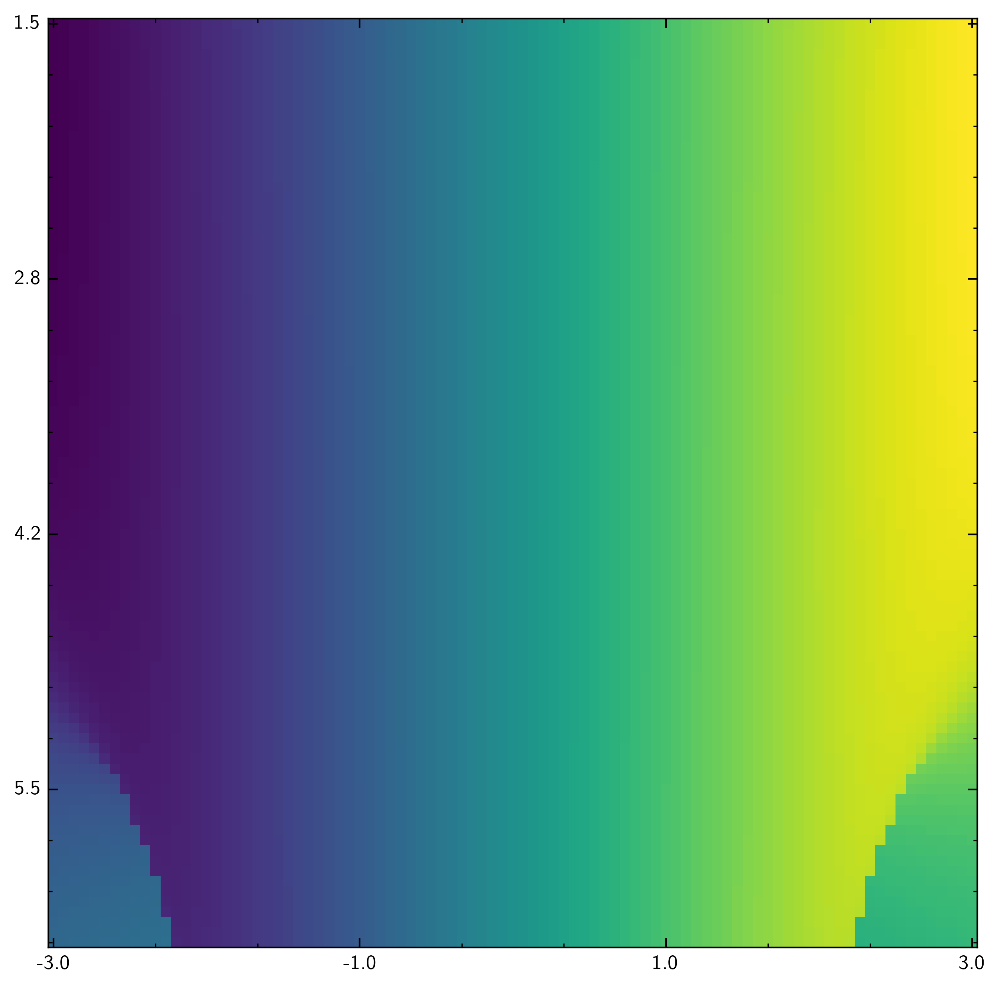

In [76]:
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=30,\
                        xtick_step_minor=10,\
                            ytick_step_major=25,\
                                ytick_step_minor=5)
print(xsol.shape)
trash, xw, yw, trash=im.get_extent()#(-0.5,39.5,29.5,-0.5)#
numb_xticks = xw//tickp.major_xtick_step
print(numb_xticks)
numb_yticks = yw//tickp.major_ytick_step+1
tickformat1 = Format(xscale=d,yscale=w,xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)

setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp,formater=tickformat1)
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
setup.DEFAULT_HEAT_EXTEND =  im.get_extent()#(-0.5,64.5,39.5,-0.5)#
fig, ax = setup.return_fig((1,1))
im = plt.imshow(xsol[:,42,:,0])
plt.show()




In [4]:
# add_solution functions
Gam = 1
sgam = 0.2
def add_sol1(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s,comment=False):    
    if s==1:
        yofx = y1ofx
    else:
        yofx= y2ofx
    new_sol =1
    for sol in xsol[ik,iw,id,:]:
        if isclose(sol,r.root,abs_tol=1/10**6):
            new_sol = 0
            if comment:
                print('different sol: ',sol-r.root)
            break
    for sol in xsol_list:
        if isclose(sol,r.root,abs_tol=1/10**6):
            new_sol = 0
            if comment:
                print('different sol: ',sol-r.root)
            break
    if new_sol:
        y =yofx(r.root,wval,kval,dval,Gam,sgam)
        if  isclose(r.root,0,abs_tol=1/10**9):
            if comment:
                print('root at 0: ',r.root)
            pass
        elif isclose(y,0,abs_tol=1/10**9):
            if (kval>Gam+sgam and isclose(check_spec(wval,kval,dval,Gam,sgam),0,abs_tol=1/10**9)):
                if isclose(Fx2(r.root,wval,kval,dval,Gam,sgam,s),0,abs_tol=1/10**9):
                    if comment:
                        print('closeness to root: ',Fx(r.root,wval,kval,dval,Gam,sgam,s))
                    xsol_list.append(r.root)
                    ysol_list.append(y)
                    variant_list.append(s)
                    sol_numb+=1
        else:
            if isclose(Fx2(r.root,wval,kval,dval,Gam,sgam,s),0,abs_tol=1/10**9):
                if comment:
                    print('closeness to root: ',Fx(r.root,wval,kval,dval,Gam,sgam,s))
                xsol_list.append(r.root)
                ysol_list.append(y)
                variant_list.append(s)
                sol_numb+=1
    return xsol_list, ysol_list, variant_list, sol_numb

def add_sol2(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s,comment=False):
    if s==1:
        yofx = y1ofx
    else:
        yofx= y2ofx
    new_sol=1
    for sol in xsol[ik,iw,id,:]:
        if isclose(sol,r.root,abs_tol=1/10**6):
            new_sol = 0
            if comment:
                print('different sol: ',sol-r.root)
            break
    for sol in xsol_list:
        if isclose(sol,r.root,abs_tol=1/10**6):
            new_sol = 0
            if comment:
                print('different sol: ',sol-r.root)
            break
    if new_sol:
        y = yofx(r.root,wval,kval,dval,Gam,sgam)
        if  isclose(r.root,0,abs_tol=1/10**9):
            if comment:
                print('root at 0: ',r.root)
            pass
        elif isclose(y,0,abs_tol=1/10**9):
            if (kval>Gam+sgam and isclose(check_spec(wval,kval,dval,Gam,sgam),0,abs_tol=1/10**9)):
                if isclose(Fx(r.root,wval,kval,dval,Gam,sgam,s),0,abs_tol=1/10**9):
                    if comment:
                        print('closeness to root: ',Fx(r.root,wval,kval,dval,Gam,sgam,s))
                    xsol_list.append(r.root)
                    ysol_list.append(y)
                    variant_list.append(s)
                    sol_numb+=1
        else:
            if isclose(Fx(r.root,wval,kval,dval,Gam,sgam,s),0,abs_tol=1/10**9):
                if comment:
                    print('closeness to root: ',Fx(r.root,wval,kval,dval,Gam,sgam,s))
                xsol_list.append(r.root)
                ysol_list.append(y)
                variant_list.append(s)
                sol_numb+=1
    return xsol_list, ysol_list, variant_list, sol_numb

1.0 1.0 -5.0


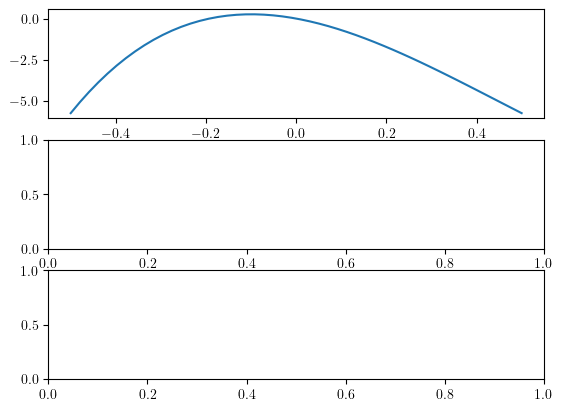

1.0 1.0 -1.6666666666666665


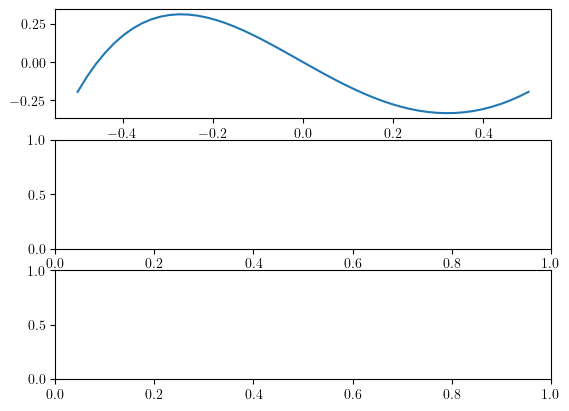

1.0 1.0 1.666666666666667


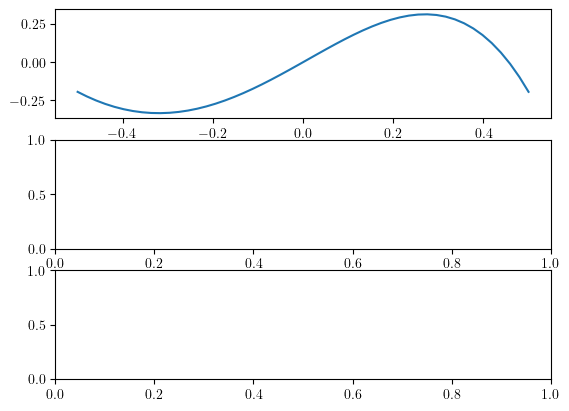

1.0 1.0 5.0


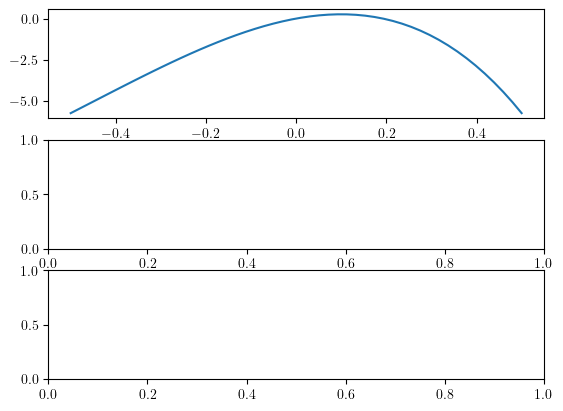

1.0 2.666666666666667 -5.0


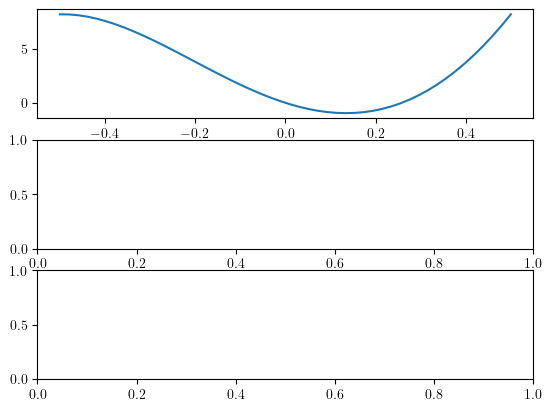

1.0 2.666666666666667 -1.6666666666666665


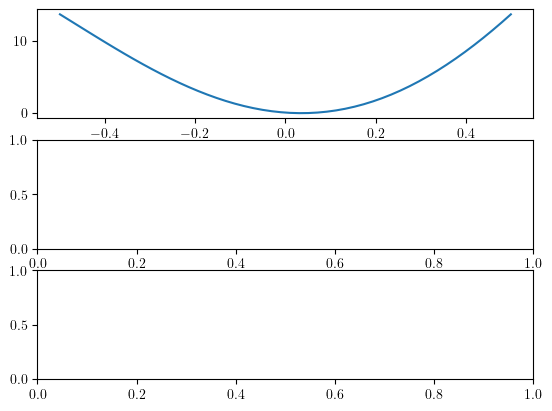

1.0 2.666666666666667 1.666666666666667


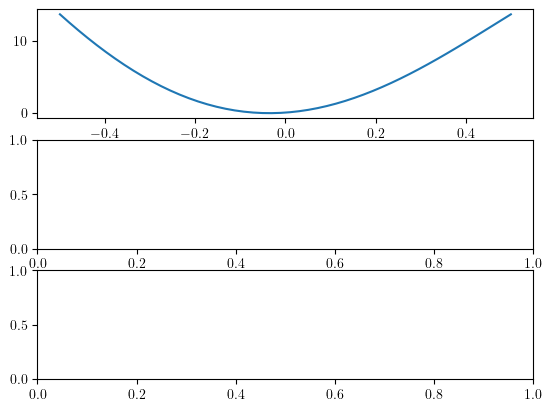

1.0 2.666666666666667 5.0


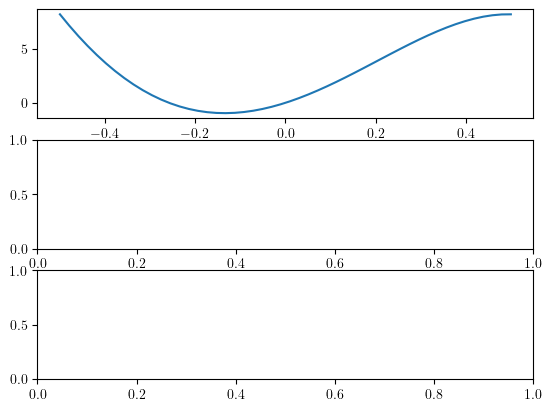

1.0 4.333333333333334 -5.0


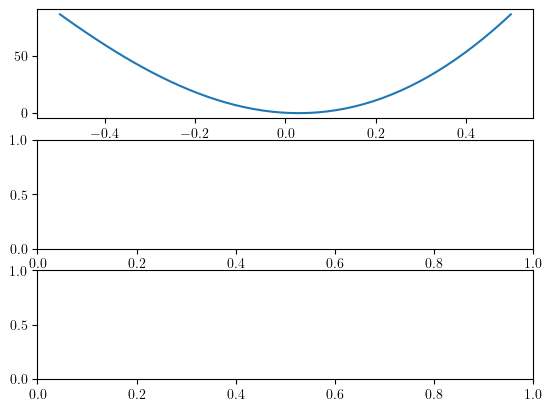

1.0 4.333333333333334 -1.6666666666666665


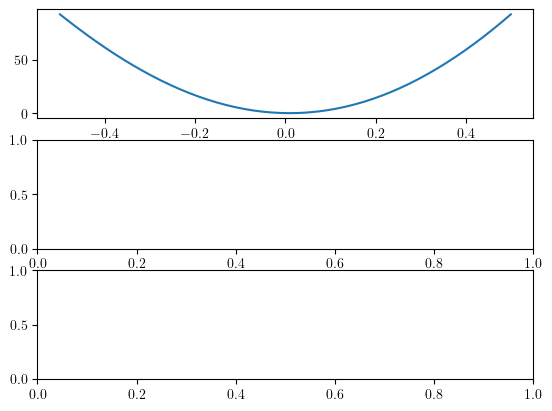

1.0 4.333333333333334 1.666666666666667


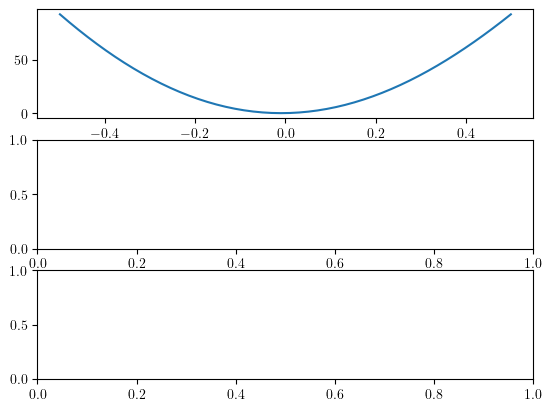

1.0 4.333333333333334 5.0


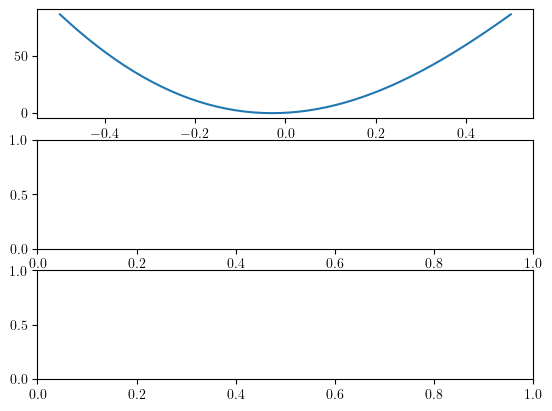

1.0 6.0 -5.0


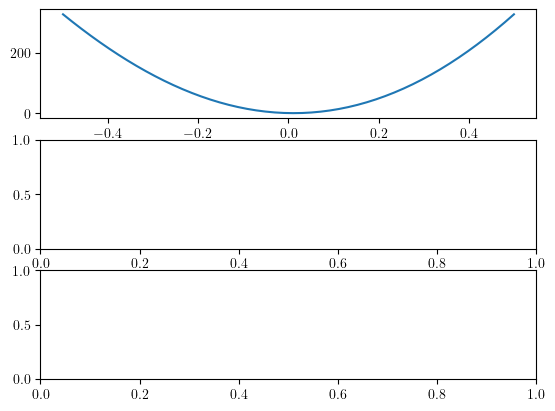

1.0 6.0 -1.6666666666666665


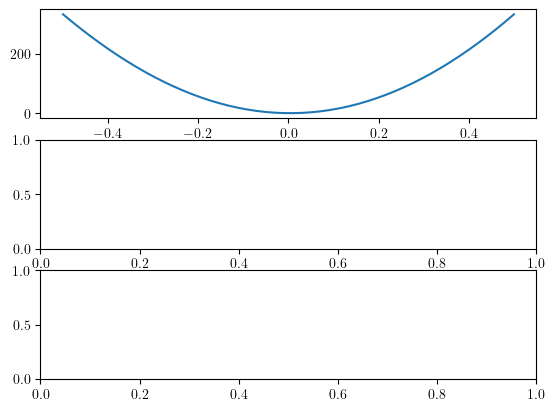

1.0 6.0 1.666666666666667


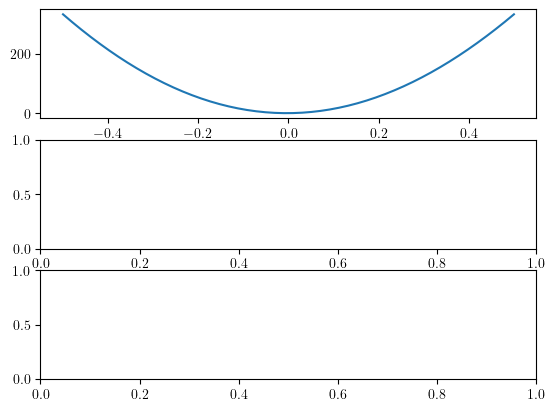

1.0 6.0 5.0


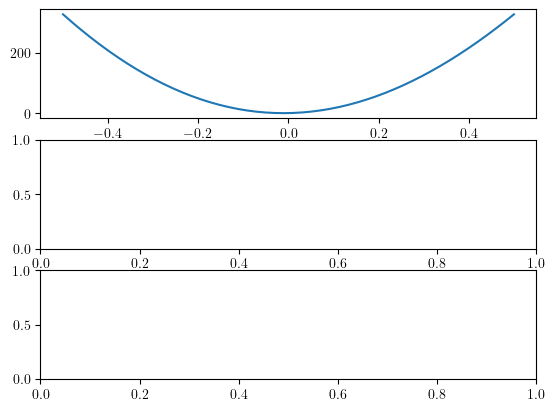

4.0 1.0 -5.0


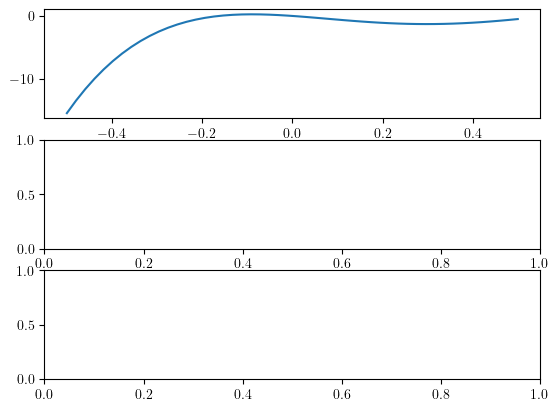

4.0 1.0 -1.6666666666666665


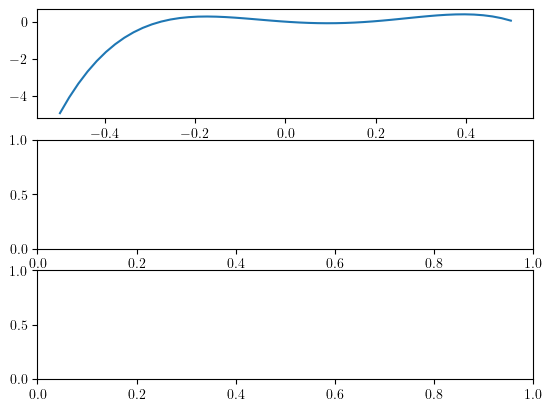

4.0 1.0 1.666666666666667


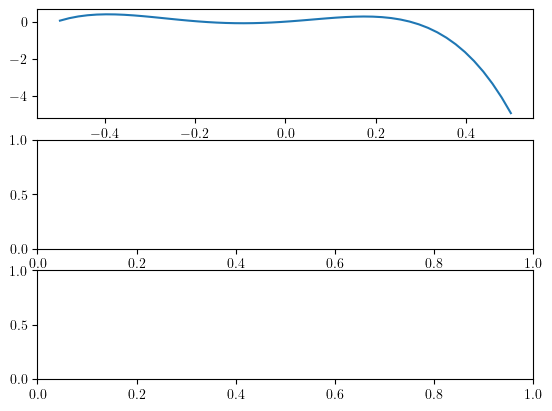

4.0 1.0 5.0


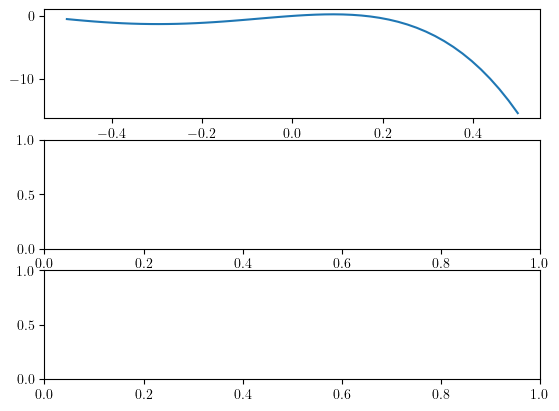

4.0 2.666666666666667 -5.0


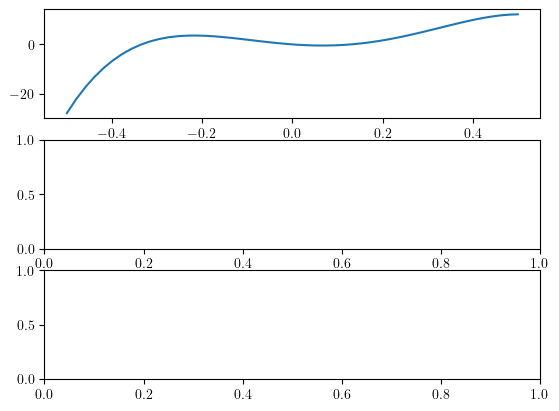

4.0 2.666666666666667 -1.6666666666666665


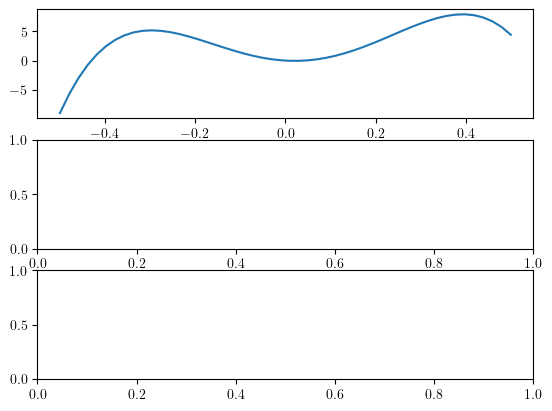

4.0 2.666666666666667 1.666666666666667


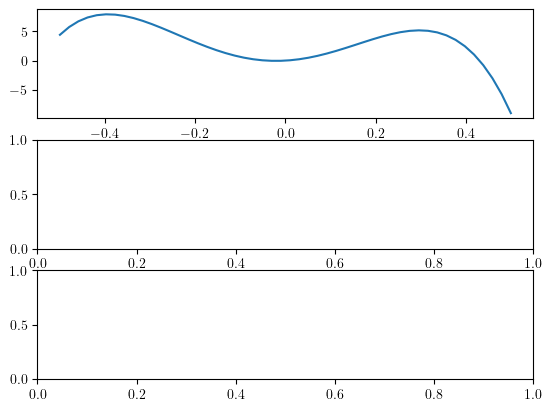

4.0 2.666666666666667 5.0


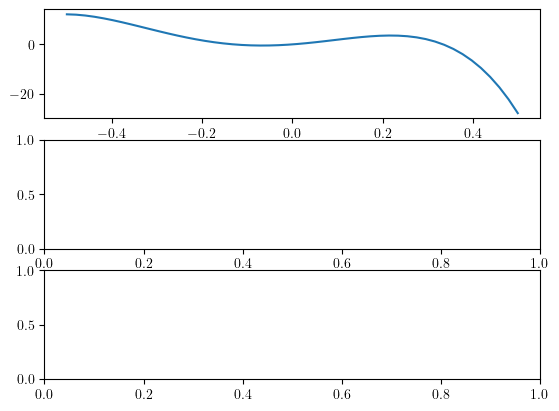

4.0 4.333333333333334 -5.0


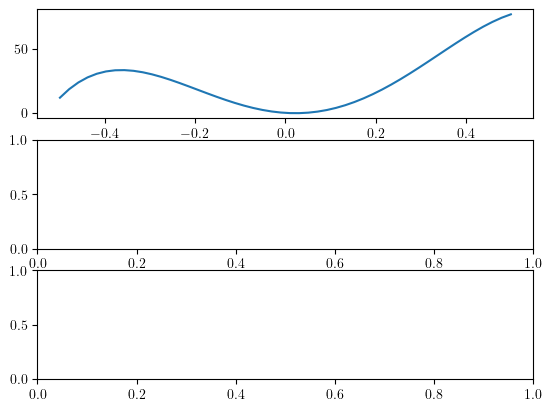

4.0 4.333333333333334 -1.6666666666666665


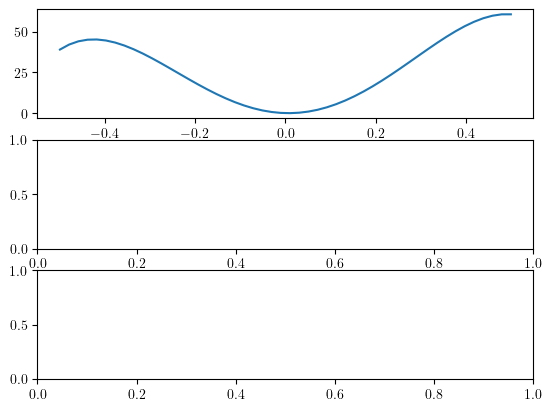

4.0 4.333333333333334 1.666666666666667


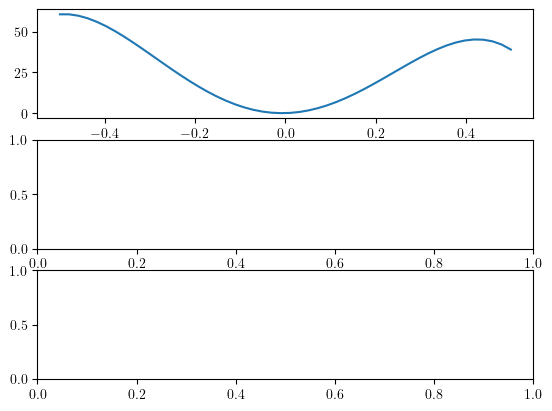

4.0 4.333333333333334 5.0


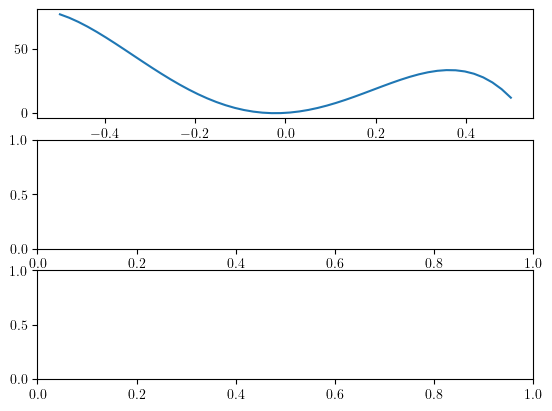

4.0 6.0 -5.0


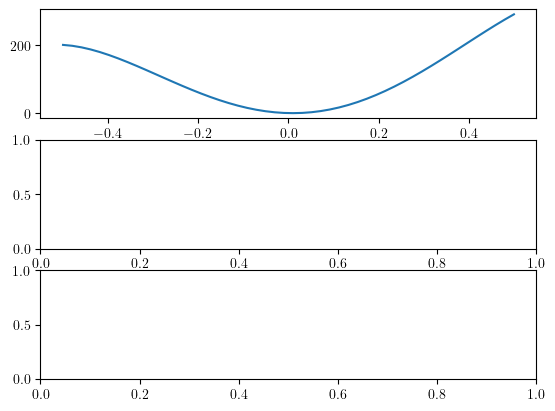

4.0 6.0 -1.6666666666666665


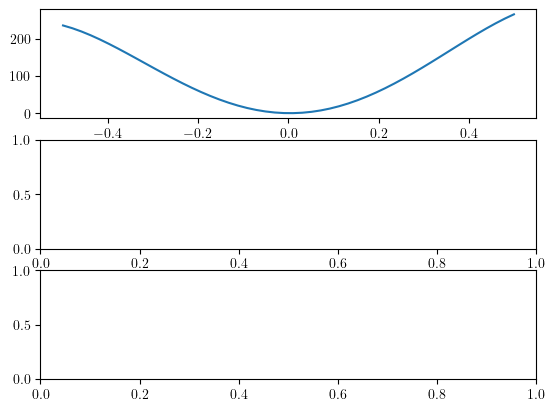

4.0 6.0 1.666666666666667


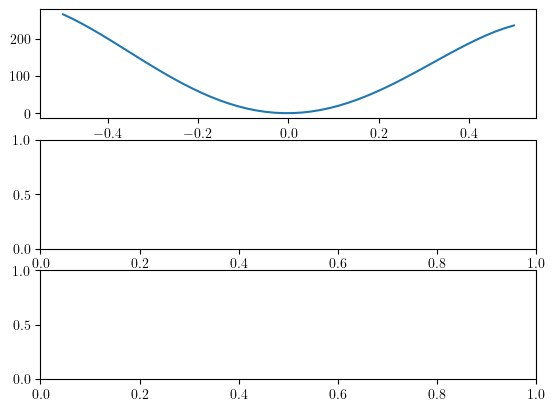

4.0 6.0 5.0


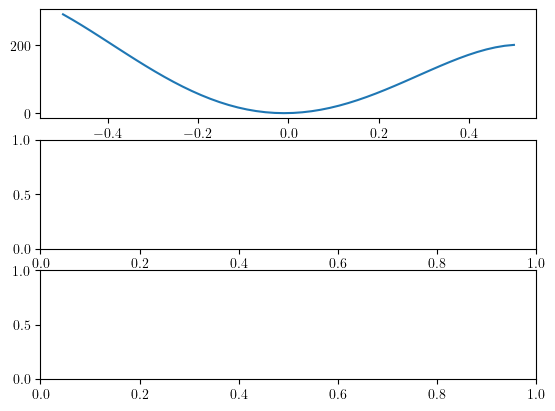

7.0 1.0 -5.0


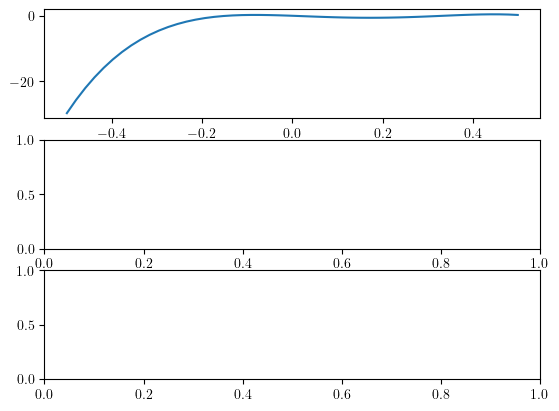

7.0 1.0 -1.6666666666666665


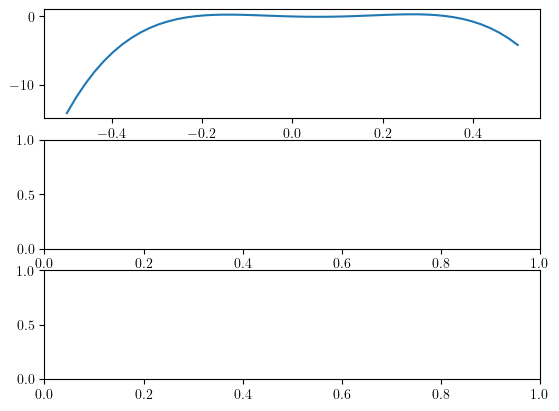

7.0 1.0 1.666666666666667


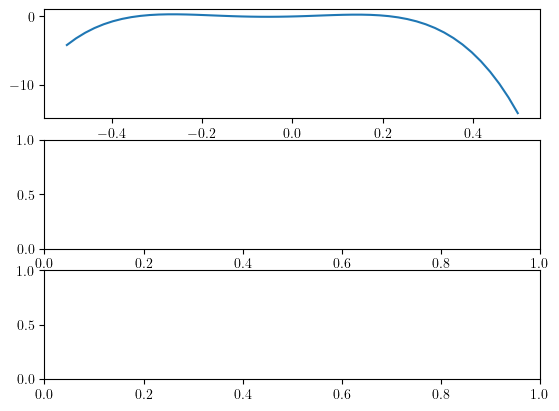

7.0 1.0 5.0


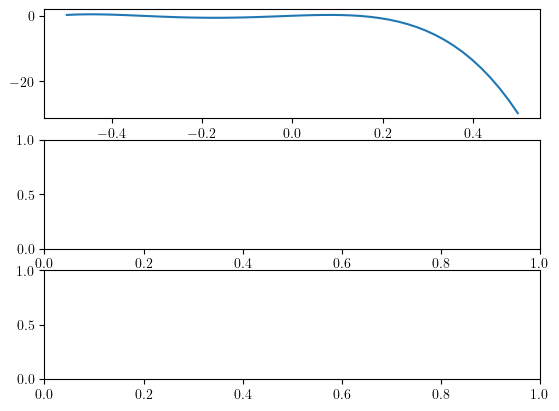

7.0 2.666666666666667 -5.0


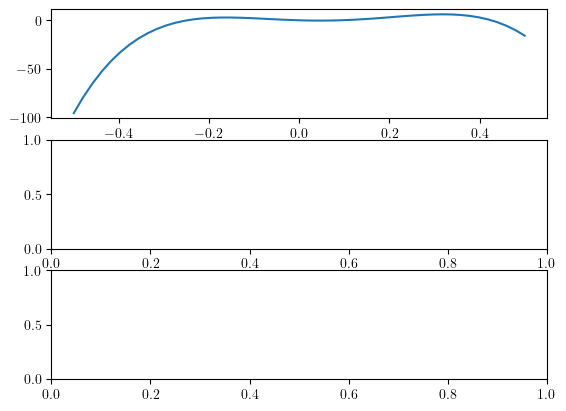

7.0 2.666666666666667 -1.6666666666666665


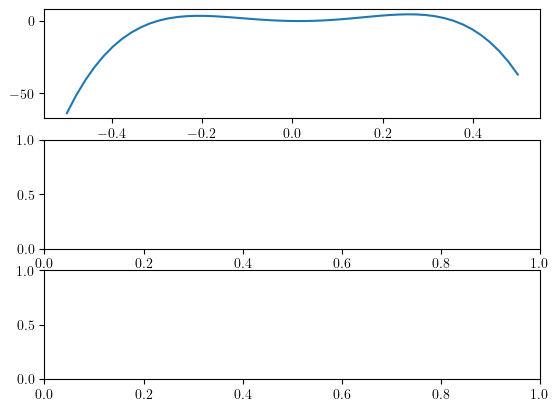

7.0 2.666666666666667 1.666666666666667


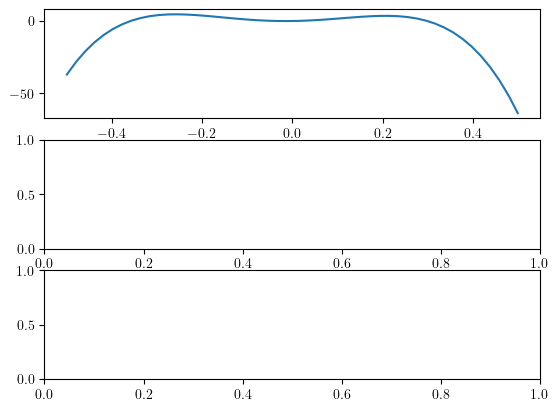

7.0 2.666666666666667 5.0


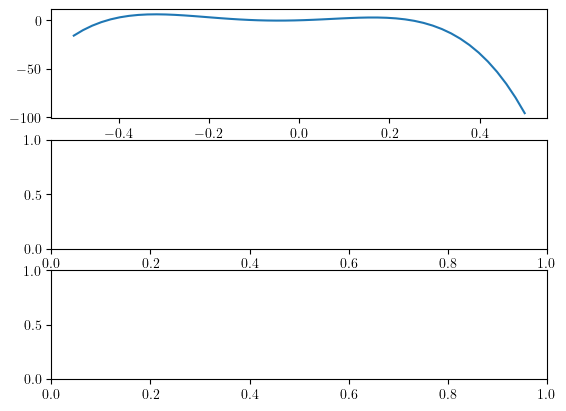

7.0 4.333333333333334 -5.0


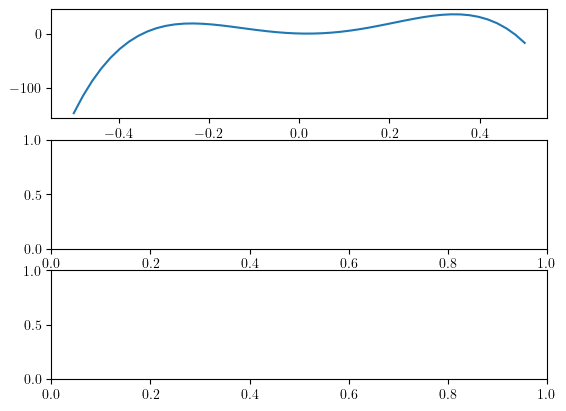

7.0 4.333333333333334 -1.6666666666666665


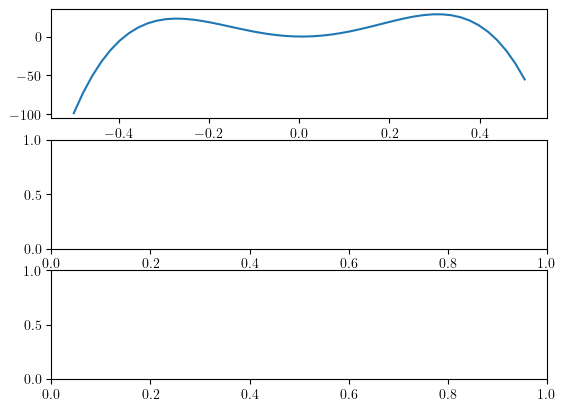

7.0 4.333333333333334 1.666666666666667


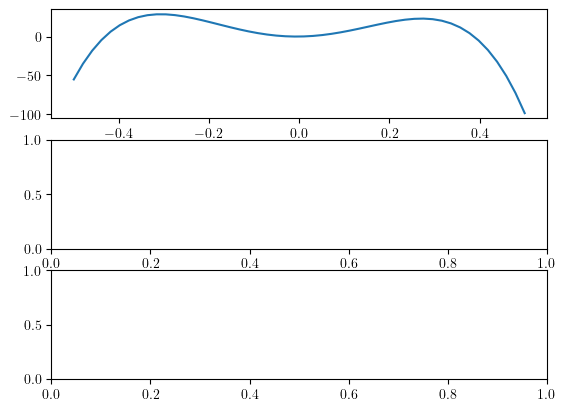

7.0 4.333333333333334 5.0


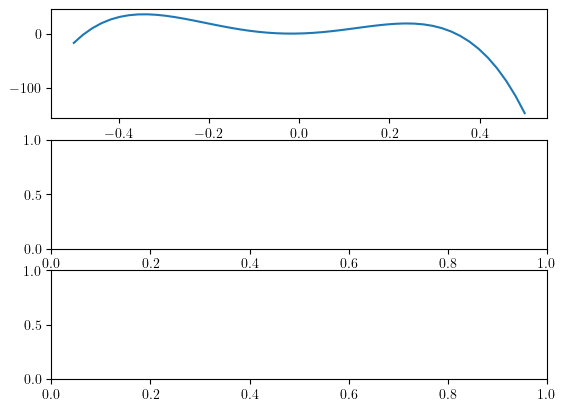

7.0 6.0 -5.0


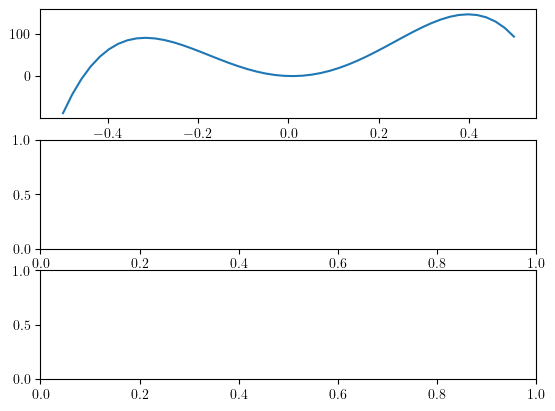

7.0 6.0 -1.6666666666666665


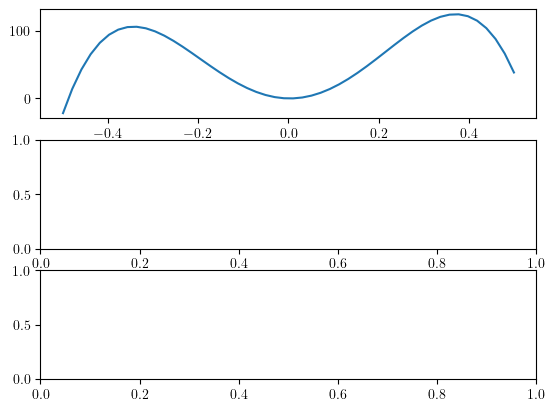

7.0 6.0 1.666666666666667


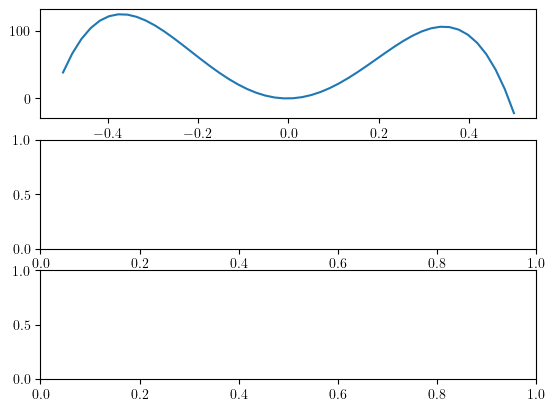

7.0 6.0 5.0


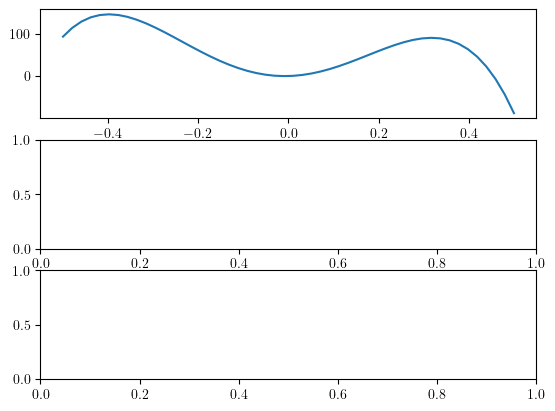

10.0 1.0 -5.0


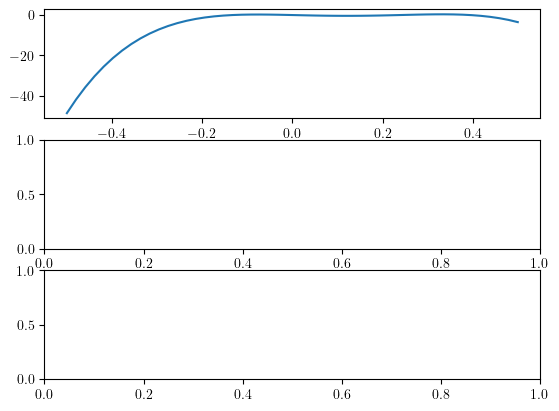

10.0 1.0 -1.6666666666666665


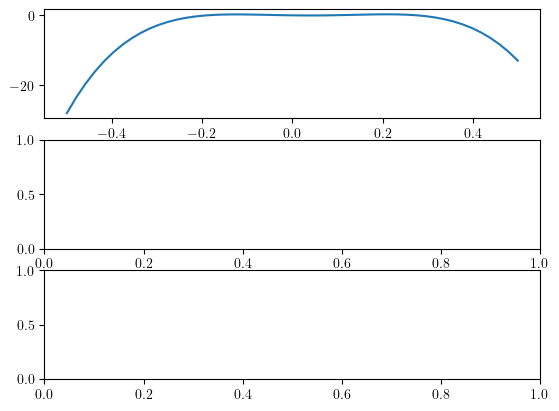

10.0 1.0 1.666666666666667


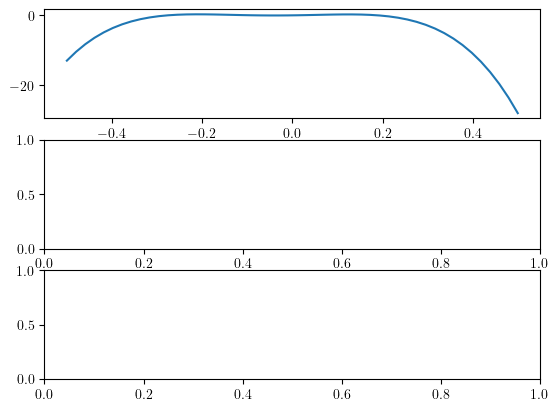

10.0 1.0 5.0


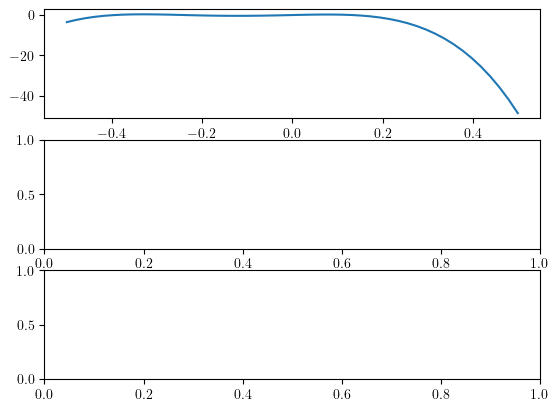

10.0 2.666666666666667 -5.0


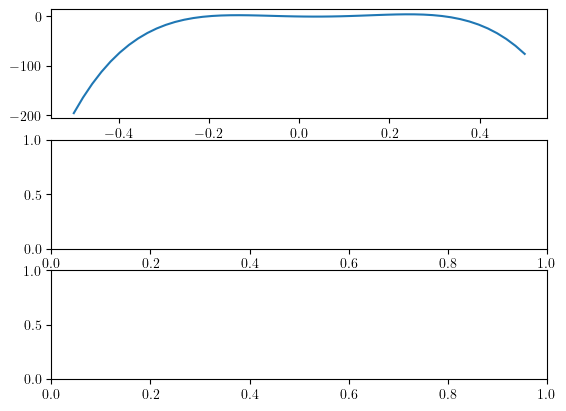

10.0 2.666666666666667 -1.6666666666666665


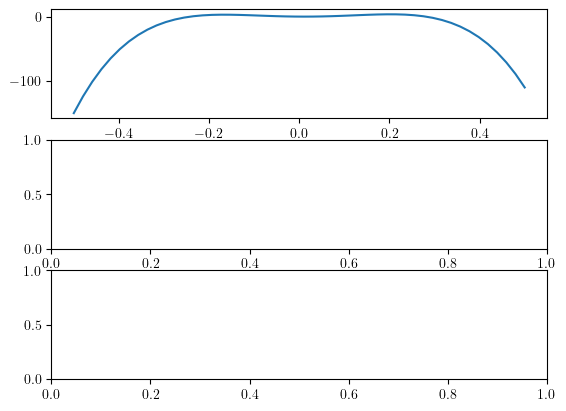

10.0 2.666666666666667 1.666666666666667


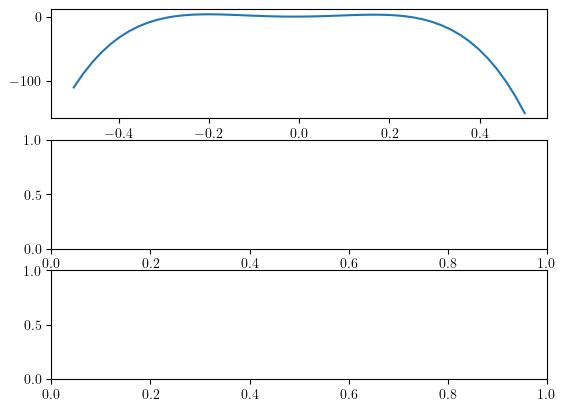

10.0 2.666666666666667 5.0


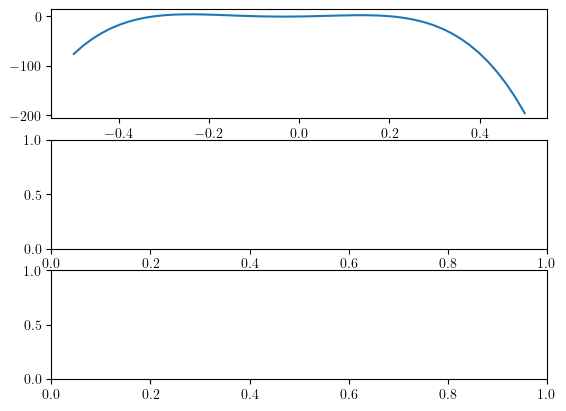

10.0 4.333333333333334 -5.0


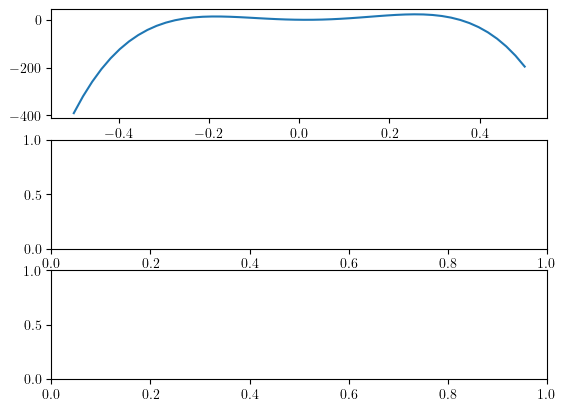

10.0 4.333333333333334 -1.6666666666666665


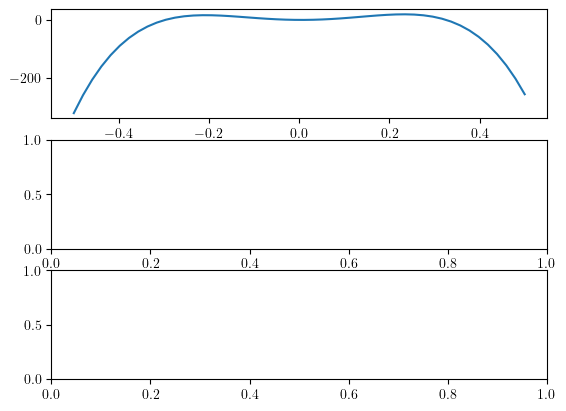

10.0 4.333333333333334 1.666666666666667


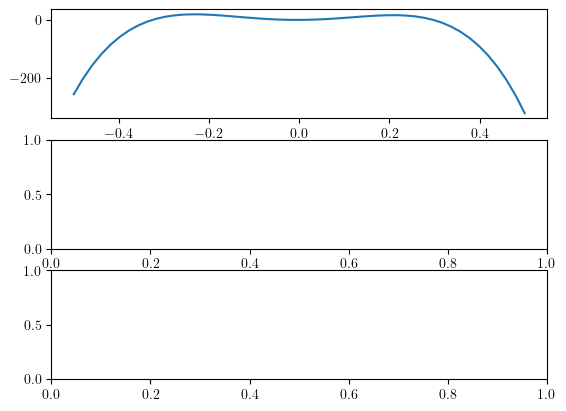

10.0 4.333333333333334 5.0


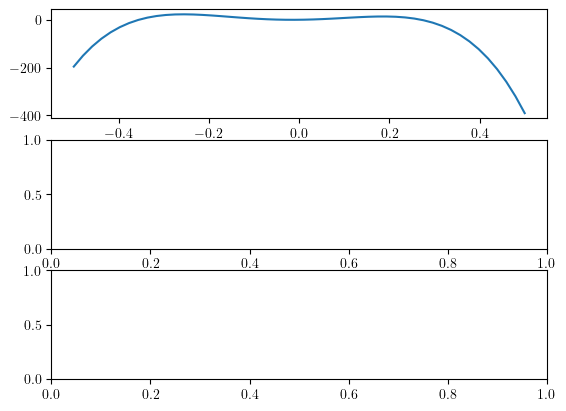

10.0 6.0 -5.0


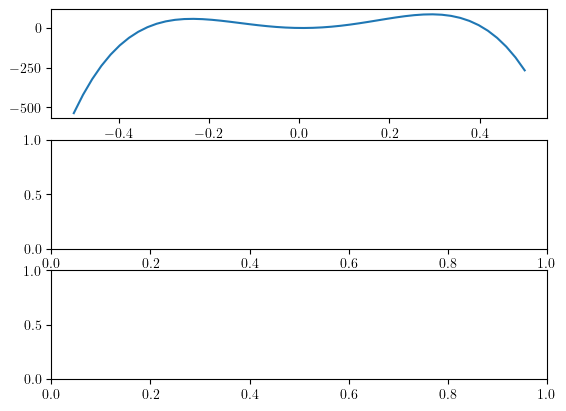

10.0 6.0 -1.6666666666666665


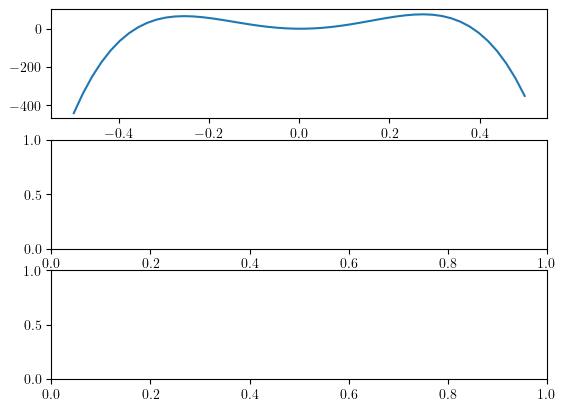

10.0 6.0 1.666666666666667


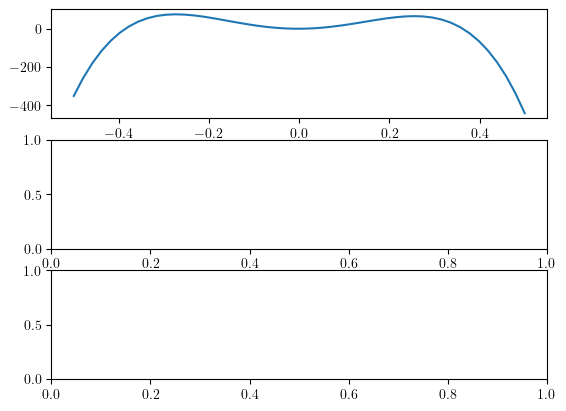

10.0 6.0 5.0


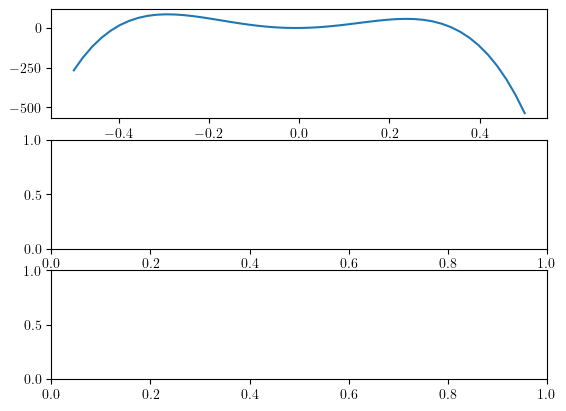

In [75]:
Gam = 1
sgam = 0.2
s =1
gridpoints = 4
k= np.linspace(1,10,gridpoints)
w = np.linspace(1,6,gridpoints)
d = np.linspace(-5,5,gridpoints)
x_range =np.linspace(-0.5,0.5)
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            print(kval,wval,dval)
            fig, ax = plt.subplots(3,1)
            func = np.zeros_like(x_range)
            # for i,x in enumerate(x_range):
                # func[i]= y2ofx(x,wval,kval,dval,Gam,sgam)
            # plt.plot(x_range,num(x_range,wval,kval,dval,Gam,sgam))
            # plt.plot(x_range,denom(x_range,wval,kval,dval,Gam,sgam))
            # print(func)
            ax[0].plot(x_range,insq(x_range,wval,kval,dval,Gam,sgam))
            # ax[1].plot(x_range,func)
            # ax[2].plot(x_range,x_range**2+func**2)
            # plt.scatter(maxx(wval,kval,dval,Gam),0,s=20,color='0')
            plt.show()

In [4]:
Gam = 1
sgam = 0.2
s =1
k= np.linspace(1/10**5,10,30)
w = np.linspace(0,6,30)
d = np.linspace(-5,5,30)
xsol = np.ones((30,30,30,10))
# xgrid = np.linspace(-0.5-1/10**5,0.5+1/10**5,40)
solution_number = np.zeros((30,30,30))
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            sol_numb = 0
            xgrid = set_xgird(wval,kval,dval,Gam,sgam)
            # print(xgrid)
            if xgrid[0]==-2:
                continue
            for j in range(len(xgrid)-1):
                
                Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
                Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
                if Fl*Fu<=0:
                    r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                    xsol[ik,iw,id,sol_numb] = r.root
                    sol_numb+=1
            solution_number[ik,iw,id]=sol_numb
            if sol_numb==0:
                print(kval,wval,dval)
                
                # print(xgrid)






1e-05 0.0 0.1724137931034484
1e-05 0.0 0.5172413793103452
1e-05 0.0 0.862068965517242
1e-05 0.0 1.2068965517241388
1e-05 0.0 1.5517241379310347
1e-05 0.20689655172413793 0.1724137931034484
1e-05 0.20689655172413793 0.5172413793103452
1e-05 0.20689655172413793 0.862068965517242
1e-05 0.20689655172413793 1.2068965517241388
1e-05 0.20689655172413793 1.5517241379310347
1e-05 0.41379310344827586 0.1724137931034484
1e-05 0.41379310344827586 0.5172413793103452
1e-05 0.41379310344827586 0.862068965517242
1e-05 0.41379310344827586 1.2068965517241388
1e-05 0.41379310344827586 1.5517241379310347
1e-05 0.6206896551724138 0.1724137931034484
1e-05 0.6206896551724138 0.5172413793103452
1e-05 0.6206896551724138 0.862068965517242
1e-05 0.6206896551724138 1.2068965517241388
1e-05 0.6206896551724138 1.5517241379310347
1e-05 0.8275862068965517 0.1724137931034484
1e-05 0.8275862068965517 0.5172413793103452
1e-05 0.8275862068965517 0.862068965517242
1e-05 0.8275862068965517 1.2068965517241388
1e-05 0.827586

/tmp/ipykernel_13482/722408274.py:60: RuntimeWarning: invalid value encountered in sqrt
  return 1/(2*k**2*x)*(k*w*x-Gamma*delta/2+np.sqrt((k*w*x-Gamma*delta/2)**2-4*x*k**2*(k**2*x**3+AOK(k,Gamma,gamma)/2)))


3.4482824137931036 4.9655172413793105 4.655172413793103
3.4482824137931036 4.9655172413793105 5.0
3.4482824137931036 5.172413793103448 -2.2413793103448274
3.4482824137931036 5.172413793103448 -1.8965517241379306
3.4482824137931036 5.172413793103448 -1.5517241379310343
3.4482824137931036 5.172413793103448 -1.206896551724138
3.4482824137931036 5.172413793103448 -0.5172413793103443
3.4482824137931036 5.172413793103448 0.1724137931034484
3.4482824137931036 5.172413793103448 0.5172413793103452
3.4482824137931036 5.172413793103448 0.862068965517242
3.4482824137931036 5.172413793103448 1.2068965517241388
3.4482824137931036 5.172413793103448 1.5517241379310347
3.4482824137931036 5.172413793103448 1.8965517241379315
3.4482824137931036 5.172413793103448 2.2413793103448283
3.4482824137931036 5.172413793103448 2.586206896551724
3.4482824137931036 5.172413793103448 2.931034482758621
3.4482824137931036 5.172413793103448 3.275862068965518
3.4482824137931036 5.172413793103448 3.6206896551724146
3.4482

KeyboardInterrupt: 

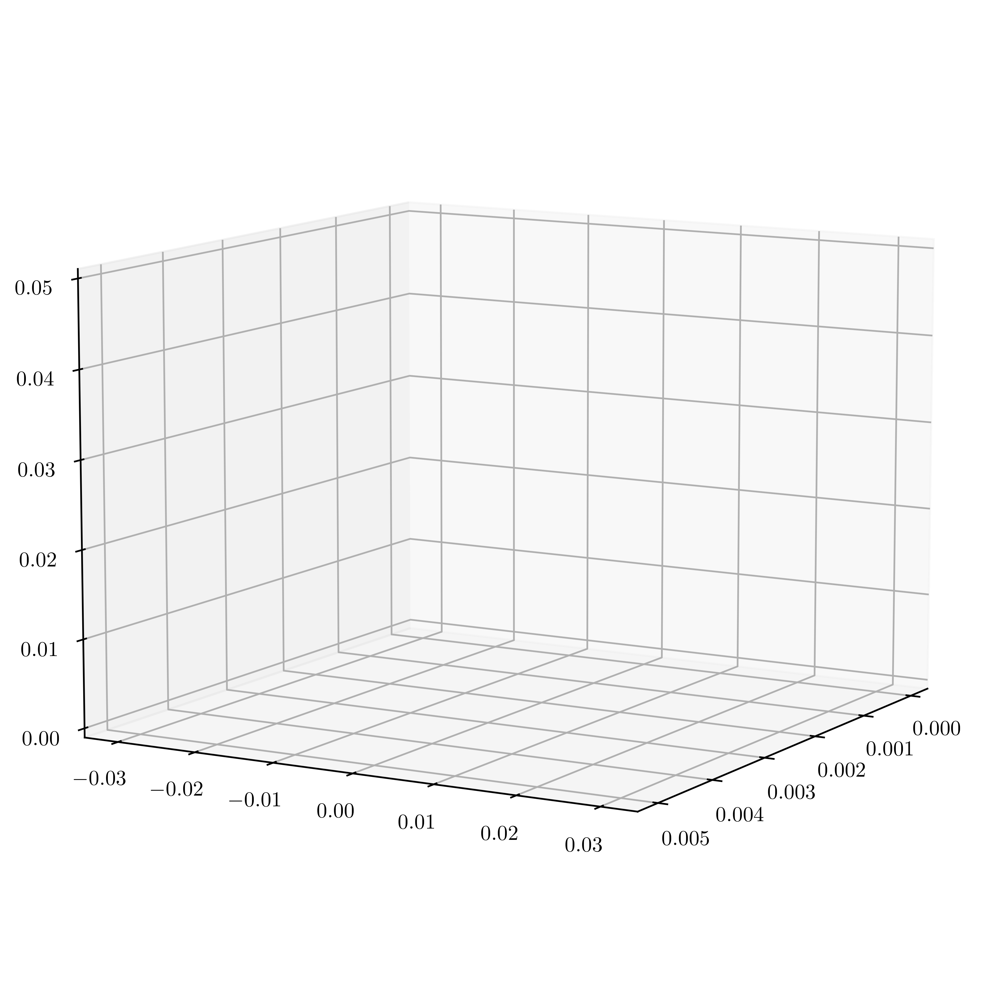

In [5]:
# find solutions for small omega
Gam = 1
sgam = 0.2
def test(w,delta,Gam):
   return w**4/4-Gam**2*delta**2+Gam**2*delta*w/2
def testhelper(delta,Gam):
  if delta>=0:
    return -(Gam**2*delta/2)**(1/3)
  else:
    return (Gam**2*(-delta)/2)**(1/3)
def test2(x,w,k,delta,Gam):
  w**4*x-(2*w*k*x+Gam*delta)*((2*w*k*x+Gam*delta)*x-Gam*w)
test_vec = np.vectorize(test)
x = np.linspace(-1,1)
ws = np.zeros((*x.shape,2))
grid = 30
wt = np.linspace(0,0.005,grid)
kt = np.linspace(0,0.05,grid)
dt = np.linspace(-0.03,0.03,grid)
sol = np.zeros((grid,grid,grid))
for ik, kval in enumerate(kt):
  for iw, wval in enumerate(wt):
    for id, dval in enumerate(dt):
      if wval ==0:
        continue
      
      r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=(0,0))
      z = m_z(r.x[0],r.x[1],wval,kval,Gam)
      p = np.array([r.x[0],r.x[1],z])
      if np.linalg.norm(p)<0.5:
        sol[ik,iw,id]=1
      else:
        print(wval)
        
fig = plt.figure(figsize=(20.6*cm, 25.1*cm),dpi=600)

# Create a GridSpec layout
# gs = gridspec.GridSpec(2, 3, figure=fig,wspace=0.3,hspace=-0.3,top=0.9)  # 2 rows and 3 columns for flexible layout

# Plot 1: Sloped view (spans entire first row)
ax1 = fig.add_subplot(projection='3d') 
W, D, K = np.meshgrid(wt, dt, kt, indexing='ij')
sol = np.swapaxes(np.swapaxes(sol[:-1, :-1, :-1],0,1),1,2)
# ax1.yaxis.set_major_locator(ticker.MultipleLocator(2))
# ax1.yaxis.set_minor_locator(ticker.MultipleLocator(1))
# ax1.xaxis.set_major_locator(ticker.MultipleLocator(1))
# ax1.xaxis.set_minor_locator(ticker.MultipleLocator(1))
# ax1.zaxis.set_minor_locator(ticker.MultipleLocator(1))
# print(sol)
ax1.view_init(10,30,0)
ax1.voxels(W, D, K, 1-sol)  
plt.show()
          


In [ ]:
from math import isclose
Gam = 1
sgam = 0.2
s =1
if s==1:
    yofx = y1ofx
else:
    yofx = y2ofx
x_range = np.linspace(-0.5,0.5)
gridpoints = 71
F = Fx
# params = "4.20004 0.75000007 0.3599999999999999"
# params=params.split()
# params = [float(p) for p in params]
# k0,w0,d0 = params

# p_range = 0.5
# k= np.linspace(k0-p_range,k0+p_range,gridpoints)
# w = np.linspace(w0-p_range,w0+p_range,gridpoints)
# d = np.linspace(d0-p_range,d0+p_range,gridpoints)

k= np.linspace(1/10**4,7,gridpoints)
w = np.linspace(1/10**7,2.5,gridpoints)
d = np.linspace(-3,3,gridpoints)
xsol = np.ones((gridpoints,gridpoints,gridpoints,30))
ysol = np.ones_like(xsol)
yvariant = np.zeros_like(xsol)
# xgrid = np.linspace(-0.5-1/10**5,0.5+1/10**5,40)
solution_number = np.zeros((gridpoints,gridpoints,gridpoints),dtype=np.int16)
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            # kval, wval,dval =1.0, 2+2/3, 1+2/3
            # if dval>=0:
            s=1
            yofx = y1ofx
            # else:
            if dval==0:
                if kval/(Gam+sgam)>1:
                    try:
                    #     1
                    # except:
                    #     pass
                    # if True:
                        rcrit = root_scalar(FKK,args=(kval/(Gam+sgam)),method='brentq',bracket=(1/10**7,10**6))
                        if rcrit.root*np.sqrt(Gam*(Gam+sgam))>=wval:
                            solution_number[ik,iw,id]=3
                            r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                            
                            xsol[ik,iw,id,0]= 0
                            ysol[ik,iw,id,0]=r.root
                           

                       
                            r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(minF(wval,kval,Gam,sgam),maxF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))

                            xsol[ik,iw,id,1]=0
                            ysol[ik,iw,id,1]= r.root
                            


                            r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(maxF(wval,kval,Gam,sgam),1))#,maxF(a,kwval)))
                            xsol[ik,iw,id,2] =0
                            ysol[ik,iw,id,2]= r.root
                            

                            
                       
                        else: 
                            r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                            xsol[ik,iw,id,0] =0
                            ysol[ik,iw,id,0]= r.root
                            solution_number[ik,iw,id]=1
                        continue
                        # print(i,FKK(1/10**8,K[i]),FKK(10**7,K[i]))
                    except:
                        print(ik,iw,id)
                        continue
                else:
                    r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                            
                    xsol[ik,iw,id,0] =0
                    ysol[ik,iw,id,0]= r.root
                    solution_number[ik,iw,id]=1
                continue
            # elif wval==0:
            #     xsol[ik,iw,id,0]=0
            #     ysol[ik,iw,id,0]=0
            #     continue   
            sol_numb = 0
            xgrid, points = set_xgird(wval,kval,dval,Gam,sgam,points=True)
            Func = np.zeros_like(xgrid)
            if xgrid[0]==-2:
                
                try:
                    r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([0,0])) 
                    xsol[ik,iw,id,0]=r.x[0]
                    ysol[ik,iw,id,0]=r.x[1]
                    solution_number[ik,iw,id]=1
                    x= r.x[0]
                    y=r.x[1]
                    z=m_z(x,y,wval,kval,Gam)
                    if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
                        print('no sol for testcase 0,0',gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
                        xsol[ik,iw,id,0]=1
                        ysol[ik,iw,id,0]=1
                        solution_number[ik,iw,id]=0

                except:
                    print('no solution: ',kval,wval,dval)


                
                # plt.figure()
                # plt.plot(x_range,insq(x_range,wval,kval,dval,Gam,sgam))
                # plt.show()
                continue
            # print(xgrid[-1],points[-1],xgrid[-1]==points[-1])
            xsol_list = []
            ysol_list = []
            variant_list = []
            for j in range(len(xgrid)-1):
                if np.any(xgrid[j]==points):
                    y = y1ofx(xgrid[j],wval,kval,dval,Gam,sgam)
                if np.any(xgrid[j+1]!=points[1::2]):
                    # print(True)
                    Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
                    Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
                    if Fl*Fu<=0:
                        r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                        xsol_list, ysol_list , variant_list, sol_numb =add_sol1(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                       
                    Fl = Fx2(xgrid[j],wval,kval,dval,Gam,sgam,s)
                    Fu = Fx2(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
                    
                    if Fl*Fu<=0:
                        r = root_scalar(Fx2,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                        xsol_list, ysol_list , variant_list, sol_numb =add_sol2(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                        
                        
            i=0
            relative_tol = 10e-7
            absolute_to = 1/10**7
            while i<sol_numb:
                x = xsol_list[i]
                y = ysol_list[i]
                z = m_z(x,y,wval,kval,Gam)
                if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
                    print(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
                    sol_numb-=1
                    xsol_list.pop(i)
                    ysol_list.pop(i)
                    variant_list.pop(i)
                i+=1
            for index in range(sol_numb):
                xsol[ik,iw,id,index]= xsol_list[index]
                ysol[ik,iw,id,index]= ysol_list[index]
                yvariant[ik,iw,id,index] = variant_list[index]
            solution_number[ik,iw,id]+=sol_numb

            s=2
            yofx = y2ofx
            xsol_list = []
            ysol_list = []
            variant_list = []
            sol_numb = 0
            for j in range(len(xgrid)-1):
                
                if np.any(xgrid[j+1]!=points[1::2]):
                    # print(True)
                    Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
                    Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
                    if Fl*Fu<=0:
                        r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                        xsol_list, ysol_list , variant_list, sol_numb =add_sol1(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                        
                    Fl = Fx2(xgrid[j],wval,kval,dval,Gam,sgam,s)
                    Fu = Fx2(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
                    
                    if Fl*Fu<=0:
                        r = root_scalar(Fx2,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                        xsol_list, ysol_list , variant_list, sol_numb =add_sol2(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                        
            for p in points:
                
                y = y1ofx(p,wval,kval,dval,Gam,sgam)
                r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([p,y]))  
                new_sol=1
                for sol in xsol[ik,iw,id,:]:
                    if isclose(sol,r.x[0],abs_tol=1/10**5):
                        new_sol = 0
                        break
                for sol in xsol_list:
                    if isclose(sol,r.x[0],abs_tol=1/10**5):
                        new_sol = 0
                        break
                if new_sol:
                    xsol_list.append(r.x[0])
                    ysol_list.append(r.x[1])
                    variant_list.append(0)
                    sol_numb+=1
                y = y2ofx(p,wval,kval,dval,Gam,sgam)
                r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([p,y]))  
                new_sol=1
                for sol in xsol[ik,iw,id,:]:
                    if isclose(sol,r.x[0],abs_tol=1/10**5):
                        new_sol = 0
                        break
                for sol in xsol_list:
                    if isclose(sol,r.x[0],abs_tol=1/10**5):
                        new_sol = 0
                        break
                if new_sol:
                    xsol_list.append(r.x[0])
                    ysol_list.append(r.x[1])
                    variant_list.append(0)
                    sol_numb+=1
            i=0
            while i<sol_numb:
                x = xsol_list[i]
                y = ysol_list[i]
                z = m_z(x,y,wval,kval,Gam)
                if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
                    print(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
                    sol_numb-=1
                    xsol_list.pop(i)
                    ysol_list.pop(i)
                    variant_list.pop(i)
                else:
                    i+=1
            for index in range(sol_numb):
                xsol[ik,iw,id,int(solution_number[ik,iw,id])+index]= xsol_list[index]
                ysol[ik,iw,id,int(solution_number[ik,iw,id])+index]= ysol_list[index]
                yvariant[ik,iw,id,int(solution_number[ik,iw,id])+index]= variant_list[index]
            solution_number[ik,iw,id]+=sol_numb

            # print(kval,wval,dval)
            # print(-Gam*dval/(2*kval*wval))
            # print(xgrid)
solution_number
np.save('solnumb71',solution_number)
np.save('xsol71',xsol)
np.save('ysol71',ysol)

/tmp/ipykernel_50200/3370557126.py:103: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
/tmp/ipykernel_50200/3370557126.py:148: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,

[[ 0.43077192]
 [-7.18840283]
 [ 0.        ]] -14.376805658881338 -0.50001 8.343796636623017 4.531949349389206 0 params:  0.10009857142857144 1.3214286185714288 -0.08571428571428585
[[-0.43077192]
 [-7.18840283]
 [ 0.        ]] 0.37935385920817555 0.50001 8.343796636623017 4.531949349389206 0 params:  0.10009857142857144 1.3214286185714288 0.08571428571428585
[[ 0.43354985]
 [-7.49038538]
 [ 0.        ]] -14.98077076461891 -0.50001 8.638608850420493 4.728888812657782 0 params:  0.10009857142857144 1.3571429028571431 -0.08571428571428585
[[-0.43354985]
 [-7.49038538]
 [ 0.        ]] 0.37107416877855104 0.50001 8.638608850420493 4.728888812657782 0 params:  0.10009857142857144 1.3571429028571431 0.08571428571428585
[[ 0.44010019]
 [-7.7935153 ]
 [ 0.        ]] -15.541424109683227 -0.538750007962364 8.927340938611362 4.927859709207249 0 params:  0.10009857142857144 1.3928571871428574 -0.08571428571428585
[[-0.44010019]
 [-7.7935153 ]
 [ 0.        ]] 0.36082539927111623 0.5387500419139158 

/tmp/ipykernel_50200/2332008755.py:69: RuntimeWarning: divide by zero encountered in scalar divide
  return 1/(Gamma*delta+2*k*w*x)*(w**2*x+np.sqrt(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)))
/tmp/ipykernel_50200/2332008755.py:105: RuntimeWarning: invalid value encountered in scalar subtract
  return Gamma*delta*x-w*Gamma-AOK(k,Gamma,gamma)*y-2*k**2*y*(x**2+y**2)+2*k*w*(x**2+2*y**2)-2*w**2*y
/tmp/ipykernel_50200/2332008755.py:113: RuntimeWarning: invalid value encountered in scalar subtract
  return -Gamma*delta*y-AOK(k,Gamma,gamma)*x-2*k**2*x*(x**2+y**2)+2*k*w*x*y


[[-2.16551013e-04]
 [ 6.01622788e-03]
 [-2.48824399e-17]] nan -0.3190844748862065 0.009795028527539709 0.21499334360990813 0 params:  2.8000600000000007 0.035714384285714294 -0.08571428571428585
[[-2.13227453e-04]
 [ 6.01656486e-03]
 [-5.96311195e-19]] nan -0.3191432193332568 0.00817881498124885 0.21491198129349465 0 params:  2.8000600000000007 0.035714384285714294 -0.08571428571428585
[[-2.16537822e-03]
 [ 6.03703193e-03]
 [-3.46944695e-18]] nan -0.30519931753286594 -0.09199453845424702 0.21220144324612256 0 params:  2.8000600000000007 0.035714384285714294 -0.08571428571428585
[[-5.04358373e-03]
 [ 5.87312991e-03]
 [-6.07153217e-18]] 0.03138327297591926 -0.25102132070085137 -0.19552426445968485 0.20953486076649752 0 params:  2.8000600000000007 0.035714384285714294 -0.08571428571428585
[[ 3.50585281e-03]
 [ 6.14879197e-03]
 [-2.42861287e-17]] nan -0.27162873514570746 0.16928331970205315 0.21921046935090294 0 params:  2.8000600000000007 0.035714384285714294 -0.08571428571428585
[[-4.423

/tmp/ipykernel_50200/2332008755.py:93: RuntimeWarning: divide by zero encountered in scalar divide
  return 1/(Gamma*delta+prec2*k*w*x)*(w**prec2*x-np.sqrt(w**4*x**prec2-(prec2*k*w*x+Gamma*delta)*(prec2*k*w*x**3-w*Gamma*x+Gamma*delta*x**prec2)))


[[ 0.01147765]
 [-0.06394654]
 [ 0.        ]] -0.1245289363172089 -0.17650175850598832 0.3173280479525894 0.32555050664675883 0 params:  3.3000528571428576 0.8214286385714287 -0.6000000000000001
[[ 0.00966519]
 [-0.06883377]
 [ 0.        ]] -0.13654779413974905 -0.14700973521539817 0.3318859636326783 0.3378051589575896 0 params:  3.3000528571428576 0.8214286385714287 -0.5142857142857142
[[ 0.00902652]
 [-0.07259412]
 [ 0.        ]] -0.14583791538415297 -0.11873724327358698 0.34331164318288365 0.3465263635209805 0 params:  3.3000528571428576 0.8214286385714287 -0.4285714285714284
[[ 0.00759365]
 [-0.07566402]
 [ 0.        ]] -0.15297813675632438 -0.09250184286846029 0.35073752746169634 0.35390666154133504 0 params:  3.3000528571428576 0.8214286385714287 -0.34285714285714297
[[ 0.00231035]
 [-0.08067033]
 [ 0.        ]] -0.16440831583009696 -0.022245535281896017 0.3627403026127134 0.3621095015698551 0 params:  3.3000528571428576 0.8214286385714287 -0.08571428571428585
[[-0.00231029]
 [-0

In [53]:
root_path = ''
tail = '71.npy'
params = np.load(root_path+'params71.npy')
k,w,d = params[:,0], params[:,1], params[:,2]
solution_number = np.load(root_path+'solnumb'+tail)
xsol = np.load(root_path+'xsol'+tail)
ysol = np.load(root_path+'ysol'+tail)
gridpoints = xsol.shape[0]

In [ ]:

root_path = ''
k = np.load(root_path+'kparam_k_0_11.npy')
w = np.load(root_path+'wparam_k_0_11.npy')
d = np.load(root_path+'dparam_k_0_11.npy')
solution_number = np.load(root_path+'solnumb_k_0_11.npy')
xsol = np.load(root_path+'xsol_k_0_11.npy')
ysol = np.load(root_path+'ysol_k_0_11.npy')
gridpoints = xsol.shape[0]

In [23]:
xsol2.shape

(91, 91, 91, 30)

In [5]:

root_path = '4.4k13_1.5w5.5_3d/'
k2 = np.load(root_path+'kparam_4.4k13_1.5w5.5.npy')
w2 = np.load(root_path+'wparam_4.4k13_1.5w5.5.npy')
d2 = np.load(root_path+'dparam_4.4k13_1.5w5.5.npy')
solution_number2 = np.load(root_path+'solnumb_4.4k13_1.5w5.5.npy')
xsol2 = np.load(root_path+'xsol_4.4k13_1.5w5.5.npy')
ysol2 = np.load(root_path+'ysol_4.4k13_1.5w5.5.npy')
stability_plus = np.load(root_path+'stability_plus.npy')
stability = np.load(root_path+'stability.npy')
gridpoints2 = solution_number2.shape[0]

In [64]:
def crit(k,k2):    
    ik_crit= 0
    for ik,kval in enumerate(k):
        if kval>=k2[0]:
            ik_crit = ik
            break
    return ik_crit
ik_crit, iw_crit, id_crit = crit(k,k2), crit(w,w2), crit(d,d2)
k_step = k2[1]-k2[0]
w_step = w2[1]-w2[0]
d_step = d2[1]-d2[0]
def x1(k,k_step,ik_crit):
    return np.linspace(k[0],k[ik_crit-1],int((k[ik_crit-1]-k[0])/k_step))
k1, w1, d1 = x1(k,k_step,ik_crit), x1(w,w_step,iw_crit), x1(d,d_step,id_crit)
def findlagest(x,x0):
    for i, val in enumerate(x):
        if val>x0:
            return i-1
    return -1
xsol1 = np.ones((k.shape[0],w.shape[0],d.shape[0],5))
ysol1 = np.ones_like(xsol1)
solution_number1 = np.zeros((k.shape[0],w.shape[0],d.shape[0]))
for ik, kval in enumerate(k1):
    for iw, wval in enumerate(w1):
        for id, dval in enumerate(d1):
            oldik, oldiw, oldid = findlagest(k,kval), findlagest(w,wval), findlagest(d,dval)
            print(oldik, oldiw, oldid,solution_number[oldik,oldiw,oldid])
            solution_number1[ik,iw,id]=solution_number[oldik,oldiw,oldid]
            xsol1[ik,iw,id] = xsol[oldik,oldiw,oldid,:5]
            ysol1[ik,iw,id] = ysol[oldik,oldiw,oldid,:5]

0 0 0 1
0 0 1 1
0 0 2 1
0 0 3 1
0 0 4 1
0 0 5 1
0 0 6 1
0 0 7 1
0 0 8 1
0 0 9 1
0 0 10 1
0 0 11 1
0 0 12 1
0 0 13 1
0 0 14 1
0 0 15 1
0 0 16 1
0 0 17 1
0 0 18 1
0 0 19 1
0 0 20 1
0 0 21 1
0 0 22 1
0 0 23 1
0 0 24 1
0 0 25 1
0 0 26 1
0 0 27 1
0 0 28 1
0 0 29 1
0 0 30 1
0 0 31 1
0 0 32 1
0 0 33 1
0 0 34 1
0 0 35 1
0 0 36 1
0 0 37 1
0 0 38 1
0 0 39 1
0 0 40 1
0 0 41 1
0 0 42 1
0 0 43 1
0 0 45 1
0 0 46 1
0 0 47 1
0 0 48 1
0 0 49 1
0 0 50 1
0 0 51 1
0 0 52 1
0 0 53 1
0 0 54 1
0 0 55 1
0 0 56 1
0 0 57 1
0 0 58 1
0 0 59 1
0 0 60 1
0 0 61 1
0 0 62 1
0 0 63 1
0 0 64 1
0 0 65 1
0 0 66 1
0 0 67 1
0 0 68 1
0 0 69 1
0 0 70 1
0 0 71 1
0 0 72 1
0 0 73 1
0 0 74 1
0 0 75 1
0 0 76 1
0 0 77 1
0 0 78 1
0 0 79 1
0 0 80 1
0 0 81 1
0 0 82 1
0 0 83 1
0 0 84 1
0 0 85 1
0 0 86 1
0 0 87 1
0 0 88 1
0 0 -1 1
0 1 0 1
0 1 1 1
0 1 2 1
0 1 3 1
0 1 4 1
0 1 5 1
0 1 6 1
0 1 7 1
0 1 8 1
0 1 9 1
0 1 10 1
0 1 11 1
0 1 12 1
0 1 13 1
0 1 14 1
0 1 15 1
0 1 16 1
0 1 17 1
0 1 18 1
0 1 19 1
0 1 20 1
0 1 21 1
0 1 22 1
0 1 23 1
0 1

In [8]:
k, w, d = np.concatenate((k1,k2)), np.concatenate((w1,w2)), d1
def plotparams(k):
    plt.figure()
    plt.scatter(np.arange(k.shape[0]),k)
    plt.show()
    plt.figure()
    plt.scatter(np.arange(k.shape[0]-1),k[:-1]-k[1:])
    plt.show()

plotparams(k)

NameError: name 'k1' is not defined

In [6]:
# k, w, d, solution_number, xsol, ysol = k1, w1, d1, solution_number1, xsol1, ysol1
k, w, d, solution_number, xsol, ysol,gridpoints = k2, w2, d2, solution_number2, xsol2, ysol2, gridpoints2

In [9]:
a = 8
a/=2/4
a

16.0

7.911764705882352 3.1176470588235294 -3.8529411764705883


/tmp/ipykernel_305344/2633283238.py:69: RuntimeWarning: invalid value encountered in sqrt
  return 1/(Gamma*delta+2*k*w*x)*(w**2*x+np.sqrt(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)))


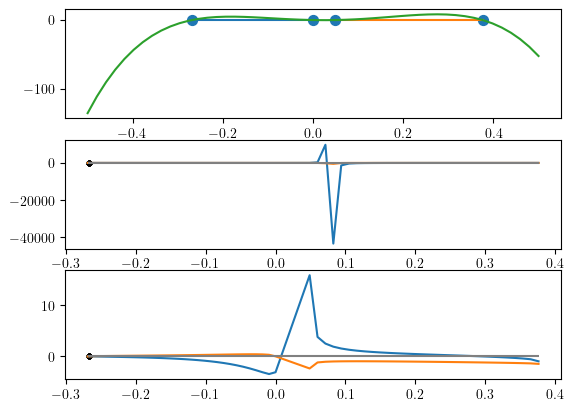

7.352941176470589 3.5588235294117645 -3.0882352941176467


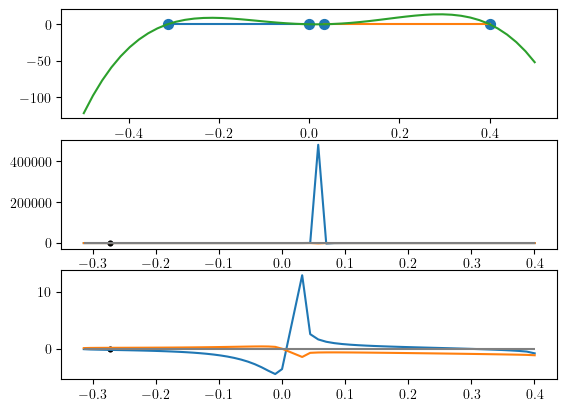

8.088235294117647 3.323529411764706 -3.0294117647058822


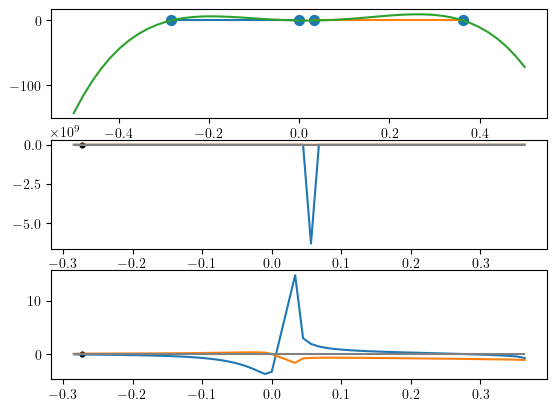

7.764705882352941 3.264705882352941 -3.4705882352941178


/tmp/ipykernel_305344/2633283238.py:69: RuntimeWarning: invalid value encountered in sqrt
  return 1/(Gamma*delta+2*k*w*x)*(w**2*x+np.sqrt(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)))


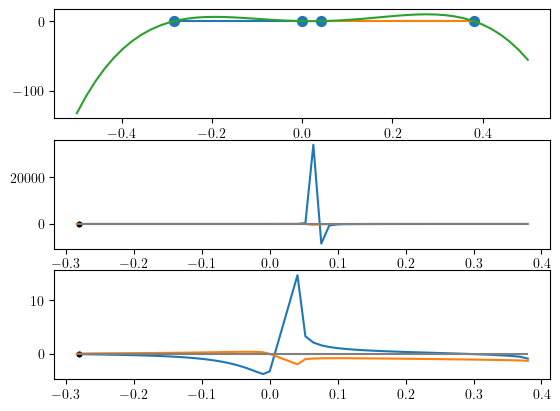

7.4411764705882355 3.4117647058823533 -3.3823529411764706


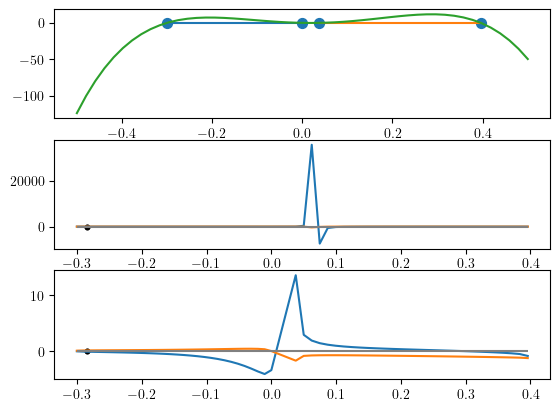

7.176470588235294 3.6470588235294117 -3.8823529411764706


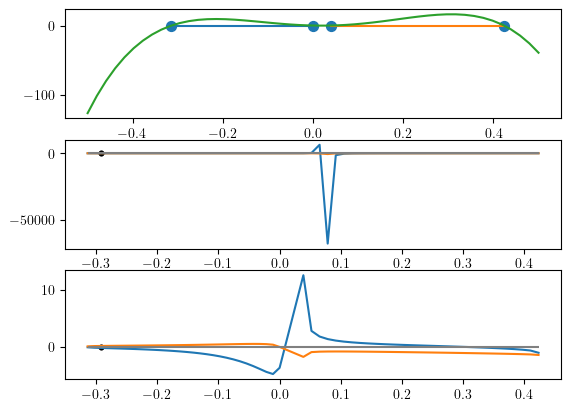

7.235294117647059 3.764705882352941 -3.5882352941176467


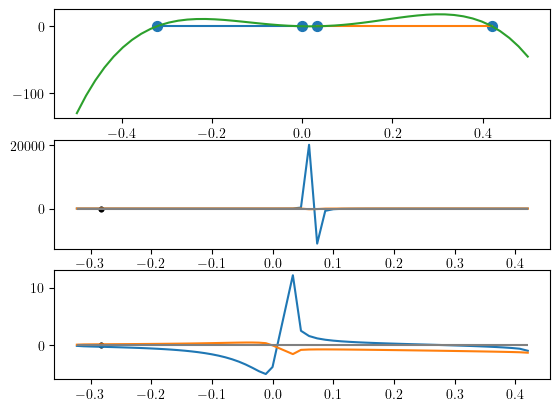

7.235294117647059 3.5 -3.8235294117647056


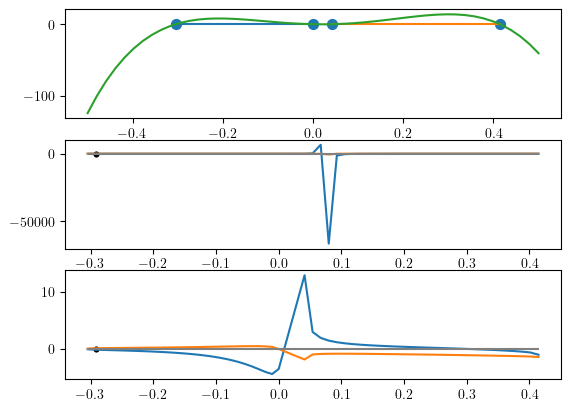

8.117647058823529 3.5 -3.5


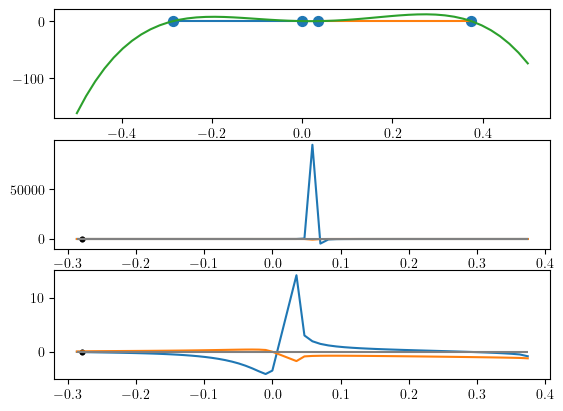

8.088235294117647 3.0294117647058822 -3.764705882352941


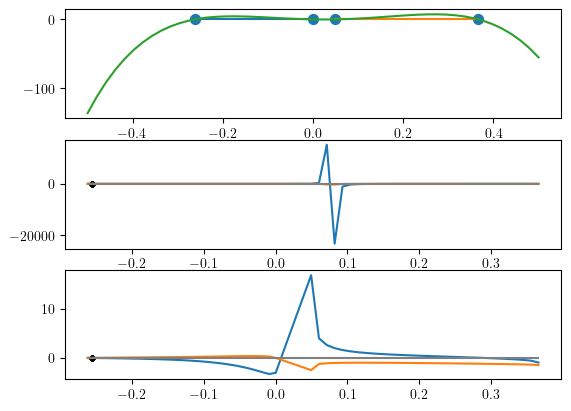

In [17]:
from random import random
for reps in range(10):
    ik, iw, id = (np.array([random(),random(),random()])*gridpoints).astype(np.int64)
    kval, wval, dval = k[ik], w[iw], d[id]
    print(kval, wval, dval)
    xgrid, points = set_xgird(wval,kval,dval,Gam,sgam,points=True)
    Func = np.zeros_like(xgrid)
    if xgrid[0]==-2:
        plt.figure()
        plt.plot(x_range,insq(x_range,wval,kval,dval,Gam,sgam))
        plt.show()
        continue
    fig, ax = plt.subplots(3,1)
    for n in range(3):
        if n==1:
            Func  = np.zeros_like(xgrid)
            for i,x in enumerate(xgrid):
                # print(insq_preci(x,wval,kval,dval,Gam,sgam))
                # if dval>=0:
                #     Func[i]=y1ofx(x,wval,kval,dval,Gam,sgam)
                # else:
                #     Func[i]=y2ofx(x,wval,kval,dval,Gam,sgam)
                Func1  = np.zeros_like(xgrid)
                Func2 = np.zeros_like(xgrid)
                Func3 = np.zeros_like(xgrid)
                if dval>=0:
                    for i,x in enumerate(xgrid):
                    # print(insq_preci(x,wval,kval,dval,Gam,sgam))
                    # Func2[i]=num(x,wval,kval,dval,Gam,sgam)
                        # y =y1ofx(x,wval,kval,dval,Gam,sgam)
                        Func1[i]=Fx(x,wval,kval,dval,Gam,sgam,2)#*Decimal(x)
                        Func2[i]=Fx2(x,wval,kval,dval,Gam,sgam,2)#*y
                    # Func3[i]=eq(x,wval,kval,dval,Gam,sgam,1)
                else:
                    for i,x in enumerate(xgrid):
                        # y = y2ofx(x,wval,kval,dval,Gam,sgam)
                        Func1[i]=Fx(x,wval,kval,dval,Gam,sgam,1)#*Decimal(x)
                        Func2[i]=Fx2(x,wval,kval,dval,Gam,sgam,1)#*y
            
        elif n==0:
            Func  = np.zeros_like(x_range)
            for i,x in enumerate(x_range):
                Func[i]=insq(x,wval,kval,dval,Gam,sgam)
        else:
            Func1  = np.zeros_like(xgrid)
            Func2 = np.zeros_like(xgrid)
            Func3 = np.zeros_like(xgrid)
            if dval>=0:
                for i,x in enumerate(xgrid):
                # print(insq_preci(x,wval,kval,dval,Gam,sgam))
                # Func2[i]=num(x,wval,kval,dval,Gam,sgam)
                    # y =y1ofx(x,wval,kval,dval,Gam,sgam)
                    Func1[i]=Fx(x,wval,kval,dval,Gam,sgam,1)#*Decimal(x)
                    Func2[i]=Fx2(x,wval,kval,dval,Gam,sgam,1)#*y
                    # Func3[i]=eq(x,wval,kval,dval,Gam,sgam,1)
            else:
                for i,x in enumerate(xgrid):
                    # y = y2ofx(x,wval,kval,dval,Gam,sgam)
                    Func1[i]=Fx(x,wval,kval,dval,Gam,sgam,2)#*Decimal(x)
                    Func2[i]=Fx2(x,wval,kval,dval,Gam,sgam,2)#*y
                    # Func3[i]=eq(x,wval,kval,dval,Gam,sgam,2)
        for j in range(len(points)):
            if j%2==0 and n==0:
                ax[n].plot(points[j:j+2],np.zeros_like(points[j:j+2]))
        if n==0:
            ax[n].scatter(points,np.zeros_like(points),s=50)    
            ax[n].plot(x_range,Func)
        elif n ==1:
            # ax[n].scatter(xgrid,Func,s=5)
            # for i in range(int(solution_number[ik,iw,id])):
            #     ax[n].scatter(xsol[ik,iw,id,i],0,s=10,color='0')
            # ax[n].plot(xgrid,Func2)
            ax[n].plot(xgrid,Func1)
            ax[n].plot(xgrid,Func2)
            for i in range(int(solution_number[ik,iw,id])):
                ax[n].scatter(xsol[ik,iw,id,i],0,s=10,color='0')
            ax[n].hlines(0,xgrid[0],xgrid[-1],color='0.5')
            
        else:
            ax[n].plot(xgrid,Func1)
            ax[n].plot(xgrid,Func2)
            for i in range(int(solution_number[ik,iw,id])):
                ax[n].scatter(xsol[ik,iw,id,i],0,s=10,color='0')
            ax[n].hlines(0,xgrid[0],xgrid[-1],color='0.5')
            # ax[n].plot(xgrid,Func3)
            # ax[n].scatter(points,np.zeros_like(points),s=50)  
        # if n==0:
        #     print(Func,wval)
    # for soli in range(sol_numb):
    #     ax[-2].scatter(xsol[ik,iw,id,soli],0,s=20,color="0")
        
    plt.show()


In [7]:
def find_index(kv,wv,dv,val=False):
    kind =0
    wind = 0
    dind =0
    for ik, kval in enumerate(k):
        if kval>=kv:
            kind=ik
            break
    for iw, wval in enumerate(w):
        if wval>=wv:
            wind=iw
            break
    for id, dval in enumerate(d):
        if dval>=dv:
            dind = id
            break
    if val:
        return k[kind], w[wind], d[dind]
    return kind, wind, dind

            

In [8]:
def repeat_roots(ik,iw,id,solution_number,xsol,ysol):
    kval, wval, dval = k[ik], w[iw], d[id]
    
    s=1
    yofx = y1ofx
    # else:
    if dval==0:
        if kval/(Gam+sgam)>1:
            try:
            #     1
            # except:
            #     pass
            # if True:
                rcrit = root_scalar(FKK,args=(kval/(Gam+sgam)),method='brentq',bracket=(1/10**7,10**6))
                if rcrit.root*np.sqrt(Gam*(Gam+sgam))>=wval:
                    solution_number[ik,iw,id]=3
                    r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                    
                    xsol[ik,iw,id,0]= 0
                    ysol[ik,iw,id,0]=r.root
                    

                
                    r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(minF(wval,kval,Gam,sgam),maxF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))

                    xsol[ik,iw,id,1]=0
                    ysol[ik,iw,id,1]= r.root
                    


                    r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(maxF(wval,kval,Gam,sgam),1))#,maxF(a,kwval)))
                    xsol[ik,iw,id,2] =0
                    ysol[ik,iw,id,2]= r.root
                    

                    
                
                else: 
                    r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                    xsol[ik,iw,id,0] =0
                    ysol[ik,iw,id,0]= r.root
                    solution_number[ik,iw,id]=1
                # continue
                # print(i,FKK(1/10**8,K[i]),FKK(10**7,K[i]))
            except:
                print(ik,iw,id)
                # continue
        else:
            r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                    
            xsol[ik,iw,id,0]= r.root
            solution_number[ik,iw,id]=1
        # continue
        
    sol_numb = 0
    xgrid, points = set_xgird(wval,kval,dval,Gam,sgam,points=True)
    Func = np.zeros_like(xgrid)
    if xgrid[0]==-2:
        try:
            r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([0,0])) 
            xsol[ik,iw,id,0]=r.x[0]
            ysol[ik,iw,id,0]=r.x[1]
            solution_number[ik,iw,id]=1
            x= r.x[0]
            y=r.x[1]
            z=m_z(x,y,wval,kval,Gam)
            if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
                print('no sol for testcase 0,0',gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
                xsol[ik,iw,id,0]=1
                ysol[ik,iw,id,0]=1
                solution_number[ik,iw,id]=0

        except:
            print('no solution: ',kval,wval,dval)

        # plt.figure()
        # plt.plot(x_range,insq(x_range,wval,kval,dval,Gam,sgam))
        # plt.show()
        # continue
    # print(xgrid[-1],points[-1],xgrid[-1]==points[-1])
    xsol_list = []
    ysol_list = []
    variant_list = []
    for j in range(len(xgrid)-1):
        if np.any(xgrid[j]==points):
            y = y1ofx(xgrid[j],wval,kval,dval,Gam,sgam)
        if np.any(xgrid[j+1]!=points[1::2]):
            # print(True)
            Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
            Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
            if Fl*Fu<=0:
                r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                xsol_list, ysol_list , variant_list, sol_numb =add_sol1(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                
            Fl = Fx2(xgrid[j],wval,kval,dval,Gam,sgam,s)
            Fu = Fx2(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
            
            if Fl*Fu<=0:
                r = root_scalar(Fx2,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                xsol_list, ysol_list , variant_list, sol_numb =add_sol2(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                            
                
    i=0
    relative_tol = 10e-7
    absolute_to = 1/10**7
    while i<sol_numb:
        x = xsol_list[i]
        y = ysol_list[i]
        z = m_z(x,y,wval,kval,Gam)
        if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
            print(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
            sol_numb-=1
            xsol_list.pop(i)
            ysol_list.pop(i)
            variant_list.pop(i)
        i+=1
    for index in range(sol_numb):
        xsol[ik,iw,id,index]= xsol_list[index]
        ysol[ik,iw,id,index]= ysol_list[index]
        yvariant[ik,iw,id,index] = variant_list[index]
    solution_number[ik,iw,id]+=sol_numb

    s=2
    yofx = y2ofx
    xsol_list = []
    ysol_list = []
    variant_list = []
    sol_numb = 0
    for j in range(len(xgrid)-1):
        
        if np.any(xgrid[j+1]!=points[1::2]):
            # print(True)
            Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
            Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
            if Fl*Fu<=0:
                r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                xsol_list, ysol_list , variant_list, sol_numb =add_sol1(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                
            Fl = Fx2(xgrid[j],wval,kval,dval,Gam,sgam,s)
            Fu = Fx2(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
            
            if Fl*Fu<=0:
                r = root_scalar(Fx2,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                xsol_list, ysol_list , variant_list, sol_numb =add_sol2(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s)
                            
    for p in points:
        y = y1ofx(p,wval,kval,dval,Gam,sgam)
        r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([p,y]))  
        new_sol=1
        for sol in xsol[ik,iw,id,:]:
            if isclose(sol,r.x[0],abs_tol=1/10**5):
                new_sol = 0
                break
        for sol in xsol_list:
            if isclose(sol,r.x[0],abs_tol=1/10**5):
                new_sol = 0
                break
        if new_sol:
            xsol_list.append(r.x[0])
            ysol_list.append(r.x[1])
            variant_list.append(0)
            sol_numb+=1
        y = y2ofx(p,wval,kval,dval,Gam,sgam)
        r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([p,y]))  
        new_sol=1
        for sol in xsol[ik,iw,id,:]:
            if isclose(sol,r.x[0],abs_tol=1/10**5):
                new_sol = 0
                break
        for sol in xsol_list:
            if isclose(sol,r.x[0],abs_tol=1/10**5):
                new_sol = 0
                break
        if new_sol:
            xsol_list.append(r.x[0])
            ysol_list.append(r.x[1])
            variant_list.append(0)
            sol_numb+=1
    i=0
    while i<sol_numb:
        x = xsol_list[i]
        y = ysol_list[i]
        z = m_z(x,y,wval,kval,Gam)
        if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
            print(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
            sol_numb-=1
            xsol_list.pop(i)
            ysol_list.pop(i)
            variant_list.pop(i)
        else:
            i+=1
    for index in range(sol_numb):
        xsol[ik,iw,id,int(solution_number[ik,iw,id])+index]= xsol_list[index]
        ysol[ik,iw,id,int(solution_number[ik,iw,id])+index]= ysol_list[index]
        yvariant[ik,iw,id,int(solution_number[ik,iw,id])+index]= variant_list[index]
    solution_number[ik,iw,id]+=sol_numb
    
    return solution_number, xsol, ysol

In [148]:
params = "5.460022 1.3000000480000002 -1.32"
params=params.split()
params = [float(p) for p in params]
kval,wval,dval = params
ik, iw, id = find_index(kval,wval,dval)
# ik = ik+1
# kval, wval, dval = k[ik], w[iw], d[id]


In [149]:
# fixed point checker
# params = "2.6600620000000004 0.30000008800000005 -0.1200000000000001"
# params=params.split()
# params = [float(p) for p in params]
# kval,wval,dval = params
# ik,iw, id = find_index(kval,wval,dval)
# ik = ik+1
# kval, wval, dval = k[ik], w[iw], d[id]
# kval, wval, dval = k[ik], w[iw], d[id]
comments= True
s=1
yofx = y1ofx
solution_number[ik,iw,id]=0
xsol[ik,iw,id,:] = 1
ysol[ik,iw,id,:] =1
if dval==0:
    if kval/(Gam+sgam)>1:
        try:
        #     1
        # except:
        #     pass
        # if True:
            rcrit = root_scalar(FKK,args=(kval/(Gam+sgam)),method='brentq',bracket=(1/10**7,10**6))
            if rcrit.root*np.sqrt(Gam*(Gam+sgam))>=wval:
                solution_number[ik,iw,id]=3
                r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                
                xsol[ik,iw,id,0]= 0
                ysol[ik,iw,id,0]=r.root
                

            
                r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(minF(wval,kval,Gam,sgam),maxF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))

                xsol[ik,iw,id,1]=0
                ysol[ik,iw,id,1]= r.root
                


                r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(maxF(wval,kval,Gam,sgam),1))#,maxF(a,kwval)))
                xsol[ik,iw,id,2] =0
                ysol[ik,iw,id,2]= r.root
                

                
            
            else: 
                r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                xsol[ik,iw,id,0] =0
                ysol[ik,iw,id,0]= r.root
                solution_number[ik,iw,id]=1
            # continue
            # print(i,FKK(1/10**8,K[i]),FKK(10**7,K[i]))
        except:
            print(ik,iw,id)
            # continue
    else:
        r=root_scalar(Foriginal,args=(wval,kval,Gam,sgam),method='bisect',bracket=(-1,minF(wval,kval,Gam,sgam)))#,maxF(a,kwval)))
                
        xsol[ik,iw,id,0]= r.root
        solution_number[ik,iw,id]=1
    # continue
    
sol_numb = 0
xgrid, points = set_xgird(wval,kval,dval,Gam,sgam,points=True)
Func = np.zeros_like(xgrid)
if xgrid[0]==-2:
    plt.figure()
    plt.plot(x_range,insq(x_range,wval,kval,dval,Gam,sgam))
    plt.show()
    # continue
# print(xgrid[-1],points[-1],xgrid[-1]==points[-1])
xsol_list = []
ysol_list = []
variant_list = []
for j in range(len(xgrid)-1):
    if np.any(xgrid[j]==points):
        y = y1ofx(xgrid[j],wval,kval,dval,Gam,sgam)
    if not np.any(xgrid[j+1]==points[1::2]):
        # print(True)
        Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
        Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
        if Fl*Fu<=0:
            print(True)
            r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
            xsol_list, ysol_list , variant_list, sol_numb =add_sol1(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s,comments)
            
        Fl = Fx2(xgrid[j],wval,kval,dval,Gam,sgam,s)
        Fu = Fx2(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
        
        if Fl*Fu<=0:
            r = root_scalar(Fx2,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
            xsol_list, ysol_list , variant_list, sol_numb =add_sol2(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s,comments)
                        
            
i=0
relative_tol = 10e-7
absolute_to = 1/10**7
while i<sol_numb:
    x = xsol_list[i]
    y = ysol_list[i]
    z = m_z(x,y,wval,kval,Gam)
    if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
        print(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
        sol_numb-=1
        xsol_list.pop(i)
        ysol_list.pop(i)
        variant_list.pop(i)
    i+=1
for index in range(sol_numb):
    xsol[ik,iw,id,index]= xsol_list[index]
    ysol[ik,iw,id,index]= ysol_list[index]
    yvariant[ik,iw,id,index] = variant_list[index]
solution_number[ik,iw,id]+=sol_numb

s=2
yofx = y2ofx
xsol_list = []
ysol_list = []
variant_list = []
sol_numb = 0
for j in range(len(xgrid)-1):
    
    if not np.any(xgrid[j+1]==points[1::2]):
        # print(True)
        Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
        Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
        if Fl*Fu<=0:
            print(True)

            r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
            xsol_list, ysol_list , variant_list, sol_numb =add_sol1(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s,comments)
            
        Fl = Fx2(xgrid[j],wval,kval,dval,Gam,sgam,s)
        Fu = Fx2(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
        
        if Fl*Fu<=0:
            r = root_scalar(Fx2,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
            xsol_list, ysol_list , variant_list, sol_numb =add_sol2(xsol,ik,iw,id,kval,wval,dval,r,xsol_list,ysol_list,variant_list,sol_numb,s,comments)
plt.figure()                  
for p in points:
    # plt.scatter(p,0,s=20)
    y = y1ofx(p,wval,kval,dval,Gam,sgam)
    print(y)
    r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([p,y]))  
    # plt.scatter(r.x[0],r.x[1],s=15,color='0')
    new_sol=1
    for sol in xsol[ik,iw,id,:]:
        if isclose(sol,r.x[0],abs_tol=1/10**5):
            new_sol = 0
            break
    for sol in xsol_list:
        if isclose(sol,r.x[0],abs_tol=1/10**5):
            new_sol = 0
            break
    if new_sol:
        print('2d sol')
        xsol_list.append(r.x[0])
        ysol_list.append(r.x[1])
        variant_list.append(0)
        sol_numb+=1
    y = y2ofx(p,wval,kval,dval,Gam,sgam)
    print(y)
    r = root(Foriginal_vec,args=(wval,kval,dval,Gam,sgam),x0=np.array([p,y]))  
    # plt.scatter(r.x[0],r.x[1],s=15,color='0')
    new_sol=1
    for sol in xsol[ik,iw,id,:]:
        if isclose(sol,r.x[0],abs_tol=1/10**5):
            new_sol = 0
            break
    for sol in xsol_list:
        if isclose(sol,r.x[0],abs_tol=1/10**5):
            new_sol = 0
            break
    if new_sol:
        print('2d sol')
        xsol_list.append(r.x[0])
        ysol_list.append(r.x[1])
        variant_list.append(0)
        sol_numb+=1
i=0
while i<sol_numb:
    x = xsol_list[i]
    y = ysol_list[i]
    z = m_z(x,y,wval,kval,Gam)
    if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
        print(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),Fx(x,wval,kval,dval,Gam,sgam,s),x,y,z,variant_list[i],'params: ',kval,wval,dval)
        sol_numb-=1
        xsol_list.pop(i)
        ysol_list.pop(i)
        variant_list.pop(i)
    else:
        i+=1
for index in range(sol_numb):
    xsol[ik,iw,id,int(solution_number[ik,iw,id])+index]= xsol_list[index]
    ysol[ik,iw,id,int(solution_number[ik,iw,id])+index]= ysol_list[index]
    yvariant[ik,iw,id,int(solution_number[ik,iw,id])+index]= variant_list[index]
solution_number[ik,iw,id]+=sol_numb
# solution_number, xsol , ysol = repeat_roots(ik,iw,id,solution_number,xsol,ysol)
print('solnumb end: ',solution_number[ik,iw,id])





True
True
root at 0:  0.0
True
True
closeness to root:  -5.684341886080802e-14
different sol:  0.0
True
root at 0:  0.0
True
0.08860225330489738
2d sol
0.08957821150860465
-0.0
-0.0
-0.7829645233311415
-0.7722942887346483
0.15736732221338431
0.15736540527794293
solnumb end:  2


/tmp/ipykernel_50200/2332008755.py:69: RuntimeWarning: invalid value encountered in sqrt
  return 1/(Gamma*delta+2*k*w*x)*(w**2*x+np.sqrt(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)))
/tmp/ipykernel_50200/2332008755.py:93: RuntimeWarning: invalid value encountered in sqrt
  return 1/(Gamma*delta+prec2*k*w*x)*(w**prec2*x-np.sqrt(w**4*x**prec2-(prec2*k*w*x+Gamma*delta)*(prec2*k*w*x**3-w*Gamma*x+Gamma*delta*x**prec2)))
/tmp/ipykernel_50200/3196817432.py:186: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  if  not ((isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[2],0,rel_tol=10e-7

<Figure size 640x480 with 0 Axes>

/tmp/ipykernel_50200/2332008755.py:69: RuntimeWarning: invalid value encountered in sqrt
  return 1/(Gamma*delta+2*k*w*x)*(w**2*x+np.sqrt(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)))


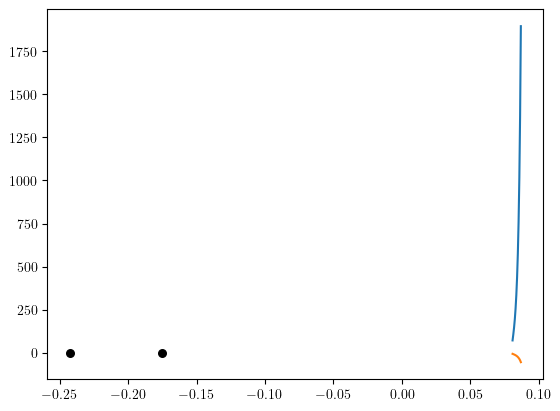

/tmp/ipykernel_50200/2332008755.py:93: RuntimeWarning: invalid value encountered in sqrt
  return 1/(Gamma*delta+prec2*k*w*x)*(w**prec2*x-np.sqrt(w**4*x**prec2-(prec2*k*w*x+Gamma*delta)*(prec2*k*w*x**3-w*Gamma*x+Gamma*delta*x**prec2)))


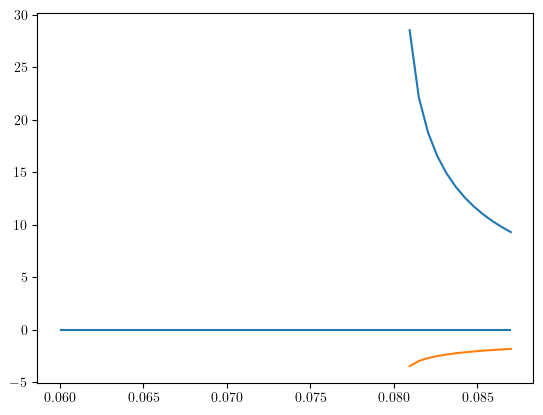

In [151]:
x_range = np.linspace(0.06,0.087)
plt.figure()
plt.plot(x_range,Fx_vec(x_range,wval,kval,dval,Gam,sgam,s=1))
plt.plot(x_range,Fx2_vec(x_range,wval,kval,dval,Gam,sgam,s=1))
# plt.scatter(points,np.zeros_like(points),s=20,color='green')
plt.scatter(xsol[ik,iw,id,:int(solution_number[ik,iw,id])],np.zeros_like(xsol[ik,iw,id,:int(solution_number[ik,iw,id])]),s=30,color='0')
# plt.hlines(0,x_range[0],x_range[-1])
plt.show()
plt.figure()
plt.plot(x_range,Fx_vec(x_range,wval,kval,dval,Gam,sgam,s=2))
plt.plot(x_range,Fx2_vec(x_range,wval,kval,dval,Gam,sgam,s=2))
# plt.scatter(xsol[ik,iw,id,:int(solution_number[ik,iw,id])],np.zeros_like(xsol[ik,iw,id,:int(solution_number[ik,iw,id])]),s=30,color='0')
plt.hlines(0,x_range[0],x_range[-1])
plt.show()

1.0 1.0 -5.0


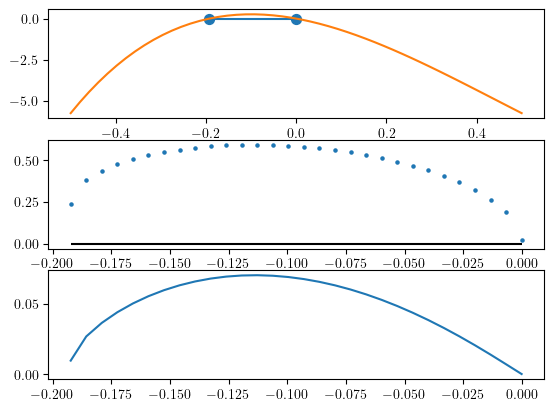

1.0 1.0 -1.6666666666666665


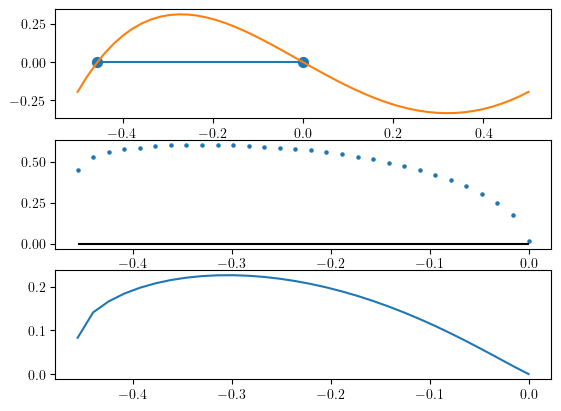

1.0 1.0 1.666666666666667


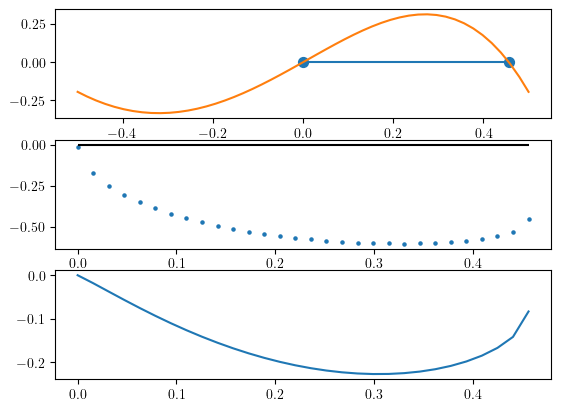

1.0 1.0 5.0


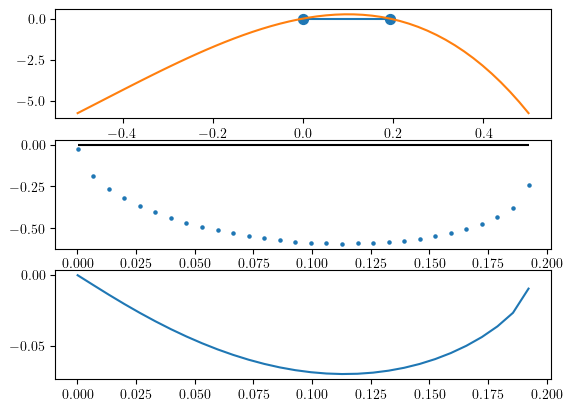

1.0 2.666666666666667 -5.0


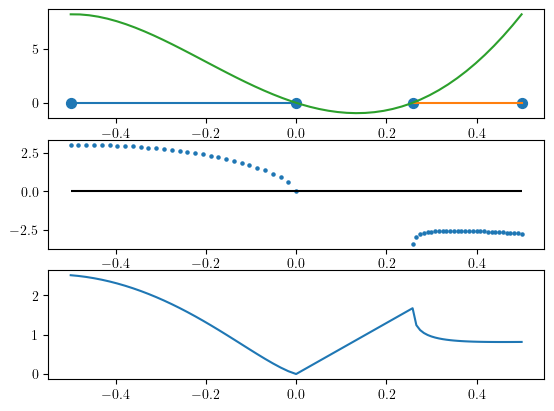

1.0 2.666666666666667 -1.6666666666666665


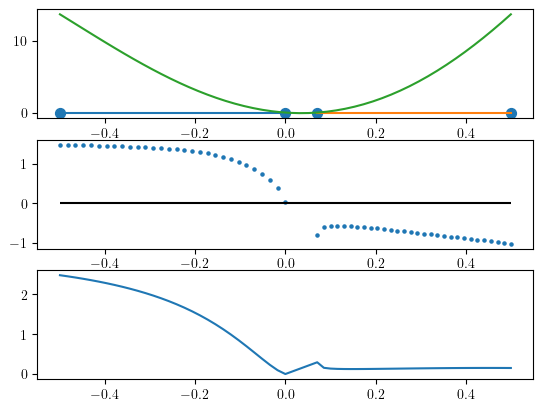

1.0 2.666666666666667 1.666666666666667


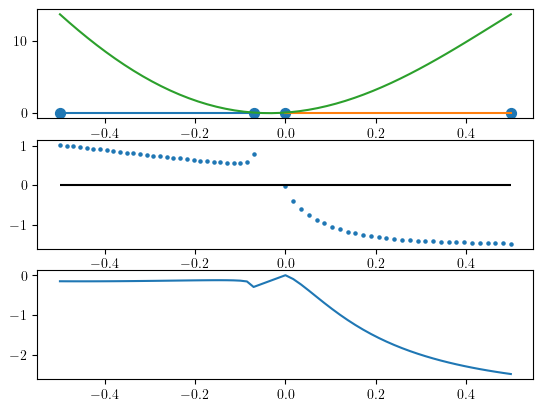

1.0 2.666666666666667 5.0


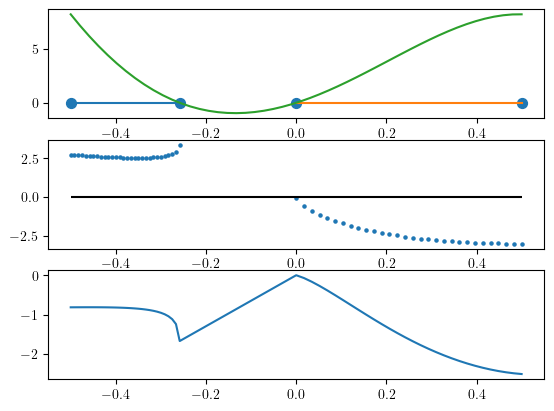

1.0 4.333333333333334 -5.0


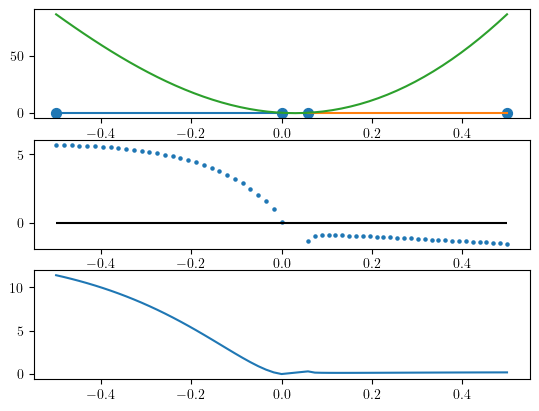

1.0 4.333333333333334 -1.6666666666666665


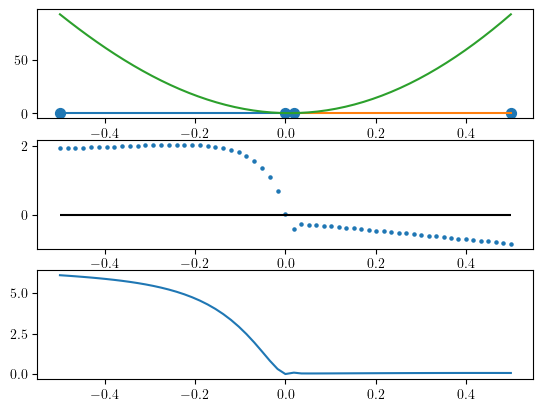

1.0 4.333333333333334 1.666666666666667


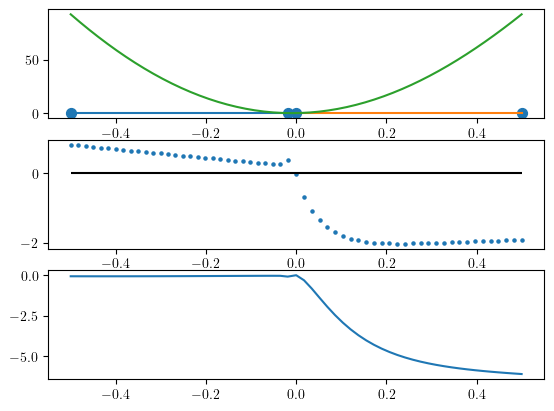

1.0 4.333333333333334 5.0


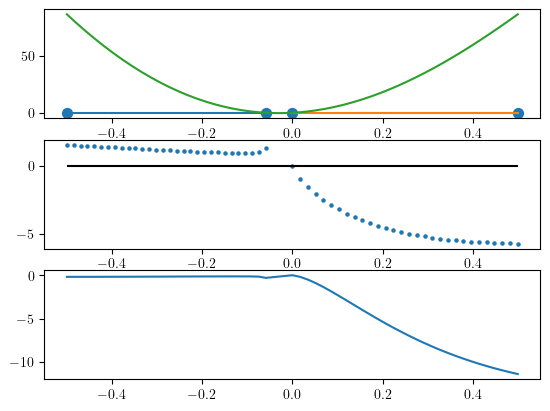

1.0 6.0 -5.0


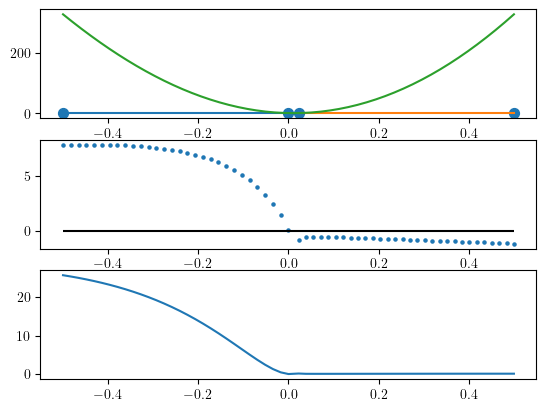

1.0 6.0 -1.6666666666666665


InvalidOperation: [<class 'decimal.InvalidOperation'>]

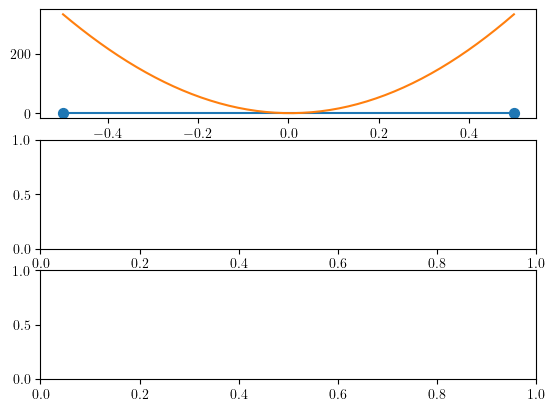

In [140]:
Gam = 1
sgam = 0.2
s =1
s =1
x_range = np.linspace(-0.5,0.5)
gridpoints = 4
k= np.linspace(1,10,gridpoints)
w = np.linspace(1,6,gridpoints)
d = np.linspace(-5,5,gridpoints)
xsol = np.ones((gridpoints,gridpoints,gridpoints,30))
# xgrid = np.linspace(-0.5-1/10**5,0.5+1/10**5,40)
solution_number = np.zeros((gridpoints,gridpoints,gridpoints))
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            # kval, wval,dval =1.0, 2+2/3, 1+2/3
            sol_numb = 0
            xgrid, points = set_xgird(wval,kval,dval,Gam,sgam,points=True)
            Func = np.zeros_like(xgrid)
            if xgrid[0]==-2:
                plt.figure()
                plt.plot(x_range,insq(x_range,wval,kval,dval,Gam,sgam))
                plt.show()
                continue
            # for j in range(len(xgrid)-1):
                
                # Fl = Fx(xgrid[j],wval,kval,dval,Gam,sgam,s)
                # Fu = Fx(xgrid[j+1],wval,kval,dval,Gam,sgam,s)
                # if Fl*Fu<=0:
                #     r = root_scalar(Fx,args=(wval,kval,dval,Gam,sgam,s),method='bisect',bracket=(xgrid[j],xgrid[j+1]))
                #     xsol[ik,iw,id,sol_numb] = r.root
                #     sol_numb+=1
            solution_number[ik,iw,id]=sol_numb
            # if sol_numb==0:
            print(kval,wval,dval)
            # print(-Gam*dval/(2*kval*wval))
            # print(xgrid)
            fig, ax = plt.subplots(3,1)
            for n in range(3):
                if n==1:
                    Func  = np.zeros_like(xgrid)
                    for i,x in enumerate(xgrid):
                        # print(insq_preci(x,wval,kval,dval,Gam,sgam))
                        if dval>=0:
                            Func[i]=Fx2(x,wval,kval,dval,Gam,sgam,1)
                        else:
                            Func[i]=Fx2(x,wval,kval,dval,Gam,sgam,2)
                elif n==0:
                    Func  = np.zeros_like(x_range)
                    for i,x in enumerate(x_range):
                        Func[i]=insq(x,wval,kval,dval,Gam,sgam)
                else:
                    Func1  = np.zeros_like(xgrid)
                    Func2 = np.zeros_like(xgrid)
                    Func3 = np.zeros_like(xgrid)
                    if dval>=0:
                        for i,x in enumerate(xgrid):
                        # print(insq_preci(x,wval,kval,dval,Gam,sgam))
                        # Func2[i]=num(x,wval,kval,dval,Gam,sgam)
                            y =y1ofx(x,wval,kval,dval,Gam,sgam)
                            Func1[i]=Fx(x,wval,kval,dval,Gam,sgam,1)*Decimal(x)
                            Func2[i]=Fx2(x,wval,kval,dval,Gam,sgam,1)*y
                            Func3[i]=eq(x,wval,kval,dval,Gam,sgam,1)
                    else:
                        for i,x in enumerate(xgrid):
                            y = y2ofx(x,wval,kval,dval,Gam,sgam)
                            Func1[i]=Fx(x,wval,kval,dval,Gam,sgam,2)*Decimal(x)
                            Func2[i]=Fx2(x,wval,kval,dval,Gam,sgam,2)*y
                            Func3[i]=eq(x,wval,kval,dval,Gam,sgam,2)
                for j in range(len(points)):
                    if j%2==0 and n==0:
                        ax[n].plot(points[j:j+2],np.zeros_like(points[j:j+2]))
                if n==0:
                    ax[n].scatter(points,np.zeros_like(points),s=50)    
                    ax[n].plot(x_range,Func)
                elif n ==1:
                    ax[n].scatter(xgrid,Func,s=5)
                    # ax[n].plot(xgrid,Func2)
                    ax[n].hlines(0,xgrid[0],xgrid[-1],color='0')
                else:
                    ax[n].plot(xgrid,Func1)
                    # ax[n].plot(xgrid,Func3)
                    # ax[n].scatter(points,np.zeros_like(points),s=50)  
                # if n==0:
                #     print(Func,wval)
            # for soli in range(sol_numb):
            #     ax[-2].scatter(xsol[ik,iw,id,soli],0,s=20,color="0")
                
            plt.show()
            # break
        # break
    # break
            

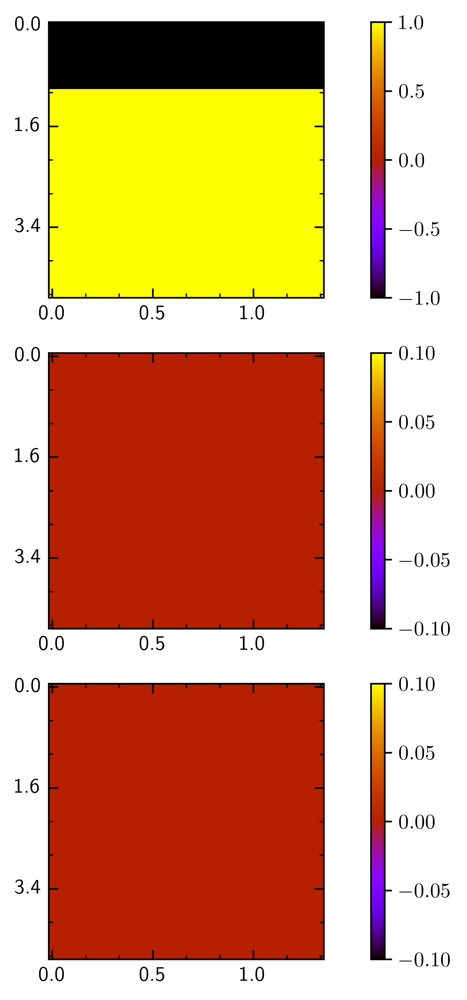

In [49]:
eigenvals = np.zeros((gridpoints,gridpoints,3))
for ik, kval in enumerate(k):
    for id, dval in enumerate(d):
        for j in range(1):#solution_number[ik,0,id]):
            x=xsol[ik,0,id,j]
            y = ysol[ik,0,id,j]
            z = m_z(x,y,w[0],kval,Gam)
            jac = jac_gl_np(0,np.array([0,0,1/2]),0,kval,dval,Gam,sgam)
            eigenvalues, trash = np.linalg.eig(jac)
            eigenvals[ik,id,j] = np.max(np.real(eigenvalues))
        # eigenvals[ik,id,solution_number[ik,0,id]:] = np.nan
            


tickformat = Format(xscale=w,yscale=k,xprec="{:.1f}",yprec="{:.1f}")
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=15,\
                        xtick_step_minor=5,\
                            ytick_step_major=15,\
                                ytick_step_minor=5)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp,formater=tickformat)
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
setup.DEFAULT_HEAT_EXTEND = (-0.5,64.5,39.5,-0.5)
fig, ax = setup.return_fig(shape=(3,1),dots_per_inch=600)
plots = [eigenvals[:,:,0],eigenvals[:,:,1],eigenvals[:,:,2]]
for i in range(3):
    im = ax[i].imshow(np.sign(plots[i]),cmap='gnuplot')#,extent=(-0.5,64.5,39.5,-0.5))
    cbar = fig.colorbar(im,ax=ax[i],orientation='vertical')
plt.show()




In [8]:
stability = np.load('4.4k13_1.5w5.5_3d/stability.npy')
stability_plus = np.load('4.4k13_1.5w5.5_3d/stability_plus.npy')

In [9]:
def dif(a,b):
    return np.linalg.norm(a-b)
dif = np.frompyfunc(dif,nin=2,nout=1)
a = np.array([[1,2],[12.3,14.8]])
b = list(a.T)
def dist(a):
    l = list(a.T)
    distance = []
    if len(l)==2:
        return [np.linalg.norm(l[0]-l[1])]
    else:
        for i in range(1,len(l)):
            distance.append(np.linalg.norm(l[0]-l[i]))
        distance.extend(dist(np.array(l[1:]).T))
        return distance
        




1.0 1.0
[[[-0.01892628  0.03165128  0.06522394]
  [-0.021265    0.03194245  0.06572248]
  [-0.02190268  0.031106    0.06503487]
  ...
  [-0.02190268  0.031106    0.06503487]
  [-0.021265    0.03194245  0.06572248]
  [-0.01892628  0.03165128  0.06522394]]

 [[-0.02434086  0.03392335  0.06824137]
  [-0.02126677  0.03175404  0.06562638]
  [-0.02307342  0.03118483  0.06568148]
  ...
  [-0.02307342  0.03118483  0.06568148]
  [-0.02126677  0.03175404  0.06562638]
  [-0.02434086  0.03392335  0.06824137]]

 [[-0.02168115  0.03184286  0.06614477]
  [-0.02395249  0.03170998  0.06664405]
  [-0.02416389  0.03104124  0.0662713 ]
  ...
  [-0.02416389  0.03104124  0.0662713 ]
  [-0.02395249  0.03170998  0.06664405]
  [-0.02168115  0.03184286  0.06614477]]

 ...

 [[-0.20476225  0.0055618   0.05680349]
  [-0.20123047  0.0021008   0.05454891]
  [-0.19762729 -0.00130688  0.0523512 ]
  ...
  [-0.19762729 -0.00130688  0.0523512 ]
  [-0.20123047  0.0021008   0.05454891]
  [-0.20476225  0.0055618   0.056803

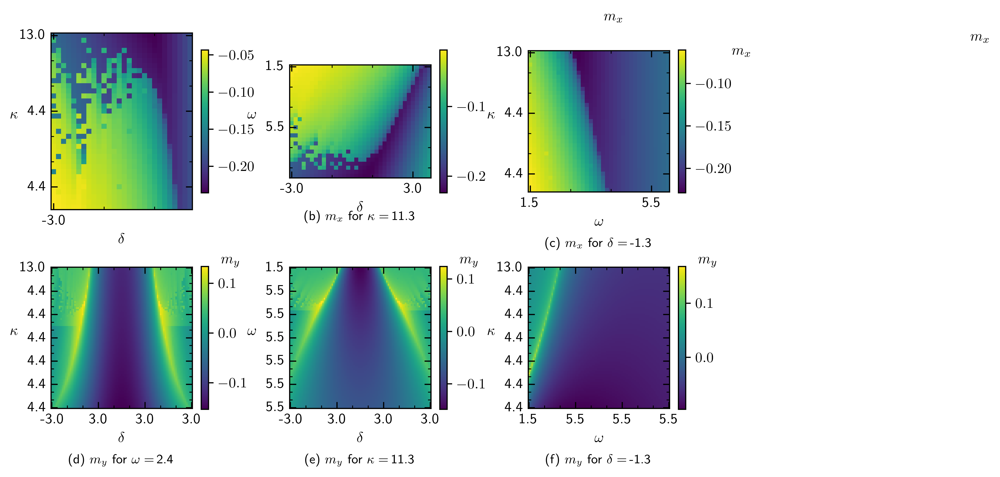

In [10]:
# stab_zsol = np.ones_like(solution_number)*np.nan
# stab_xsol = np.ones_like(solution_number)*np.nan
# stab_ysol = np.ones_like(solution_number)*np.nan
# for ik, kval in enumerate(k):
#     for iw, wval in enumerate(w):
#         for id, dval in enumerate(d):
#             if stability_plus[ik,iw,id]:
#                 # print(kval,wval,dval)
#                 for n in range(int(solution_number[ik,iw,id])):
#                     if stability[ik,iw,id,n]==2:
#                         stab_xsol[ik,iw,id]=xsol[ik,iw,id,n]
#                         stab_ysol[ik,iw,id] = ysol[ik,iw,id,n]
#                         stab_zsol[ik,iw,id] = m_z(xsol[ik,iw,id,n],ysol[ik,iw,id,n],wval,kval,Gam)
#                         break
                # zsol[ik,iw,id,int(solution_number[ik,iw,id]):] = np.nan
                # ysol[ik,iw,id,int(solution_number[ik,iw,id]):] = np.nan
                # xsol[ik,iw,id,int(solution_number[ik,iw,id]):] = np.nan
            # if dval==0:
            #     xsol[ik,iw,id,:int(solution_number[ik,iw,id])] = 0
                # m_mod[ik,iw,ik,n]=np.sqrt(x**2+y**2+z**2)
k_cut = 72
w_cut = 20
d_cut = 25
from random import random
def starting_points(numb):
    points = np.zeros((numb,3))
    for i in range(numb):
        phi = random()*2*np.pi
        theta = random()*np.pi
        r = random()*0.5
        points[i,:] = r*np.sin(theta)*np.cos(phi), r*np.sin(theta)*np.sin(phi), r*np.cos(theta)
    return points


k_cutarray2 = np.load('4.4k13_1.5w5.5_3d/k_cutarray2.npy')
w_cutarray2 = np.load('4.4k13_1.5w5.5_3d/w_cutarray2.npy')
d_cutarray2 = np.load('4.4k13_1.5w5.5_3d/d_cutarray2.npy')
k_cutarray3 = np.load('4.4k13_1.5w5.5_3d/k_cutarray4.npy')
w_cutarray3 = np.load('4.4k13_1.5w5.5_3d/w_cutarray4.npy')
d_cutarray3 = np.load('4.4k13_1.5w5.5_3d/d_cutarray4.npy')
# result = po.imap(endp_wrapper,range(gridpoints**2),chunksize=100)
# for index, res in enumerate(result):
#     i , j = index//gridpoints, index%gridpoints
#     k_cutarray[k_cut,i,j], w_cutarray[i,w_cut,j], d_cutarray[i,j,d_cut] = res
def dif(a,b):
    return np.linalg.norm(a-b)
# testrange = 6
def count_cycles(m):
    number_c = m.shape[1]
    difference = dist(m)
    # print(difference)
    indices = []
    for i in range(m.shape[1]):
        indices.extend(range(i,m.shape[1]-1))
    indices[-1]=m.shape[1]-1
    if np.all(m[:,1]==0):
        return 1, m[:,0]
    for diff in difference:
        if diff<1/10**4:
            number_c-=1
    return max(number_c,1), m[:,indices[difference.index(min(difference))]]


k_cutarray = np.zeros((k_cutarray2.shape[0],k_cutarray2.shape[0],3))
w_cutarray = np.zeros_like(k_cutarray)
d_cutarray = np.zeros_like(k_cutarray)
numberc_k = np.zeros((k_cutarray2.shape[0],k_cutarray2.shape[0]))
numberc_w = np.zeros_like(numberc_k)
numberc_d = np.zeros_like(numberc_k)


def draw_border_kcut(i,j,l,k_cut):
    return (stability_plus[k_cut,max(0,min(gridpoints-1,i+(-1+2*l))),j]+stability_plus[k_cut,i,j]==1) or (stability_plus[k_cut,i,max(0,min(gridpoints-1,j+(-1+2*l)))]+stability_plus[k_cut,i,j]==1)
def draw_border_wcut(i,j,l,w_cut):
    return (stability_plus[max(0,min(gridpoints-1,i+(-1+2*l))),w_cut,j]+stability_plus[i,w_cut,j]==1) or (stability_plus[i,w_cut,max(0,min(gridpoints-1,j+(-1+2*l)))]+stability_plus[i,w_cut,j]==1)

def draw_border_dcut(i,j,l,d_cut):
    return (stability_plus[max(0,min(gridpoints-1,i+(-1+2*l))),j,d_cut]+stability_plus[i,j,d_cut]==1) or (stability_plus[i,max(0,min(gridpoints-1,j+(-1+2*l))),d_cut]+stability_plus[i,j,d_cut]==1)

border_kcut = np.zeros((gridpoints,gridpoints))
border_wcut = np.zeros_like(border_kcut)
border_dcut = np.zeros_like(border_kcut)

for i in range(gridpoints):
    for j in range(gridpoints):
        if draw_border_kcut(i,j,0,k_cut):
            border_kcut[i,j]=1
        if draw_border_wcut(i,j,0,w_cut):
            border_wcut[i,j] =1   #.append([k[i],d[j]])
        if draw_border_dcut(i,j,0,d_cut):
            border_dcut[i,j]=1     #.append([k[i],w[j]])

for i in range(k_cutarray2.shape[0]):
    for j in range(k_cutarray.shape[0]):
        if stability_plus[k_cut,i,j]==0 and w[i]<=2.73 and d[j]<0:
            numberc_k[i,j], k_cutarray[i,j,:] = count_cycles(k_cutarray3[i,j])
        else:
            numberc_k[i,j], k_cutarray[i,j,:] = count_cycles(k_cutarray2[i,j])
            if d[j]>0:
                numberc_k[i,j], k_cutarray[i,j,:]= numberc_k[i,len(d)-1-j], k_cutarray[i,len(d)-1-j,:]
        if stability_plus[i,w_cut,j]==0 and k[i]>9.4 and d[j]<0:
            numberc_w[i,j], w_cutarray[i,j,:] = count_cycles(w_cutarray3[i,j])
        else:
            numberc_w[i,j], w_cutarray[i,j,:] = count_cycles(w_cutarray2[i,j])
            if d[j]>0:
                numberc_w[i,j], w_cutarray[i,j,:]= numberc_w[i,len(d)-1-j], w_cutarray[i,len(d)-1-j,:]
        numberc_d[i,j], d_cutarray[i,j,:] = count_cycles(d_cutarray3[i,j])
   
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png')
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
setup.DEFAULT_HEAT_EXTEND =  (-0.5,64.5,39.5,-0.5)#im1.get_extent()#
fig, ax = setup.return_fig(shape=(2,3),dots_per_inch=600)


# plots = [stab_xsol,stab_ysol,stab_zsol]
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=30,\
                        xtick_step_minor=10,\
                            ytick_step_major=15,\
                                ytick_step_minor=5)
trash, xw, yw, trash=(-0.5,39.5,29.5,-0.5)#im1.get_extent()#
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step
print(numb_xticks,numb_yticks)

# plots = [m_mod[30,:,:,0],m_mod[30,:,:,1],m_mod[30,:,:,2]]
blocksize =35
plots = [[w_cutarray[gridpoints-35:,:28,0],k_cutarray[:28,:35,0],d_cutarray[gridpoints-blocksize:,:blocksize,0]],[w_cutarray[::-1,:,1],k_cutarray[:,:,1],d_cutarray[::-1,:,1]]]
title = [[r'(a) $m_x$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(b) $m_x$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(c) $m_x$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])],[r'(d) $m_y$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(e) $m_y$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(f) $m_y$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])]]
cbar_label = [r'$m_x$',r'$m_y$']
colormap = 'viridis'
print(k_cutarray)
for i in range(2):
        im1=ax[i,0].imshow(plots[i][0],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
        cbar1 = fig.colorbar(im1,ax=ax[i,0],orientation='vertical',shrink=0.33)
        tickformat1 = Format(xscale=d,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[i,0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
        ax[i,0].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[i,0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[i,0].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[i,0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[i,0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
        # cbar1.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-5)
        ax[i,0].text(x=109,y=-3,s=cbar_label[i])
        ax[i,0].set_xlabel(r'$\delta$')
        ax[i,0].set_ylabel(r"$\kappa$",rotation=0)
        ax[i,0].set_title(title[i][0],loc='center',y=-0.45,fontsize=9)
        im2 = ax[i,1].imshow(plots[i][1],cmap=colormap)
        cbar2 = fig.colorbar(im2,ax=ax[i,1],orientation='vertical',shrink=0.33)
        tickformat2 = Format(xscale=d,yscale=w,xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[i,1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formatx0))
        ax[i,1].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[i,1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[i,1].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[i,1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[i,1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formaty1)) 
        # cbar2.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-10)
        ax[i,1].text(x=109,y=-3,s=cbar_label[i])
        ax[i,1].set_ylabel(r'$\omega$',rotation=0,labelpad=10)
        ax[i,1].set_xlabel(r'$\delta$')
        ax[i,1].set_title(title[i][1],loc='center',y=-0.45,fontsize=9)
        im3 = ax[i,2].imshow(plots[i][2],cmap=colormap)
        cbar3 = fig.colorbar(im3,ax=ax[i,2],orientation='vertical',shrink=0.33)
        tickformat3 = Format(xscale=w,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[i,2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formatx0))
        ax[i,2].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[i,2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[i,2].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[i,2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[i,2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formaty1)) 
        # cbar3.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-13)
        ax[i,2].text(x=109,y=-3,s=cbar_label[i])
        ax[i,2].set_xlabel(r'$\omega$')
        ax[i,2].set_ylabel(r'$\kappa$',rotation=0)
        ax[i,2].set_title(title[i][2],loc='center',y=-0.45,fontsize=9)
plt.subplots_adjust(hspace=-0.5,wspace=0.35)
plt.show()
# for i in range(k.shape[0]):
#     for j in range(w.shape[0]):
#         if solution_number[14,i,j]==0:
#             print(k[14],w[i],d[j])
# print('')
# for i in range(k.shape[0]):
#     for j in range(w.shape[0]):
#         if solution_number[i,5,j]==2:
#             print(k[i],w[5],d[j])
# print(w[9])
# for i in range(k.shape[0]):
#     for j in range(w.shape[0]):
#         for l in range(d.shape[0]):
#             # if solution_number[i,9,j]==0:
#             if isclose(k[i],5.235294117647059,rel_tol=1e-4,abs_tol=1/10**4) and isclose(w[j],2.3235294117647056,rel_tol=1e-4,abs_tol=1/10**4) and isclose(d[l],4.117647058823529,rel_tol=1e-4,abs_tol=1/10**4):
#                 print(k[i],w[9],d[j],i,j,l)

# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'stable_fixp_extended2.png',bbox_inches='tight')



3.0 6.0
(114, 2)
(array([ 2.01292453e+00,  7.02483987e-01, -2.57345788e-02,  1.03854858e-03,
       -2.68730323e-05,  3.96232598e-07, -3.02878125e-09,  9.28913250e-12]), array([[ 5.27191390e-02, -1.91129613e-02,  2.16431621e-03,
        -1.11502017e-04,  2.99542877e-06, -4.34733390e-08,
         3.22984170e-10, -9.62918205e-13],
       [-1.91129613e-02,  9.80703660e-03, -1.26905628e-03,
         7.02142414e-05, -1.97213655e-06,  2.95074700e-08,
        -2.24140100e-10,  6.79599762e-13],
       [ 2.16431621e-03, -1.26905628e-03,  1.76115600e-04,
        -1.01773560e-05,  2.94482461e-07, -4.50242759e-09,
         3.47678197e-11, -1.06789648e-13],
       [-1.11502017e-04,  7.02142414e-05, -1.01773560e-05,
         6.05814479e-07, -1.79105985e-08,  2.78355672e-10,
        -2.17728333e-12,  6.75731906e-15],
       [ 2.99542877e-06, -1.97213655e-06,  2.94482461e-07,
        -1.79105985e-08,  5.38237022e-10, -8.47299083e-12,
         6.69652498e-14, -2.09612545e-16],
       [-4.34733390e-08, 

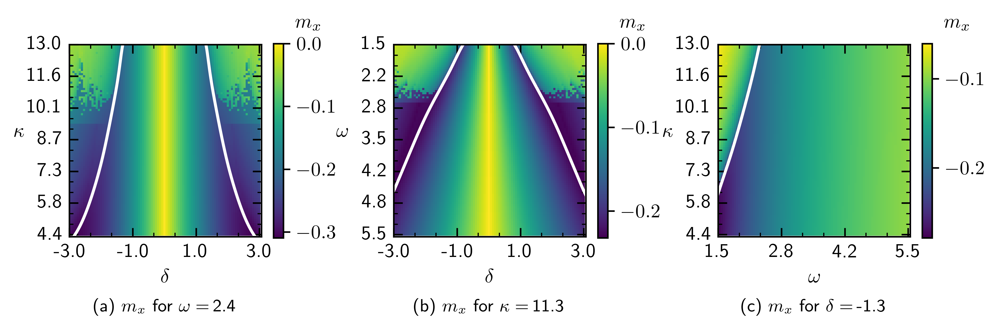

In [14]:
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png')
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
# im1=ax[0].imshow(plots[i][0],cmap=colormap)
setup.DEFAULT_HEAT_EXTEND =  im1.get_extent()#(-0.5,64.5,39.5,-0.5)#
fig, ax = setup.return_fig(shape=(1,3),dots_per_inch=600)


# plots = [stab_xsol,stab_ysol,stab_zsol]
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=30,\
                        xtick_step_minor=10,\
                            ytick_step_major=15,\
                                ytick_step_minor=5)
trash, xw, yw, trash=im1.get_extent()#(-0.5,39.5,29.5,-0.5)#
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step
print(numb_xticks,numb_yticks)


def draw_border_kcut(i,j,l,k_cut):
    return (stability_plus[k_cut,max(0,min(gridpoints-1,i+(-1+2*l))),j]+stability_plus[k_cut,i,j]==1) or (stability_plus[k_cut,i,max(0,min(gridpoints-1,j+(-1+2*l)))]+stability_plus[k_cut,i,j]==1)
def draw_border_wcut(i,j,l,w_cut):
    return (stability_plus[max(0,min(gridpoints-1,i+(-1+2*l))),w_cut,j]+stability_plus[i,w_cut,j]==1) or (stability_plus[i,w_cut,max(0,min(gridpoints-1,j+(-1+2*l)))]+stability_plus[i,w_cut,j]==1)

def draw_border_dcut(i,j,l,d_cut):
    return (stability_plus[max(0,min(gridpoints-1,i+(-1+2*l))),j,d_cut]+stability_plus[i,j,d_cut]==1) or (stability_plus[i,max(0,min(gridpoints-1,j+(-1+2*l))),d_cut]+stability_plus[i,j,d_cut]==1)

border_kcut = np.zeros((gridpoints,gridpoints))
border_wcut = np.zeros_like(border_kcut)
border_dcut = np.zeros_like(border_kcut)
borderpoints = []
borderpointsk = []
borderpointsd = []
for i in range(gridpoints):
    for j in range(gridpoints):
        if draw_border_kcut(i,j,0,k_cut) and j<45:
            border_kcut[i,j]=1
            borderpointsk.append([i,j])
        if draw_border_wcut(i,j,0,w_cut) and j<45:
            borderpoints.append([i,j])
            border_wcut[i,j] =1   #.append([k[i],d[j]])
            # break 
        if draw_border_dcut(i,j,0,d_cut):
            border_dcut[i,j]=1 
            borderpointsd.append([i,j])
           #.append([k[i],w[j]])
borderpoints = np.array(borderpoints)
borderpointsk = np.array(borderpointsk)
borderpointsd = np.array(borderpointsd)
print(borderpoints.shape)
from scipy.optimize import curve_fit
def quintic(x,*a):
    res = 0
    for i in range(len(a)):
        res += a[i]*x**i
    return res
params = curve_fit(quintic,borderpoints[:,0],borderpoints[:,1],p0=np.zeros(8))
paramsk = curve_fit(quintic,borderpointsk[:,0],borderpointsk[:,1],p0=np.zeros(8))
paramsd = curve_fit(quintic,borderpointsd[:,0],borderpointsd[:,1],p0=np.zeros(8))
print(params)
# plots = [m_mod[30,:,:,0],m_mod[30,:,:,1],m_mod[30,:,:,2]]
grid1d = np.linspace(0,91,200)
blocksize =35
plots = [[w_cutarray[::-1,:,0],k_cutarray[:,:,0],d_cutarray[::-1,:,0]],[w_cutarray[gridpoints-35:,:28,0],k_cutarray[:28,:35,0],d_cutarray[gridpoints-blocksize:,:blocksize,0]]]
title = [[r'(a) $m_x$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(b) $m_x$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(c) $m_x$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])],[r'(d) $m_y$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(e) $m_y$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(f) $m_y$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])]]
cbar_label = [r'$m_x$',r'$m_y$']
colormap = 'viridis'
print(k_cutarray)
for i in range(1):
        im1=ax[0].imshow(plots[i][0],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
        cbar1 = fig.colorbar(im1,ax=ax[0],orientation='vertical',shrink=0.22)
        tickformat1 = Format(xscale=d,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
        ax[0].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[0].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
        ax[0].plot(quintic(grid1d[:],*params[0]),grid1d[::-1],color='1')
        ax[0].plot(90-quintic(grid1d[:],*params[0]),grid1d[::-1],color='1')
        ax[0].set_ylim(91,0)
        ax[0].set_xlim(0,91)
        # ax[0].plot(borderpoints[:,1],borderpoints[::-1,0],color='red',linewidth=1)
        # cbar1.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-5)
        ax[0].text(x=107,y=-8,s=cbar_label[i])
        ax[0].set_xlabel(r'$\delta$')
        ax[0].set_ylabel(r"$\kappa$",rotation=0)
        ax[0].set_title(title[i][0],loc='center',y=-0.45,fontsize=9)
        im2 = ax[1].imshow(plots[i][1],cmap=colormap)
        cbar2 = fig.colorbar(im2,ax=ax[1],orientation='vertical',shrink=0.22)
        tickformat2 = Format(xscale=d,yscale=w,xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formatx0))
        ax[1].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[1].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formaty1)) 
        ax[1].plot(quintic(grid1d[:],*paramsk[0]),grid1d[:],color='1')
        ax[1].plot(90-quintic(grid1d[:],*paramsk[0]),grid1d[:],color='1')
        ax[1].set_ylim(91,0)
        ax[1].set_xlim(0,91)
        # cbar2.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-10)
        ax[1].text(x=107,y=-8,s=cbar_label[i])
        ax[1].set_ylabel(r'$\omega$',rotation=0,labelpad=10)
        ax[1].set_xlabel(r'$\delta$')
        ax[1].set_title(title[i][1],loc='center',y=-0.45,fontsize=9)
        im3 = ax[2].imshow(plots[i][2],cmap=colormap)
        cbar3 = fig.colorbar(im3,ax=ax[2],orientation='vertical',shrink=0.22)
        tickformat3 = Format(xscale=w,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formatx0))
        ax[2].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[2].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formaty1)) 
        ax[2].plot(quintic(grid1d[:],*paramsd[0]),grid1d[::-1],color='1')
        # ax[2].plot(90-quintic(grid1d[:],*params[0]),grid1d[::-1],color='1')
        ax[2].set_ylim(91,0)
        ax[2].set_xlim(0,91)
        # cbar3.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-13)
        ax[2].text(x=107,y=-8,s=cbar_label[i])
        ax[2].set_xlabel(r'$\omega$')
        ax[2].set_ylabel(r'$\kappa$',rotation=0)
        ax[2].set_title(title[i][2],loc='center',y=-0.45,fontsize=9)
plt.subplots_adjust(hspace=-0.5,wspace=0.35)
plt.show()

1.0 1.0
(114, 2)
(-0.5, 34.5, 34.5, -0.5)
3.0 3.0


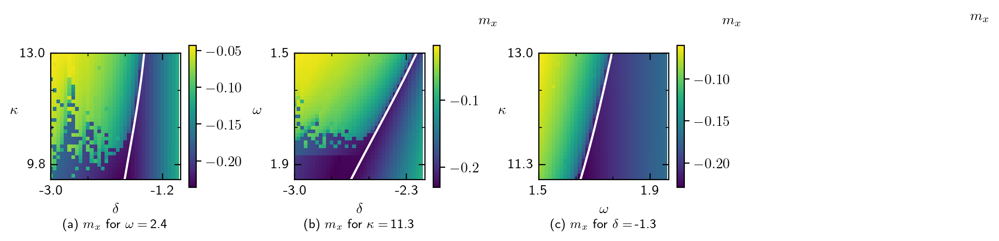

In [15]:
setup = Setup_Fig(name_of_plot='')
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
setup.DEFAULT_HEAT_EXTEND =  (-0.5,34.5,34.5,-0.5)#im1.get_extent()#
fig, ax = setup.return_fig(shape=(1,3),dots_per_inch=200)
# fig, ax = plt.subplots(1,3)

# plots = [stab_xsol,stab_ysol,stab_zsol]
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=30,\
                        xtick_step_minor=10,\
                            ytick_step_major=30,\
                                ytick_step_minor=10)
trash, xw, yw, trash= setup.DEFAULT_HEAT_EXTEND
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step
print(numb_xticks,numb_yticks)
borderpointsw2 = []
borderpointsk2 = []
borderpointsd2 = []
for i in range(35):
    for j in range(35):
        if draw_border_kcut(i,j,0,k_cut) and j<45:
            border_kcut[i,j]=1
            borderpointsk2.append([i,j])
for i in range(35):
    for j in range(35):
        if draw_border_wcut(gridpoints-35+i,j,0,w_cut) and j<45:
            borderpointsw2.append([i,j])
            border_wcut[i,j] =1   #.append([k[i],d[j]])
            # break 
for i in range(35):
    for j in range(35):
        if draw_border_dcut(gridpoints-35+i,j,0,d_cut):
            border_dcut[i,j]=1 
            borderpointsd2.append([i,j])
           #.append([k[i],w[j]])
borderpointsw2 = np.array(borderpointsw2)
borderpointsk2= np.array(borderpointsk2)
borderpointsd2 = np.array(borderpointsd2)
print(borderpoints.shape)
from scipy.optimize import curve_fit
def quintic(x,*a):
    res = 0
    for i in range(len(a)):
        res += a[i]*x**i
    return res
paramsw2 = curve_fit(quintic,borderpointsw2[:,0],borderpointsw2[:,1],p0=np.zeros(4))
paramsk2 = curve_fit(quintic,borderpointsk2[:,0],borderpointsk2[:,1],p0=np.zeros(4))
paramsd2 = curve_fit(quintic,borderpointsd2[:,0],borderpointsd2[:,1],p0=np.zeros(4))
grid2 = np.linspace(0,35,100)
# plots = [m_mod[30,:,:,0],m_mod[30,:,:,1],m_mod[30,:,:,2]]
blocksize =35
plots = [[w_cutarray[gridpoints-35:,:35,0],k_cutarray[:35,:35,0],d_cutarray[gridpoints-35:,:35,0]],[w_cutarray[::-1,:,1],k_cutarray[:,:,1],d_cutarray[::-1,:,1]]]
title = [[r'(a) $m_x$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(b) $m_x$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(c) $m_x$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])],[r'(d) $m_y$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(e) $m_y$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(f) $m_y$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])]]
cbar_label = [r'$m_x$',r'$m_y$']
colormap = 'viridis'
# print(k_cutarray)
for i in range(1):
        im1=ax[0].imshow(plots[i][0][::-1,:],cmap=colormap)#,extent=im1.get_extent())
        # im1 = ax[0].contourf(d[:28],k[gridpoints-35:],w_cutarray[gridpoints-35:,:28,0])
        cbar1 = fig.colorbar(im1,ax=ax[0],orientation='vertical',shrink=0.22)
        tickformat1 = Format(xscale=d[:28],yscale=k[gridpoints-35:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
        ax[0].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[0].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
        ax[0].plot((quintic(grid2[:],*paramsw2[0])),grid2[::-1],color='1')
        # ax[0].plot(borderpointsw2[:,1],borderpointsw2[::-1,0],color='red',linewidth=1)

        ax[0].set_ylim(34,0)
        ax[0].set_xlim(0,35)
        ax[0].text(x=115,y=-8,s=cbar_label[i])
        ax[0].set_xlabel(r'$\delta$')
        ax[0].set_ylabel(r"$\kappa$",rotation=0)
        ax[0].set_title(title[i][0],loc='center',y=-0.45,fontsize=9)
        print(im1.get_extent())

        trash, xw, yw, trash=im2.get_extent()#(-0.5,39.5,29.5,-0.5)#
        numb_xticks = xw//tickp.major_xtick_step
        numb_yticks = yw//tickp.major_ytick_step
        print(numb_xticks,numb_yticks)
        im2 = ax[1].imshow(plots[i][1],cmap=colormap)#,extent=im2.get_extent())
        # im2 = ax[1].contourf(d[:35],w[:28],k_cutarray[:28,:35,0])
        cbar2 = fig.colorbar(im2,ax=ax[1],orientation='vertical',shrink=0.22)
        tickformat2 = Format(xscale=d[:35],yscale=w[:28],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formatx0))
        ax[1].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[1].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formaty1)) 
        # cbar2.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-10)
        ax[1].plot(quintic(grid2[:],*paramsk2[0]),grid2[:],color='1')
        ax[1].set_ylim(34,0)
        ax[1].set_xlim(0,35)
        ax[1].text(x=115,y=-8,s=cbar_label[i])
        ax[1].set_ylabel(r'$\omega$',rotation=0,labelpad=10)
        ax[1].set_xlabel(r'$\delta$')
        ax[1].set_title(title[i][1],loc='center',y=-0.45,fontsize=9)
        im3 = ax[2].imshow(plots[i][2][::-1,:],cmap=colormap)#,extent=im3.get_extent())
        # im3 = ax[2].contourf(w[:28],k[gridpoints-35:],d_cutarray[gridpoints-35:,:28,0])
        cbar3 = fig.colorbar(im3,ax=ax[2],orientation='vertical',shrink=0.22)
        tickformat3 = Format(xscale=w[:28],yscale=k[gridpoints-55:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formatx0))
        ax[2].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[2].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formaty1)) 
        # cbar3.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-13)
        ax[2].plot(quintic(grid2[:],*paramsd2[0]),grid2[::-1],color='1')
        ax[2].set_ylim(34,0)
        ax[2].set_xlim(0,35)
        ax[2].text(x=116,y=-9,s=cbar_label[i])
        ax[2].set_xlabel(r'$\omega$')
        ax[2].set_ylabel(r'$\kappa$',rotation=0)
        ax[2].set_title(title[i][2],loc='center',y=-0.45,fontsize=9)
plt.subplots_adjust(wspace=0.5)
plt.show()

3.0 6.0
3.0 3.0
3.0 3.0


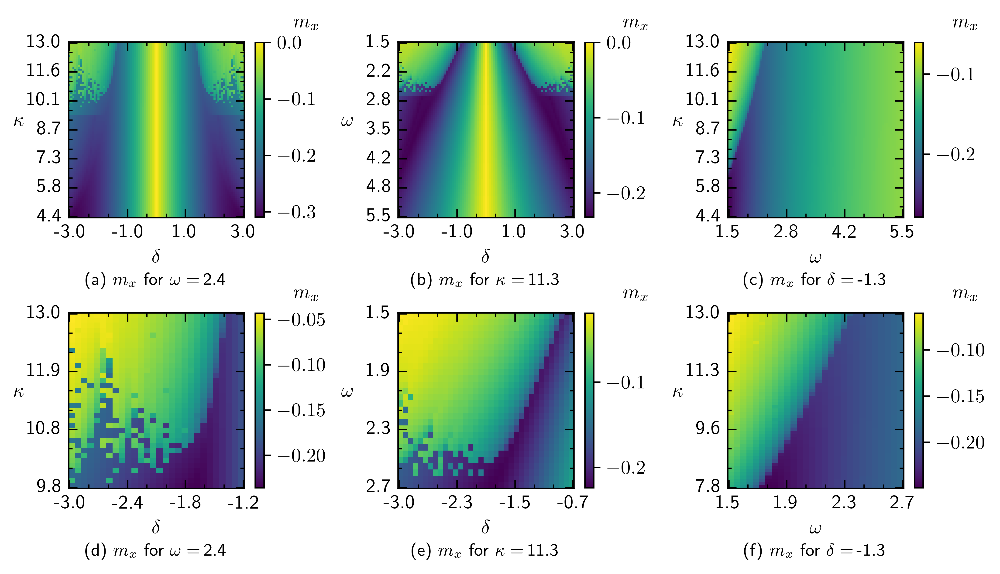

In [91]:
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png')
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
# im1=ax[0,0].imshow(plots[i][0],cmap=colormap)
setup.DEFAULT_HEAT_EXTEND =  im1.get_extent()#(-0.5,64.5,39.5,-0.5)#
fig, ax = setup.return_fig(shape=(2,3),dots_per_inch=600)


# plots = [stab_xsol,stab_ysol,stab_zsol]
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=30,\
                        xtick_step_minor=10,\
                            ytick_step_major=15,\
                                ytick_step_minor=5)
trash, xw, yw, trash=im1.get_extent()#(-0.5,39.5,29.5,-0.5)#
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step
print(numb_xticks,numb_yticks)

# plots = [m_mod[30,:,:,0],m_mod[30,:,:,1],m_mod[30,:,:,2]]
blocksize =35
plots = [[w_cutarray[::-1,:,0],k_cutarray[:,:,0],d_cutarray[::-1,:,0]],[w_cutarray[gridpoints-35:,:28,0],k_cutarray[:28,:35,0],d_cutarray[gridpoints-55:,:28,0]]]
title = [[r'(a) $m_x$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(b) $m_x$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(c) $m_x$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])],[r'(d) $m_x$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(e) $m_x$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(f) $m_x$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])]]
cbar_label = [r'$m_x$',r'$m_y$']
colormap = 'viridis'
labelshrink = 0.29
labelx= 116
labely=-8
# print(k_cutarray)
for i in range(1):
        im1=ax[0,0].imshow(plots[i][0],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
        cbar1 = fig.colorbar(im1,ax=ax[0,0],orientation='vertical',shrink=labelshrink)
        tickformat1 = Format(xscale=d,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[0,0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
        ax[0,0].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[0,0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[0,0].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[0,0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[0,0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
        # cbar1.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-5)
        ax[0,0].text(x=labelx,y=labely,s=cbar_label[i])
        ax[0,0].set_xlabel(r'$\delta$')
        ax[0,0].set_ylabel(r"$\kappa$",rotation=0)
        ax[0,0].set_title(title[i][0],loc='center',y=-0.45,fontsize=9)
        im2 = ax[0,1].imshow(plots[i][1],cmap=colormap)
        cbar2 = fig.colorbar(im2,ax=ax[0,1],orientation='vertical',shrink=labelshrink)
        tickformat2 = Format(xscale=d,yscale=w,xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[0,1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formatx0))
        ax[0,1].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[0,1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[0,1].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[0,1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[0,1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formaty1)) 
        # cbar2.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-10)
        ax[0,1].text(x=labelx,y=labely,s=cbar_label[i])
        ax[0,1].set_ylabel(r'$\omega$',rotation=0,labelpad=10)
        ax[0,1].set_xlabel(r'$\delta$')
        ax[0,1].set_title(title[i][1],loc='center',y=-0.45,fontsize=9)
        im3 = ax[0,2].imshow(plots[i][2],cmap=colormap)
        cbar3 = fig.colorbar(im3,ax=ax[0,2],orientation='vertical',shrink=labelshrink)
        tickformat3 = Format(xscale=w,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
        ax[0,2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formatx0))
        ax[0,2].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
        ax[0,2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
        ax[0,2].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
        ax[0,2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
        ax[0,2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formaty1)) 
        # cbar3.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-13)
        ax[0,2].text(x=labelx,y=labely,s=cbar_label[i])
        ax[0,2].set_xlabel(r'$\omega$')
        ax[0,2].set_ylabel(r'$\kappa$',rotation=0)
        ax[0,2].set_title(title[i][2],loc='center',y=-0.45,fontsize=9)


        tickp1 = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=30,\
                        xtick_step_minor=10,\
                            ytick_step_major=30,\
                                ytick_step_minor=10)
        trash, xw, yw, trash=im1.get_extent()#(-0.5,39.5,29.5,-0.5)#
        numb_xticks1 = xw//tickp1.major_xtick_step
        numb_yticks1 = yw//tickp1.major_ytick_step
        print(numb_xticks1,numb_yticks1)

        im1=ax[1,0].imshow(plots[1][0][::-1,:],cmap=colormap,extent=im1.get_extent())
        # im1 = ax[1,0].contourf(d[:28],k[gridpoints-35:],w_cutarray[gridpoints-35:,:28,0])
        cbar1 = fig.colorbar(im1,ax=ax[1,0],orientation='vertical',shrink=labelshrink)
        tickformat1 = Format(xscale=d[:28],yscale=k[gridpoints-35:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks1,numb_yticks=numb_yticks1)
        ax[1,0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
        ax[1,0].yaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_ytick_step))
        ax[1,0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_ytick_step))
        ax[1,0].xaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_xtick_step))
        ax[1,0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_xtick_step))
        ax[1,0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
        # cbar1.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-5)
        ax[1,0].text(x=labelx,y=labely,s=cbar_label[i])
        ax[1,0].set_xlabel(r'$\delta$')
        ax[1,0].set_ylabel(r"$\kappa$",rotation=0)
        ax[1,0].set_title(title[1][0],loc='center',y=-0.45,fontsize=9)


        trash, xw, yw, trash=im2.get_extent()#(-0.5,39.5,29.5,-0.5)#
        numb_xticks1 = xw//tickp1.major_xtick_step
        numb_yticks1 = yw//tickp1.major_ytick_step
        print(numb_xticks1,numb_yticks1)
        im2 = ax[1,1].imshow(plots[1][1],cmap=colormap,extent=im2.get_extent())
        # im2 = ax[1,1].contourf(d[:35],w[:28],k_cutarray[:28,:35,0])
        cbar2 = fig.colorbar(im2,ax=ax[1,1],orientation='vertical',shrink=labelshrink)
        tickformat2 = Format(xscale=d[:35],yscale=w[:28],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks1,numb_yticks=numb_yticks1)
        ax[1,1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formatx0))
        ax[1,1].yaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_ytick_step))
        ax[1,1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_ytick_step))
        ax[1,1].xaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_xtick_step))
        ax[1,1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_xtick_step))
        ax[1,1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formaty1)) 
        # cbar2.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-10)
        ax[1,1].text(x=labelx,y=labely,s=cbar_label[i])
        ax[1,1].set_ylabel(r'$\omega$',rotation=0,labelpad=10)
        ax[1,1].set_xlabel(r'$\delta$')
        ax[1,1].set_title(title[1][1],loc='center',y=-0.45,fontsize=9)
        im3 = ax[1,2].imshow(plots[1][2][::-1,:],cmap=colormap,extent=im3.get_extent())
        # im3 = ax[1,2].contourf(w[:28],k[gridpoints-35:],d_cutarray[gridpoints-35:,:28,0])
        cbar3 = fig.colorbar(im3,ax=ax[1,2],orientation='vertical',shrink=labelshrink)
        tickformat3 = Format(xscale=w[:28],yscale=k[gridpoints-55:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks1,numb_yticks=numb_yticks1)
        ax[1,2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formatx0))
        ax[1,2].yaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_ytick_step))
        ax[1,2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_ytick_step))
        ax[1,2].xaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_xtick_step))
        ax[1,2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_xtick_step))
        ax[1,2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formaty1)) 
        # cbar3.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-13)
        ax[1,2].text(x=labelx,y=labely,s=cbar_label[i])
        ax[1,2].set_xlabel(r'$\omega$')
        ax[1,2].set_ylabel(r'$\kappa$',rotation=0)
        ax[1,2].set_title(title[1][2],loc='center',y=-0.45,fontsize=9)
        
plt.subplots_adjust(wspace=0.5,hspace=-0.55)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'stable_fixp_extended2.png',bbox_inches='tight')
plt.show()


In [23]:
shrinklabel0 = 0.3
shrinklabel1 = 0.29
labelx0 = 108
labely0 = -9
labelx1 = 45
labely1 = -3
lstyle = (0, (5, 7))
linw = 0.7

3.0 3.0
3.0 3.0
(-0.5, 34.5, 34.5, -0.5)
3.0 3.0


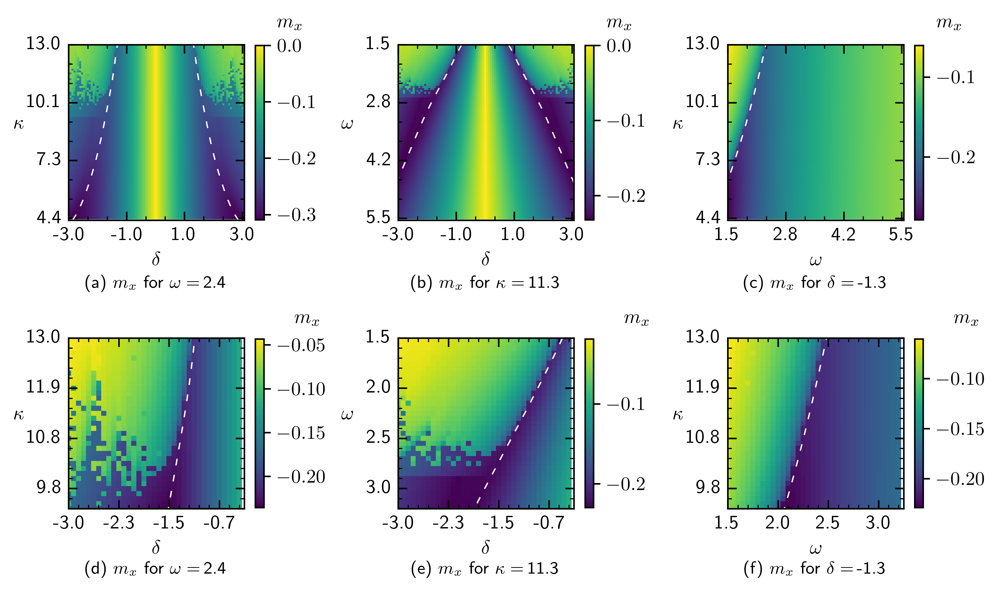

In [25]:
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png')
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
# im1=ax[0,0].imshow(plots[i][0],cmap=colormap)
setup.DEFAULT_HEAT_EXTEND =  im1.get_extent()#(-0.5,64.5,39.5,-0.5)#
fig, ax = setup.return_fig(shape=(2,3),dots_per_inch=600)


plots = [[w_cutarray[::-1,:,0],k_cutarray[:,:,0],d_cutarray[::-1,:,0]],[w_cutarray[gridpoints-35:,:35,0],k_cutarray[:35,:35,0],d_cutarray[gridpoints-35:,:35,0]]]
title = [[r'(a) $m_x$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(b) $m_x$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(c) $m_x$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])],[r'(d) $m_x$ for $\omega=$\,'+'{:.1f}'.format(w[w_cut]),r'(e) $m_x$ for $\kappa=$\,'+'{:.1f}'.format(k[k_cut]),r'(f) $m_x$ for $\delta=$\,'+'{:.1f}'.format(d[d_cut])]]
cbar_label = [r'$m_x$',r'$m_y$']
trash, xw, yw, trash=(-0.5,90.5,90.5,-0.5)#im21.get_extent()#
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step
print(numb_xticks,numb_yticks)
im10=ax[0,0].imshow(plots[0][0],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
cbar10 = fig.colorbar(im10,ax=ax[0,0],orientation='vertical',shrink = shrinklabel0)
tickformat10 = Format(xscale=d,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[0,0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat10.formatx0))
ax[0,0].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[0,0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[0,0].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[0,0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[0,0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat10.formaty1))
ax[0,0].plot(quintic(grid1d[:],*params[0]),grid1d[::-1],color='1',linewidth=linw,linestyle=lstyle)
ax[0,0].plot(90-quintic(grid1d[:],*params[0]),grid1d[::-1],color='1',linewidth=linw,linestyle=lstyle)
ax[0,0].set_ylim(91,0)
ax[0,0].set_xlim(0,91)
# ax[0,0].plot(borderpoints[:,1],borderpoints[::-1,0],color='red',linewidth=1)
# cbar1.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-5)
ax[0,0].text(labelx0,labely0,s=cbar_label[i])
ax[0,0].set_xlabel(r'$\delta$')
ax[0,0].set_ylabel(r"$\kappa$",rotation=0)
ax[0,0].set_title(title[0][0],loc='center',y=-0.45,fontsize=9)
im20 = ax[0,1].imshow(plots[0][1],cmap=colormap)
cbar2 = fig.colorbar(im20,ax=ax[0,1],orientation='vertical',shrink = shrinklabel0)
tickformat20 = Format(xscale=d,yscale=w,xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[0,1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat20.formatx0))
ax[0,1].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[0,1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[0,1].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[0,1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[0,1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat20.formaty1)) 
ax[0,1].plot(quintic(grid1d[:],*paramsk[0]),grid1d[:],color='1',linewidth=linw,linestyle=lstyle)
ax[0,1].plot(90-quintic(grid1d[:],*paramsk[0]),grid1d[:],color='1',linewidth=linw,linestyle=lstyle)
ax[0,1].set_ylim(91,0)
ax[0,1].set_xlim(0,91)
# cbar2.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-10)
ax[0,1].text(labelx0,labely0,s=cbar_label[i])
ax[0,1].set_ylabel(r'$\omega$',rotation=0,labelpad=10)
ax[0,1].set_xlabel(r'$\delta$')
ax[0,1].set_title(title[0][1],loc='center',y=-0.45,fontsize=9)
im30 = ax[0,2].imshow(plots[0][2],cmap=colormap)
cbar30 = fig.colorbar(im30,ax=ax[0,2],orientation='vertical',shrink = shrinklabel0)
tickformat30 = Format(xscale=w,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[0,2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat30.formatx0))
ax[0,2].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[0,2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[0,2].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[0,2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[0,2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat30.formaty1)) 
ax[0,2].plot(quintic(grid1d[:],*paramsd[0]),grid1d[::-1],color='1',linewidth=linw,linestyle=lstyle)
# ax[0,2].plot(90-quintic(grid1d[:],*params[0]),grid1d[::-1],color='1')
ax[0,2].set_ylim(91,0)
ax[0,2].set_xlim(0,91)
# cbar3.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-13)
ax[0,2].text(labelx0,labely0,s=cbar_label[i])
ax[0,2].set_xlabel(r'$\omega$')
ax[0,2].set_ylabel(r'$\kappa$',rotation=0)
ax[0,2].set_title(title[0][2],loc='center',y=-0.45,fontsize=9)

tickp1 = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=10,\
                        xtick_step_minor=2,\
                            ytick_step_major=10,\
                                ytick_step_minor=2)

trash, xw, yw, trash=(-0.5,34.5,34.5,-0.5)#im21.get_extent()#
numb_xticks = xw//tickp1.major_xtick_step
numb_yticks = yw//tickp1.major_ytick_step
print(numb_xticks,numb_yticks)

im11=ax[1,0].imshow(plots[1][0][::-1,:],cmap=colormap)#,extent=im1.get_extent())
# im1 = ax[1,0].contourf(d[:28],k[gridpoints-35:],w_cutarray[gridpoints-35:,:28,0])
cbar11 = fig.colorbar(im11,ax=ax[1,0],orientation='vertical',shrink = shrinklabel1)
tickformat11 = Format(xscale=d[:35],yscale=k[gridpoints-35:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[1,0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat11.formatx0))
ax[1,0].yaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_ytick_step))
ax[1,0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_ytick_step))
ax[1,0].xaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_xtick_step))
ax[1,0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_xtick_step))
ax[1,0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat11.formaty1))
ax[1,0].plot((quintic(grid2[:],*paramsw2[0])),grid2[::-1],color='1',linewidth=linw,linestyle=lstyle)
# ax[1,0].plot(borderpointsw2[:,1],borderpointsw2[::-1,0],color='red',linewidth=1)

ax[1,0].set_ylim(34,0)
ax[1,0].set_xlim(0,35)
ax[1,0].text(labelx1,labely1,s=cbar_label[i])
ax[1,0].set_xlabel(r'$\delta$')
ax[1,0].set_ylabel(r"$\kappa$",rotation=0)
ax[1,0].set_title(title[1][0],loc='center',y=-0.45,fontsize=9)
print(im1.get_extent())

trash, xw, yw, trash=(-0.5,34.5,34.5,-0.5)#im21.get_extent()#
numb_xticks = xw//tickp1.major_xtick_step
numb_yticks = yw//tickp1.major_ytick_step
print(numb_xticks,numb_yticks)
im21 = ax[1,1].imshow(plots[1][1],cmap=colormap)#,extent=im2.get_extent())
# im2 = ax[1,1].contourf(d[:35],w[:28],k_cutarray[:28,:35,0])
cbar21 = fig.colorbar(im21,ax=ax[1,1],orientation='vertical',shrink = shrinklabel1)
tickformat21 = Format(xscale=d[:35],yscale=w[:35],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[1,1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat21.formatx0))
ax[1,1].yaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_ytick_step))
ax[1,1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_ytick_step))
ax[1,1].xaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_xtick_step))
ax[1,1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_xtick_step))
ax[1,1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat21.formaty1)) 
# cbar2.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-10)
ax[1,1].plot(quintic(grid2[:],*paramsk2[0]),grid2[:],color='1',linewidth=linw,linestyle=lstyle)
ax[1,1].set_ylim(34,0)
ax[1,1].set_xlim(0,35)
ax[1,1].text(labelx1,labely1,s=cbar_label[i])
ax[1,1].set_ylabel(r'$\omega$',rotation=0,labelpad=10)
ax[1,1].set_xlabel(r'$\delta$')
ax[1,1].set_title(title[1][1],loc='center',y=-0.45,fontsize=9)
im31 = ax[1,2].imshow(plots[1][2][::-1,:],cmap=colormap)#,extent=im3.get_extent())
# im3 = ax[1,2].contourf(w[:28],k[gridpoints-35:],d_cutarray[gridpoints-35:,:28,0])
cbar31 = fig.colorbar(im31,ax=ax[1,2],orientation='vertical',shrink = shrinklabel1)
tickformat31 = Format(xscale=w[:35],yscale=k[gridpoints-35:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[1,2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat31.formatx0))
ax[1,2].yaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_ytick_step))
ax[1,2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_ytick_step))
ax[1,2].xaxis.set_major_locator(ticker.MultipleLocator(tickp1.major_xtick_step))
ax[1,2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp1.minor_xtick_step))
ax[1,2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat31.formaty1)) 
# cbar3.set_label(label=cbar_label[i],loc='top',rotation=0,labelpad=-13)
ax[1,2].plot(quintic(grid2[:],*paramsd2[0]),grid2[::-1],color='1',linewidth=linw,linestyle=lstyle)
ax[1,2].set_ylim(34,0)
ax[1,2].set_xlim(0,35)
ax[1,2].text(labelx1,labely1,s=cbar_label[i])
ax[1,2].set_xlabel(r'$\omega$')
ax[1,2].set_ylabel(r'$\kappa$',rotation=0)
ax[1,2].set_title(title[1][2],loc='center',y=-0.45,fontsize=9)
plt.subplots_adjust(hspace=-0.5,wspace=0.5)
plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'stable_fixp_extended_withline_dashed.png',bbox_inches='tight')
plt.show()

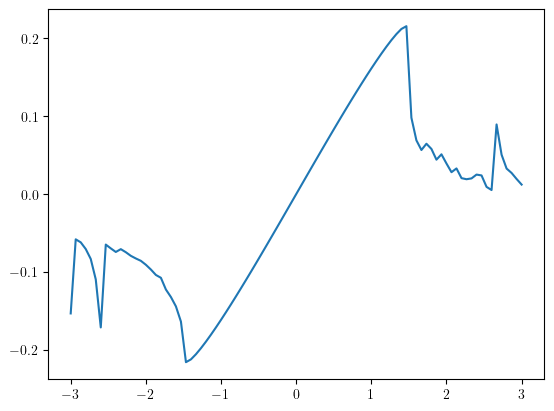

In [12]:
plt.figure()
plt.plot(d,w_cutarray[-15,:,0])
plt.show()

In [51]:
a = np.reshape(np.arange(16),(4,4))
print(a)
a[0,:]

[[ 0  1  2  3]
 [ 4  5  6  7]
 [ 8  9 10 11]
 [12 13 14 15]]


array([0, 1, 2, 3])

In [11]:
def add_sol2d(kval,wval,dval,r,xsol_list,ysol_list,sol_numb,rejections,rejected,comment=False):    
    
    new_sol =1
    for i in range(len(xsol_list)):
        if isclose(xsol_list[i],r.x[0],abs_tol=1/10**6) and isclose(ysol_list[i],r.x[1],abs_tol=1/10**6):
            new_sol = 0
            if comment:
                print('different sol: ',sol-r.root)
            break
    if new_sol:
        for sol in rejected:
            if isclose(sol[0],r.x[0],abs_tol=1/10**9) and isclose(sol[1],r.x[1],abs_tol=1/10**6):
                new_sol = 0
                if comment:
                    print('rejected sol: ',sol-r.root)
                break
    if new_sol:
        x = r.x[0]
        y = r.x[1]
        z = m_z(x,y,wval,kval,Gam)
        g  = gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam)[:,0]
        if  not ((isclose(g[0],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(g[1],0,rel_tol=10e-7,abs_tol=1/10**7)) and (isclose(g[2],0,rel_tol=10e-7,abs_tol=1/10**7))):
            # print(gl_np(0,np.array([x,y,z]),wval,kval,dval,Gam,sgam),x,y,z,'params: ',kval,wval,dval)
            rejections +=0
            rejected.append((x,y))
        else:
            xsol_list.append(x)
            ysol_list.append(y)
            sol_numb+=1
    return xsol_list, ysol_list, sol_numb, rejections, rejected


In [9]:
mgridpoints = 40
mgrid = np.zeros((mgridpoints,mgridpoints,2))
rho = np.linspace(0,0.5,mgridpoints)
phi = np.linspace(0,2*np.pi,mgridpoints)
for i, dist in enumerate(rho):
    for j, ang in enumerate(phi):
        mgrid[i,j,:]= dist*np.cos(ang), dist*np.sin(ang)

def root2d(k,w,d):
    solnumb =0
    rejections=0
    xsol_list =[]
    ysol_list = []
    rejected = []
    for i in range(mgrid.shape[0]):
        for j in range(mgrid.shape[1]):
            r = root(Foriginal_vec,args=(w,k,d,Gam,sgam),x0=mgrid[i,j])
            xsol_list, ysol_list, solnumb, rejections, rejected = add_sol2d(k,w,d,r,xsol_list,ysol_list,solnumb,rejections,rejected)
    return solnumb, xsol_list, ysol_list, rejections


In [14]:
check_sol = np.zeros_like(solution_number)
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            for i in range(-2,3):
                if solution_number[ik,iw,(id+i)%gridpoints]:
                    check_sol[ik,iw,id]=1
                elif solution_number[ik,(iw+i)%gridpoints,id]:
                    check_sol[ik,iw,id]=1
                elif solution_number[(ik+i)%gridpoints,iw,id]:
                    check_sol[ik,iw,id]=1

def wrapper(index):
    ik, iw, id = index//gridpoints**2,(index%gridpoints**2)//gridpoints, index%gridpoints
    kval, wval, dval = k[ik], w[iw], d[id]
    if check_sol[ik,iw,id] and dval!=0:
        return root2d(kval,wval,dval)
    else:
        return [0]

In [15]:
for i in range(gridpoints):
    print(wrapper(i))

(1, [-2.873629276081408e-08], [-1.149355922790027e-08], 0)
(1, [-2.93399593679026e-08], [-1.2080152976412955e-08], 0)
(1, [-2.996185113853879e-08], [-1.2710029104440852e-08], 0)
(1, [-3.060191225749812e-08], [-1.3387220917937706e-08], 0)
(1, [-3.125988572202706e-08], [-1.4116191298119458e-08], 0)
(1, [-3.193525837132536e-08], [-1.490187864657073e-08], 0)
(1, [-3.262719297064709e-08], [-1.5749746087261844e-08], 0)
(1, [-3.333444443518322e-08], [-1.666583328240681e-08], 0)
(1, [-3.405525667607026e-08], [-1.765680971600722e-08], 0)
(1, [-3.478723585897017e-08], [-1.873002757373385e-08], 0)
(1, [-3.552719509543225e-08], [-1.9893571317670937e-08], 0)
(1, [-3.6270964769620306e-08], [-2.115629961037999e-08], 0)
(1, [-3.701316190286392e-08], [-2.2527873244255434e-08], 0)
(1, [-3.774691129567323e-08], [-2.401876000346577e-08], 0)
(1, [-3.846351086708805e-08], [-2.564020371634386e-08], 0)
(1, [-3.9152033970614054e-08], [-2.7404139910781553e-08], 0)
(1, [-3.979886303175625e-08], [-2.9323034233564

In [18]:
from multiprocessing import Pool
po = Pool(20)
result = po.imap(wrapper,range(gridpoints**3))

In [ ]:
reject = np.zeros_like(solution_number)
for index, res in enumerate(result):
    ik, iw, id = index//gridpoints**2,(index%gridpoints**2)//gridpoints, index%gridpoints
    if check_sol[ik,iw,id] and d[id]!=0:
        soli, xsol[ik,iw,id,:soli], ysol[ik,iw,id,:soli], reject[ik,iw,id] = res
        solution_number[ik,iw,id] = soli

In [12]:
k, w, d = np.concatenate((k1,k2)), np.concatenate((w1,w2)), np.concatenate((d1,d2))
k.shape, w.shape, d.shape

((135,), (124,), (180,))

0

2 69 2 59 10.993333333333332 1.5888888888888888 0.9333333333333331
0.0017896439809801656
2 72 11 63 11.28 1.988888888888889 1.2000000000000002
0.0024342727019001364
2 81 21 67 12.14 2.4333333333333336 1.4666666666666668
0.005289126565219265
2 87 28 20 12.713333333333333 2.7444444444444445 -1.6666666666666667
0.003693968239667861
2 90 27 69 13.0 2.7 1.5999999999999996
0.002893196924396657
(90, 90, 90, 4)


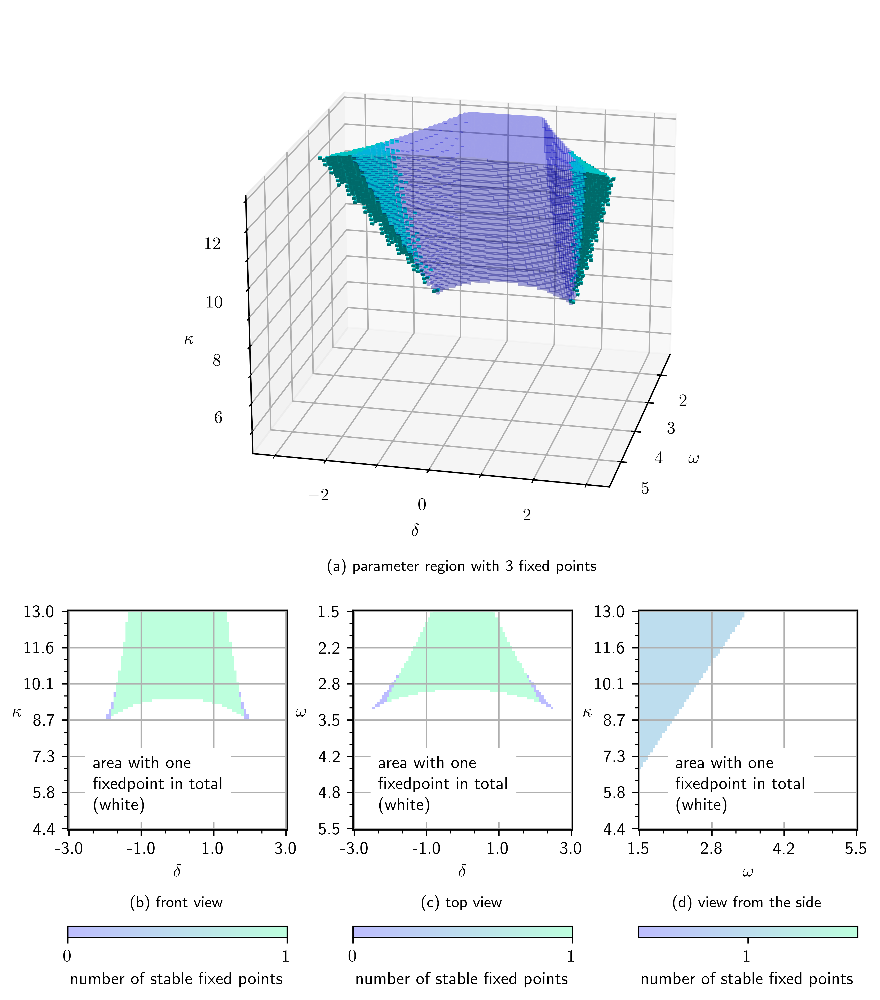

In [92]:
# 3d number of fixed points plot
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
gridpoints = solution_number.shape[0]
# Assuming solution_number, w, d, k are defined
fill_sol = np.zeros_like(solution_number, dtype=bool)
color = np.zeros((*solution_number.shape,4))
# Create grid for coordinates
W, D, K = np.meshgrid(w, d, k, indexing='ij')
w_cut = np.ones((gridpoints,gridpoints))*np.nan
k_cut = np.ones_like(w_cut)*np.nan
d_cut = np.ones_like(w_cut)*np.nan
for i in range(gridpoints):
    for j in range(gridpoints):
        # for l in range(gridpoints):
        l = 72
        if solution_number[l,i,j]>1 and stability_plus[l,i,j]==0:
            k_cut[i,j] = 0
        elif solution_number[l,i,j]>1:
            k_cut[i,j] = np.sign(stability_plus[l,i,j])
        l = 20
        if solution_number[i,l,j]>1 and stability_plus[i,l,j]==0:
            w_cut[i,j]=0
        elif solution_number[i,l,j]>1:
            w_cut[i,j]=np.sign(stability_plus[i,l,j])
        l = 42
        if solution_number[i,j,l]>1 and stability_plus[i,j,l]==0:
            d_cut[i,j]=0
        elif solution_number[i,j,l]>1:
            d_cut[i,j]= np.sign(stability_plus[i,j,l])
def adding(a,b):
    return np.abs(a-b)
adding = np.frompyfunc(adding,2,1)        
# Fill cells where condition is met
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            soli = solution_number[ik, iw, id]
            if soli ==2:
                # solution_number, xsol, ysol = repeat_roots(ik,iw,id,solution_number,xsol,ysol)
                soli = solution_number[ik, iw, id]
            if soli >= 2:
                fill_sol[ik, iw, id] = True
                if stability_plus[ik,iw,id]:
                    if stability_plus[ik,iw,id]>1:
                        solution_number[ik,iw,id]=3
                        print(stability_plus[ik,iw,id],ik,iw,id,kval,wval,dval)
                        buff = adding.outer(xsol[ik,iw,id,:soli],xsol[ik,iw,id,:soli])
                        print(np.min(buff+10*np.diag(np.diag(np.ones_like(buff)))))
                        # print(buff)
                    # print(kval,wval,dval)
                    color[ik,iw,id,:]=[0,0,1,0.2]
                else:
                    # print(3)
                    color[ik,iw,id,:]=[0,1,1,1]

# Slice arrays to match required dimensions if needed
fill_sol = np.swapaxes(np.swapaxes(fill_sol[:-1, :-1, :-1],0,1),1,2)
color = np.swapaxes(np.swapaxes(color[:-1, :-1, :-1],0,1),1,2)
print(color.shape)

tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=30,\
                        xtick_step_minor=10,\
                            ytick_step_major=15,\
                                ytick_step_minor=5)
trash, xw, yw, trash=im.get_extent()#(-0.5,39.5,29.5,-0.5)#
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step

fig = plt.figure(figsize=(20.6*cm, 25.1*cm),dpi=600)

# Create a GridSpec layout
gs = gridspec.GridSpec(2, 3, figure=fig,wspace=0.3,hspace=-0.21,top=0.9)  # 2 rows and 3 columns for flexible layout

# Plot 1: Sloped view (spans entire first row)
ax1 = fig.add_subplot(gs[0, :], projection='3d') 


ax1.yaxis.set_major_locator(ticker.MultipleLocator(2))
ax1.yaxis.set_minor_locator(ticker.MultipleLocator(1))
ax1.xaxis.set_major_locator(ticker.MultipleLocator(1))
ax1.xaxis.set_minor_locator(ticker.MultipleLocator(1))
ax1.zaxis.set_minor_locator(ticker.MultipleLocator(1))
ax1.zaxis.set_major_locator(ticker.MultipleLocator(2))

ax1.view_init(20,13,0)
ax1.voxels(W, D, K, fill_sol, facecolors=color)
ax1.xaxis.set_rotate_label(False)
ax1.yaxis.set_rotate_label(False)
ax1.set_xlabel(r'$\omega$',rotation=0)
ax1.set_ylabel(r'$\delta$',rotation=0)
ax1.zaxis.set_rotate_label(False)
ax1.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
ax1.set_title(r'(a) parameter region with 3 fixed points',loc='center',y=-0.04,fontsize=9)
#
ax2 = fig.add_subplot(gs[1, 0]) 
im = ax2.imshow(w_cut[::-1,:],cmap='winter',alpha=0.26)
# im = ax2.imshow(w_cut[::-1,:],cmap='winter',alpha=0.26)
ax2.grid(visible=True)
tickformat2 = Format(xscale=d,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax2.xaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formatx0))
ax2.yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax2.xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax2.xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax2.yaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formaty1)) 
# ax2.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))  # Make the z-axis line invisible
# ax2.set_xticks([])  # Remove z-axis ticks
# ax2.xaxis.label.set_visible(False)
# ax2.xaxis.set_rotate_label(False)
# ax2.yaxis.set_rotate_label(False)
# ax2.zaxis.set_rotate_label(False)
ax2.text(10,65,r'\,\\area with one\\fixedpoint in total\\ \, (white)',backgroundcolor='1',multialignment='center')
ax2.set_xlabel(r'$\delta$')
ax2.set_ylabel(r"$\kappa$",rotation=0)
ax2.set_title(r'(b) front view',loc='center',y=-0.4,fontsize=9)
colorbar2 = fig.colorbar(im,ax=ax2,orientation='horizontal',shrink=1,anchor=(0.5,0.8),ticks=[0,1],label='number of stable fixed points')
# plt.savefig('front_view.png')
# plt.show()

# fig = plt.figure()
# ax = fig.add_subplot(projection='3d')
# ax = axes[0,1]
ax3 = fig.add_subplot(gs[1, 1]) 
im = ax3.imshow(k_cut,cmap='winter',alpha=0.26)
ax3.grid(visible=True)
tickformat3 = Format(xscale=d,yscale=w,xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax3.xaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formatx0))
ax3.yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax3.yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax3.xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax3.xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax3.yaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formaty1)) 
# ax3.view_init(90,180,0)
# ax3.voxels(W, D, K, fill_sol, facecolors=color)
# ax3.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))  # Make the z-axis line invisible
# ax3.set_zticks([])  # Remove z-axis ticks
# ax3.zaxis.label.set_visible(False)
# ax3.xaxis.set_rotate_label(False)
# ax3.yaxis.set_rotate_label(False)
# ax3.zaxis.set_rotate_label(False)
ax3.text(10,65,r'\,\\area with one\\fixedpoint in total\\ \, (white)',backgroundcolor='1',multialignment='center')
ax3.set_ylabel(r'$\omega$',rotation=0,labelpad=10)
ax3.set_xlabel(r'$\delta$')
ax3.set_title(r'(c) top view',loc='center',y=-0.4,fontsize=9)
colorbar3 = fig.colorbar(im,ax=ax3,orientation='horizontal',shrink=1,anchor=(0.5,0.8),label='number of stable fixed points',ticks=[0,1])
# plt.savefig('top_view.png')
# plt.show()
# fig = plt.figure()
# ax = fig.add_subplot(projection='3d')
ax4 = fig.add_subplot(gs[1, 2]) 
im = ax4.imshow(d_cut[::-1,:],cmap='winter',alpha=0.26)
ax4.grid(visible=True)
tickformat4 = Format(xscale=w,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax4.xaxis.set_major_formatter(ticker.FuncFormatter(tickformat4.formatx0))
ax4.yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax4.yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax4.xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax4.xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax4.yaxis.set_major_formatter(ticker.FuncFormatter(tickformat4.formaty1)) 
# ax4.view_init(0,90,0)
# ax4.voxels(W, D, K, fill_sol, facecolors=color)
# ax4.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))  # Make the z-axis line invisible
# ax4.set_yticks([])  # Remove z-axis ticks
# ax4.yaxis.label.set_visible(False)
# ax4.xaxis.set_rotate_label(False)
# ax4.yaxis.set_rotate_label(False)
# ax4.zaxis.set_rotate_label(False)
ax4.text(15,65,r'\,\\area with one\\fixedpoint in total\\ \, (white)',backgroundcolor='1',multialignment='center')
ax4.set_xlabel(r'$\omega$')
ax4.set_ylabel(r'$\kappa$',rotation=0)
ax4.set_title(r'(d) view from the side',loc='center',y=-0.4,fontsize=9)
colorbar4 = fig.colorbar(im,ax=ax4,orientation='horizontal',shrink=1,anchor=(0.5,0.8),label='number of stable fixed points',ticks=[0,1])
# plt.savefig('side_view.png')
# plt.subplots_adjust(hspace=0,wspace=0)
# gs.tight_layout(figure=fig,h_pad=-1)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'numb_of_fixp_extended2.png',bbox_inches='tight')

plt.show()

35
(34, 34, 34, 4)


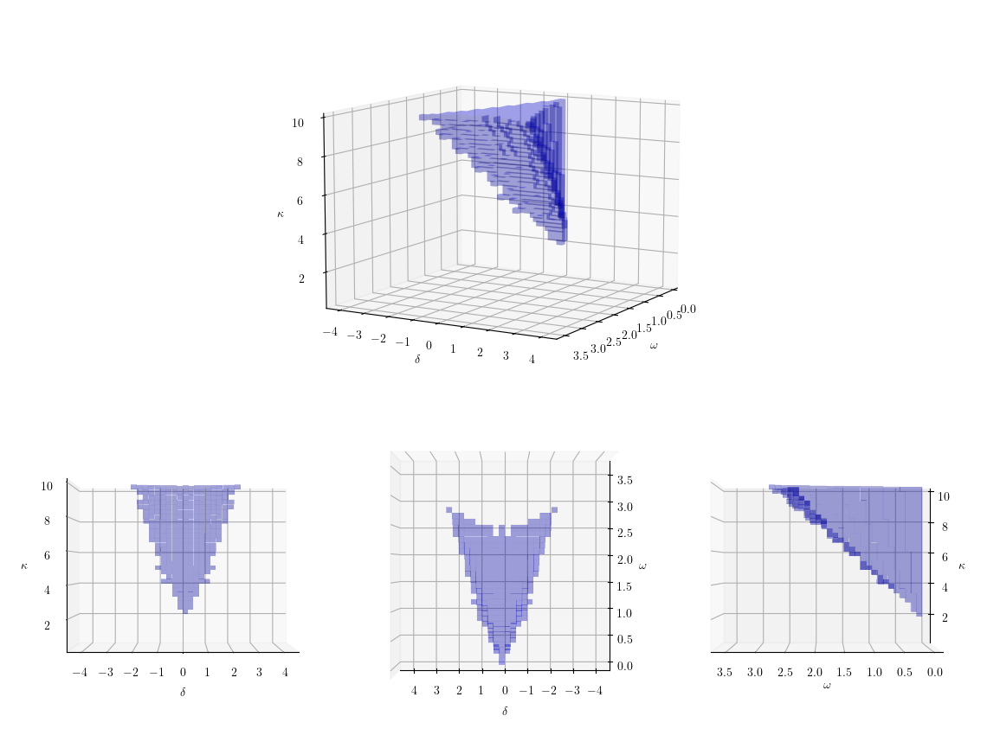

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
print(gridpoints)
# Assuming solution_number, w, d, k are defined
fill_sol = np.zeros_like(solution_number, dtype=bool)
color = np.zeros((*solution_number.shape,4))
# Create grid for coordinates
W, D, K = np.meshgrid(w, d, k, indexing='ij')
w_cut = np.ones((gridpoints,gridpoints))*np.nan
k_cut = np.ones_like(w_cut)*np.nan
d_cut = np.ones_like(w_cut)*np.nan
for i in range(gridpoints):
    for j in range(gridpoints):
        for l in range(gridpoints):
            if solution_number[l,i,j]==3:
                k_cut[i,j] = 3
            if solution_number[i,l,j]==3:
                w_cut[i,j]=3
            if solution_number[i,j,l]==3:
                d_cut[i,j]=3
# Fill cells where condition is met
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            soli = solution_number[ik, iw, id]
            if soli >= 2:
                fill_sol[ik, iw, id] = True
                if soli==2:
                    # print(2)
                    color[ik,iw,id,:]=[1,0,0,1]
                elif soli==3:
                    # print(3)
                    color[ik,iw,id,:]=[0,0,1,0.2]

# Slice arrays to match required dimensions if needed
fill_sol = np.swapaxes(np.swapaxes(fill_sol[:-1, :-1, :-1],0,1),1,2)
color = np.swapaxes(np.swapaxes(color[:-1, :-1, :-1],0,1),1,2)
print(color.shape)
fig = plt.figure(figsize=(20.6*cm, 29.1*cm))

# Create a GridSpec layout
gs = gridspec.GridSpec(2, 3, figure=fig,wspace=-0.05,hspace=-0.1,left=-0.5)  # 2 rows and 3 columns for flexible layout

# Plot 1: Sloped view (spans entire first row)
ax1 = fig.add_subplot(gs[0, :], projection='3d') 
# fig, axes = plt.subplots(2, 2, subplot_kw={'projection': '3d'}, figsize=(10, 10))
# # ax = fig.add_subplot(projection='3d')
# ax = axes[0,0]
ax1.view_init(10,30,0)
ax1.voxels(W, D, K, fill_sol, facecolors=color)
ax1.xaxis.set_rotate_label(False)
ax1.yaxis.set_rotate_label(False)
ax1.set_xlabel(r'$\omega$',rotation=0)
ax1.set_ylabel(r'$\delta$',rotation=0)
ax1.zaxis.set_rotate_label(False)
ax1.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
# plt.subplots_adjust(bottom=0.4)
# plt.savefig('sloped_view.png')
# plt.show()

# fig = plt.figure()

# ax = fig.add_subplot(projection='3d')
ax2 = fig.add_subplot(gs[1, 0], projection='3d') 
# ax = axes[1,0]
ax2.view_init(0,0,0)
ax2.voxels(W, D, K, fill_sol, facecolors=color)
ax2.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))  # Make the z-axis line invisible
ax2.set_xticks([])  # Remove z-axis ticks
ax2.xaxis.label.set_visible(False)
ax2.xaxis.set_rotate_label(False)
ax2.yaxis.set_rotate_label(False)
ax2.zaxis.set_rotate_label(False)
ax2.set_ylabel(r'$\delta$',labelpad=10)
ax2.set_zlabel(r"$\kappa$",rotation=0)
# plt.savefig('front_view.png')
# plt.show()

# fig = plt.figure()
# ax = fig.add_subplot(projection='3d')
# ax = axes[0,1]
ax3 = fig.add_subplot(gs[1, 1], projection='3d') 
ax3.view_init(90,180,0)
ax3.voxels(W, D, K, fill_sol, facecolors=color)
ax3.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))  # Make the z-axis line invisible
ax3.set_zticks([])  # Remove z-axis ticks
ax3.zaxis.label.set_visible(False)
ax3.xaxis.set_rotate_label(False)
ax3.yaxis.set_rotate_label(False)
ax3.zaxis.set_rotate_label(False)
ax3.set_xlabel(r'$\omega$')
ax3.set_ylabel(r'$\delta$',labelpad=10)
# plt.savefig('top_view.png')
# plt.show()
# fig = plt.figure()
# ax = fig.add_subplot(projection='3d')
ax4 = fig.add_subplot(gs[1, 2], projection='3d') 
ax4.view_init(0,90,0)
ax4.voxels(W, D, K, fill_sol, facecolors=color)
ax4.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))  # Make the z-axis line invisible
ax4.set_yticks([])  # Remove z-axis ticks
ax4.yaxis.label.set_visible(False)
ax4.xaxis.set_rotate_label(False)
ax4.yaxis.set_rotate_label(False)
ax4.zaxis.set_rotate_label(False)
ax4.set_xlabel(r'$\omega$')
ax4.set_zlabel(r'$\kappa$',rotation=0)
# plt.savefig('side_view.png')
# plt.subplots_adjust(hspace=0,wspace=0)
# plt.tight_layout()
plt.show()


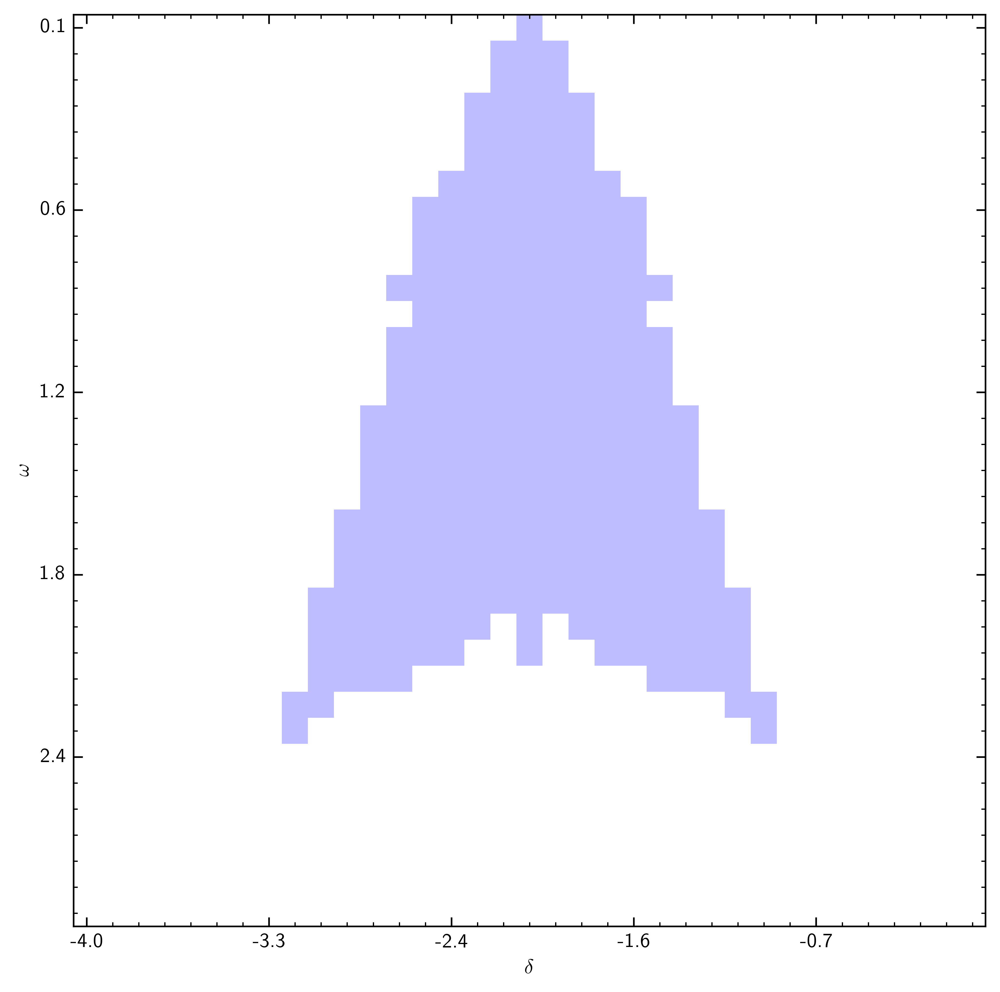

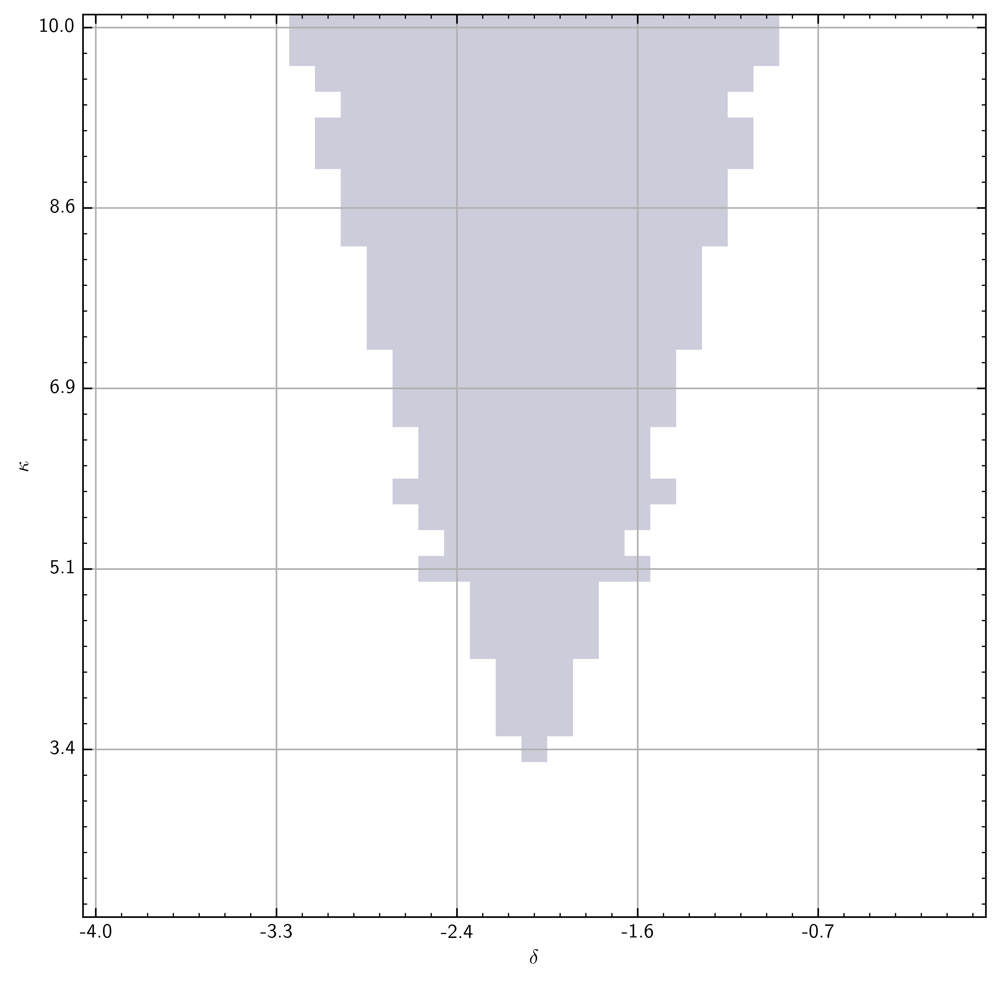

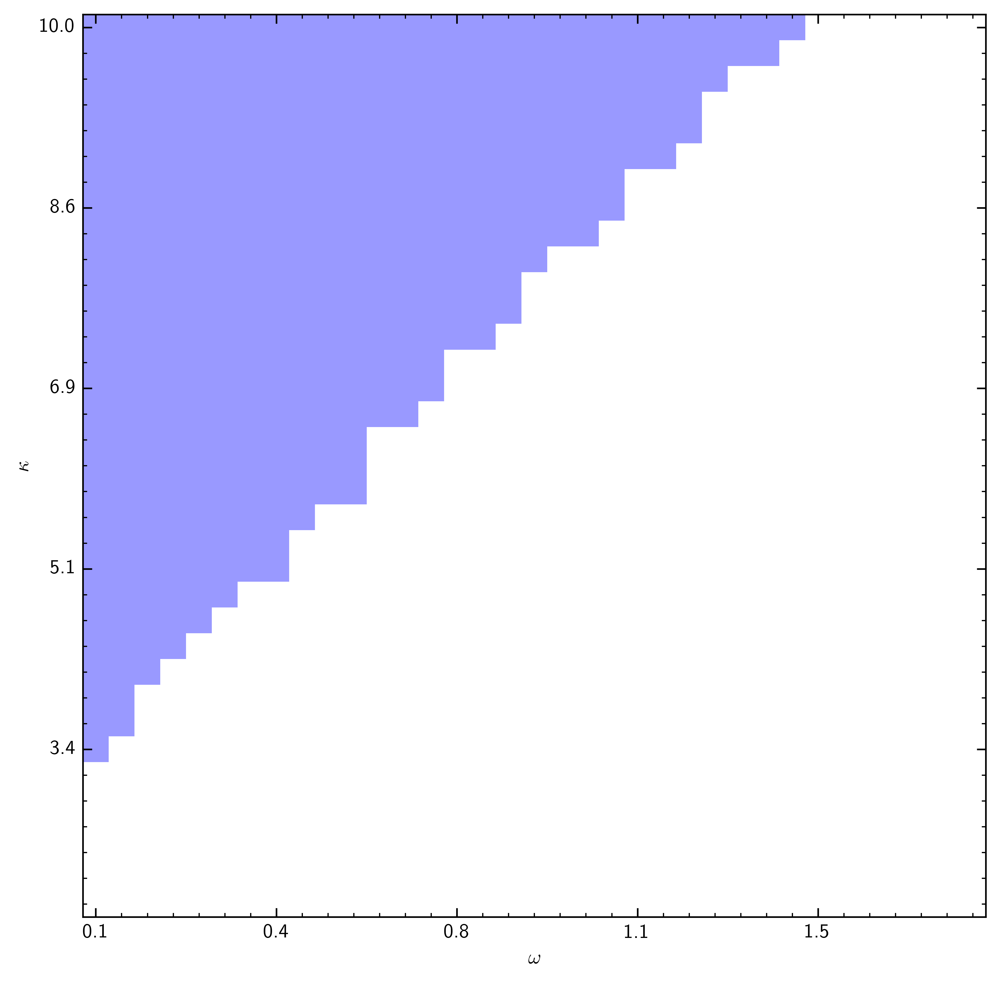

In [19]:
w_cut = np.ones((gridpoints,gridpoints))*np.nan
k_cut = np.ones_like(w_cut)*np.nan
d_cut = np.ones_like(w_cut)*np.nan
for i in range(gridpoints):
    for j in range(gridpoints):
        for l in range(gridpoints):
            if solution_number[l,i,j]==3:
                k_cut[i,j] = 3
            if solution_number[i,l,j]==3:
                w_cut[i,j]=3
            if solution_number[i,j,l]==3:
                d_cut[i,j]=3

tickformat = Format(xscale=d,yscale=w,xprec="{:.1f}",yprec="{:.1f}")
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=7,\
                        xtick_step_minor=1,\
                            ytick_step_major=7,\
                                ytick_step_minor=1)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp,formater=tickformat)
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
setup.DEFAULT_HEAT_EXTEND = (-0.5,64.5,39.5,-0.5)
fig, ax = setup.return_fig(shape=(1,1),dots_per_inch=600) 
im = ax.imshow(k_cut,cmap='winter',alpha=0.26)#,extent=(-0.5,64.5,39.5,-0.5))
ax.set_ylabel(r'$\omega$')
ax.set_xlabel(r'$\delta$')
# cbar = fig.colorbar(im,ax=ax,orientation='vertical',shrink=0.85)
plt.show()
tickformat = Format(xscale=d,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}")
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=7,\
                        xtick_step_minor=1,\
                            ytick_step_major=7,\
                                ytick_step_minor=1)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp,formater=tickformat)
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
setup.DEFAULT_HEAT_EXTEND = (-0.5,64.5,39.5,-0.5)
fig, ax = setup.return_fig(shape=(1,1),dots_per_inch=600) 
im = ax.imshow(w_cut[::-1,:],cmap='seismic',alpha=0.2)#,extent=(-0.5,64.5,39.5,-0.5))
ax.set_ylabel(r'$\kappa$')
ax.set_xlabel(r'$\delta$')
ax.grid(visible=True)
# cbar = fig.colorbar(im,ax=ax,orientation='vertical',shrink=0.85)
plt.show()
tickformat = Format(xscale=w,yscale=k[::-1],xprec="{:.1f}",yprec="{:.1f}")
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=7,\
                        xtick_step_minor=1,\
                            ytick_step_major=7,\
                                ytick_step_minor=1)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp,formater=tickformat)
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm #29.1*cm
setup.DEFAULT_HEAT_EXTEND = (-0.5,64.5,39.5,-0.5)
fig, ax = setup.return_fig(shape=(1,1),dots_per_inch=600) 
im = ax.imshow(d_cut[::-1,:],cmap='bwr',alpha=0.4)#,extent=(-0.5,64.5,39.5,-0.5))
ax.set_ylabel(r'$\kappa$')
ax.set_xlabel(r'$\omega$')
# cbar = fig.colorbar(im,ax=ax,orientation='vertical',shrink=0.85)
plt.show()

In [5]:
k, w, d, solution_number, xsol, ysol = k2, w2, d2, solution_number2, xsol2, ysol2

In [107]:
a = np.reshape(np.arange(9),(3,3))
np.diag(np.diag(a))

array([[0, 0, 0],
       [0, 4, 0],
       [0, 0, 8]])

params:  6.2155555555555555 1.5 -1.4
eig:  [-0.33885594+0.j          1.08865255+1.03472135j  1.08865255-1.03472135j]
eig:  [0.07077064+1.97774356j 0.07077064-1.97774356j 0.01449431+0.j        ]
eig:  [ 0.01770717+2.06756295j  0.01770717-2.06756295j -0.01434354+0.j        ]
params:  6.2155555555555555 1.5 1.4000000000000004
eig:  [-0.33885594+0.j          1.08865255+1.03472135j  1.08865255-1.03472135j]
eig:  [0.07077064+1.97774356j 0.07077064-1.97774356j 0.01449431+0.j        ]
eig:  [ 0.01770717+2.06756295j  0.01770717-2.06756295j -0.01434354+0.j        ]
params:  6.2155555555555555 1.5444444444444445 -1.4666666666666668
eig:  [ 0.81371794+1.22671628j  0.81371794-1.22671628j -0.16019249+0.j        ]
eig:  [0.21659092+1.82410348j 0.21659092-1.82410348j 0.02786518+0.j        ]
eig:  [ 0.05868463+2.06884394j  0.05868463-2.06884394j -0.0301041 +0.j        ]
params:  6.2155555555555555 1.5444444444444445 1.4666666666666668
eig:  [ 0.81371794+1.22671628j  0.81371794-1.22671628j -0.16019249+0

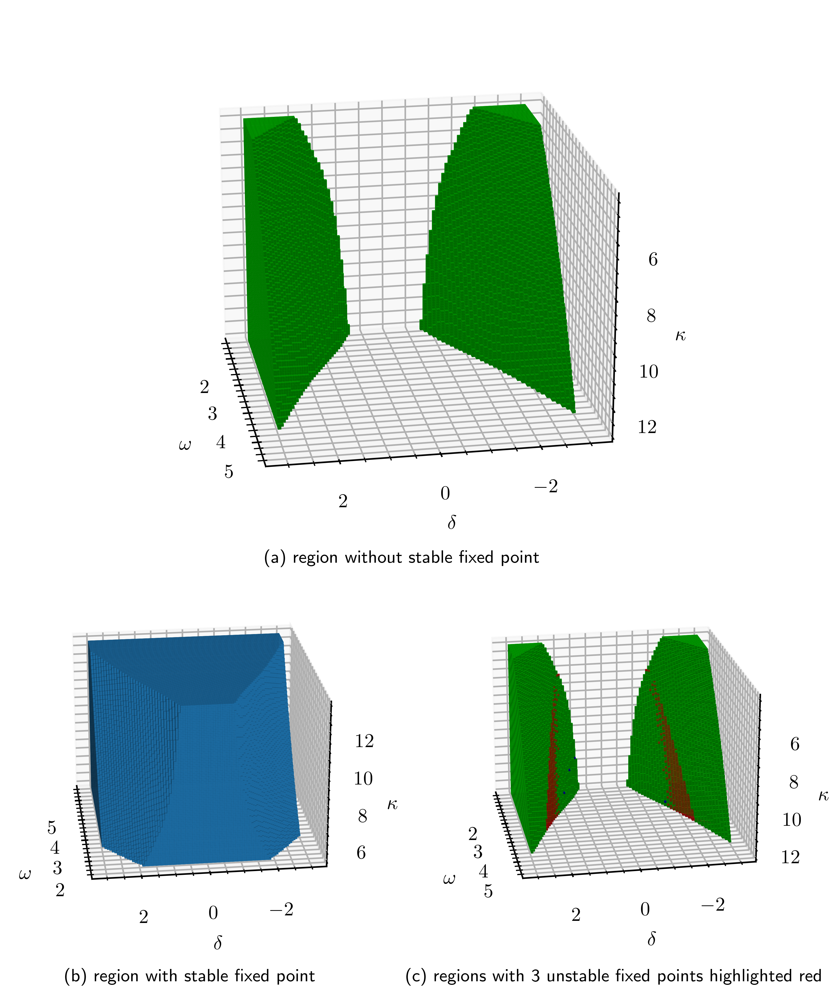

In [6]:
# 3d stability plot
import matplotlib.gridspec as gridspec
W, D, K = np.meshgrid(w, d, k, indexing='ij')
stability = np.ones_like(xsol)
eigi = np.zeros((*xsol.shape,3),dtype=np.complex64)
stability_plus = np.zeros_like(solution_number)
stab_intersect = np.zeros_like(stability_plus)
color3 = np.zeros((*solution_number.shape,4))
color1= np.zeros_like(color3)
color2 = np.zeros_like(color3)
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            for ind in range(int(solution_number[ik,iw,id])):
                # s = yvariant[ik,iw,id,ind]
                # if s==1:
                #     yofx = y1ofx
                # else:
                #     yofx = y2ofx
                y = ysol[ik,iw,id,ind]
                z = m_z(xsol[ik,iw,id,ind],y,wval,kval,Gam)
                m = np.array([xsol[ik,iw,id,ind],y,z])
                # print(m)
                # jac = jac_gl_np(0,m,wval,kval,dval,Gam,sgam)
                jac = jac2(0,m,wval,kval,dval,Gam,sgam)
                try:
                    eigenvalues, vectors =np.linalg.eig(jac)
                    eigi[ik,iw,id,ind,:]=eigenvalues
                except:
                    # print(ik,iw,id)
                    stability[ik,iw,id,ind]=-1
                    stability_plus[ik,iw,id]=-1
                if np.any(np.real(eigenvalues)>=0):
                    # if solution_number[ik,iw,id]==3:
                        # print(eigenvalues)
                    # print(eigenvalues)
                    stability[ik,iw,id,ind]=0
                    
                else:
                    # pass
                    stability[ik,iw,id,ind] +=1
                    stability_plus[ik,iw,id]+=1
            if stability_plus[ik,iw,id]==0:
                color3[ik,iw,id,:] = [0,1,0,1]
                color1[ik,iw,id,:] = [0,1,0,1]
            else:
                color3[ik,iw,id,:] = [0,0,1,1]
                color1[ik,iw,id,:] = [0,0,1,1]
           
            if solution_number[ik,iw,id]>=2 and stability_plus[ik,iw,id]==0:
                stab_intersect[ik,iw,id]=1
                print('params: ',kval,wval,dval)
                for ind in range(int(solution_number[ik,iw,id])):
                    y = ysol[ik,iw,id,ind]
                    z = m_z(xsol[ik,iw,id,ind],y,wval,kval,Gam)
                    m = np.array([xsol[ik,iw,id,ind],y,z])
                    jac = jac_gl_np(0,m,wval,kval,dval,Gam,sgam)
                    eigenvalues, vectors =np.linalg.eig(jac)
                    print('eig: ',eigenvalues)
                color3[ik,iw,id,:] = [1,0,0,0.8]
            

            stability[ik,iw,id,int(solution_number[ik,iw,id]):]=np.nan

# fig, ax = setup.return_fig(shape=(3,2),dots_per_inch=600)
# mask1 = np.ones_like(solution_number[1,:,:])*np.nan
# mask2 = np.ones_like(solution_number[1,:,:])*np.nan
# # mask1[4,13]=2
# # mask2[9,31]=2
# kat, wat, dat = 34,4,12
# plots = [stability[:,:,dat,0],stability[:,wat,:,0],stability[kat,:,:,0]]
# plots = [[stability[:,:,dat,0],stability[:,wat,:,0],stability[kat,:,:,0]],[stability_plus[:,:,dat],stability_plus[:,wat,:],stability_plus[kat,:,:]]]
# for i in range(3):
#     for j in range(2):
#         im = ax[i,j].imshow(plots[j][i])#,extent=(-0.5,64.5,39.5,-0.5))
#         # if i==0:
#         # am = ax[i].imshow(mask1)
#         # elif i==2:
#         #     am =ax[i].imshow(mask2)
#         cbar = fig.colorbar(im,ax=ax[i,j],orientation='vertical')

# for i in range(k.shape[0]):
#     for j in range(w.shape[0]):
        # for l in range(d.shape[0]):
            # if solution_number[i,9,j]==0:
            # if isclose(k[i],5.235294117647059,rel_tol=1e-4,abs_tol=1/10**4) and isclose(w[j],2.3235294117647056,rel_tol=1e-4,abs_tol=1/10**4) and isclose(d[l],4.117647058823529,rel_tol=1e-4,abs_tol=1/10**4):
                # print(k[i],w[9],d[j],i,j,l)
        # if np.isnan(stability[i,25,j,0]):
        #     print(k[i],w[25],d[j])
        # if solution_number[i,j,33]==0 and i>12:
        #     print(k[i],w[j],d[5])
fig = plt.figure(figsize=(20.6*cm, 25.1*cm),dpi=600)

# Create a GridSpec layout
gs = gridspec.GridSpec(2, 2, figure=fig,wspace=0.2,hspace=-0.6,bottom=-0.3,right=0.8,height_ratios=[1,3.5])

stability_plus_plot = np.swapaxes(np.swapaxes(stability_plus[:-1,:-1,:-1],0,1),1,2)
ax2 = fig.add_subplot(gs[1,0],projection='3d')
ax2.yaxis.set_major_locator(ticker.MultipleLocator(2))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
ax2.xaxis.set_major_locator(ticker.MultipleLocator(1))
ax2.xaxis.set_minor_locator(ticker.MultipleLocator(0.2))
ax2.zaxis.set_major_locator(ticker.MultipleLocator(2))
ax2.zaxis.set_minor_locator(ticker.MultipleLocator(0.5))

ax2.view_init(22,173,0)#200,190,0
ax2.voxels(W, D, K, stability_plus_plot)
ax2.xaxis.set_rotate_label(False)
ax2.yaxis.set_rotate_label(False)
ax2.set_xlabel(r'$\omega$',rotation=0)
ax2.set_ylabel(r'$\delta$',rotation=0)
ax2.zaxis.set_rotate_label(False)
ax2.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
ax2.set_title(r'(b) region with stable fixed point',loc='center',y=-0.2,fontsize=9)
# plt.subplots_adjust(bottom=-0.4)
# plt.show() 
# fig = plt.figure()
# stability_plus = np.swapaxes(np.swapaxes(stability_plus[:-1,:-1,:-1],0,1),1,2)
ax1 = fig.add_subplot(gs[0,:],projection='3d')
ax1.view_init(200,190,0)
ax1.voxels(W, D, K, np.ones_like(stability_plus_plot) -stability_plus_plot,facecolors=[0,1,0,1])

ax1.yaxis.set_major_locator(ticker.MultipleLocator(2))
ax1.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
ax1.xaxis.set_major_locator(ticker.MultipleLocator(1))
ax1.xaxis.set_minor_locator(ticker.MultipleLocator(0.2))
ax1.zaxis.set_major_locator(ticker.MultipleLocator(2))
ax1.zaxis.set_minor_locator(ticker.MultipleLocator(0.5))


ax1.xaxis.set_rotate_label(False)
ax1.yaxis.set_rotate_label(False)
ax1.set_xlabel(r'$\omega$',rotation=0)
ax1.set_ylabel(r'$\delta$',rotation=0)
ax1.zaxis.set_rotate_label(False)
ax1.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
ax1.set_title(r'(a) region without stable fixed point',loc='center',y=-0.07,fontsize=9)
# plt.subplots_adjust(bottom=-0.4)
# # plt.tight_layout()
# plt.show() 

# stab_intersect = 1-stability_plus+stab_intersect[:-1,:-1,:-1]
stab_intersect = np.swapaxes(np.swapaxes(stab_intersect[:-1,:-1,:-1],0,1),1,2)
stab_intersect = 1-stability_plus_plot+stab_intersect
color3 =np.swapaxes(np.swapaxes(color3[:-1,:-1,:-1],0,1),1,2)
# ax.set_xlabel(r'$\omega$')
# ax.set_ylabel(r'$\delta$')
# ax.set_zlabel(r'$\kappa$')
# fig = plt.figure()
# stability_plus = np.swapaxes(np.swapaxes(stability_plus[:-1,:-1,:-1],0,1),1,2)
ax3 = fig.add_subplot(gs[1,1],projection='3d')
ax3.view_init(200,190,0)
ax3.voxels(W, D, K, stab_intersect,facecolors=color3)
ax3.yaxis.set_major_locator(ticker.MultipleLocator(2))
ax3.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
ax3.xaxis.set_major_locator(ticker.MultipleLocator(1))
ax3.xaxis.set_minor_locator(ticker.MultipleLocator(0.2))
ax3.zaxis.set_major_locator(ticker.MultipleLocator(2))
ax3.zaxis.set_minor_locator(ticker.MultipleLocator(0.5))


ax3.xaxis.set_rotate_label(False)
ax3.yaxis.set_rotate_label(False)
ax3.set_xlabel(r'$\omega$',rotation=0)
ax3.set_ylabel(r'$\delta$',rotation=0)
ax3.zaxis.set_rotate_label(False)
ax3.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
ax3.set_title(r'(c) regions with 3 unstable fixed points highlighted red',loc='center',y=-0.2,fontsize=9)
# plt.subplots_adjust(bottom=-0.4)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'stability_regions.pdf',bbox_inches='tight')

# plt.tight_layout()
plt.show()


params:  1.7907813953488372 0.09201398520833334 -0.1363636363636367
eig:  [-0.86183892+0.j          0.14229104+0.03780625j  0.14229104-0.03780625j]
eig:  [-0.44084291+0.26601571j -0.44084291-0.26601571j  0.07677219+0.j        ]
eig:  [-0.48251406+0.54197989j -0.48251406-0.54197989j  0.00553827+0.j        ]
params:  1.7907813953488372 1.5 1.5
eig:  [ 0.58414633+0.92932723j  0.58414633-0.92932723j -0.74862919+0.j        ]
eig:  [ 0.06130911+1.29409032j  0.06130911-1.29409032j -0.35389765+0.j        ]
eig:  [ 0.47549955+0.99252592j  0.47549955-0.99252592j -0.67047684+0.j        ]
params:  1.7907813953488372 2.966666666666667 1.5
eig:  [1.0132738 +0.j         0.42436218+1.94405666j 0.42436218-1.94405666j]
eig:  [0.47378346+0.j         0.0175954 +2.59615999j 0.0175954 -2.59615999j]
eig:  [0.9042221 +0.j         0.35165692+2.08264823j 0.35165692-2.08264823j]
params:  1.7907813953488372 4.433333333333334 -1.3636363636363638
eig:  [1.9825249 +0.j         0.66090398+3.39058299j 0.66090398-3.390

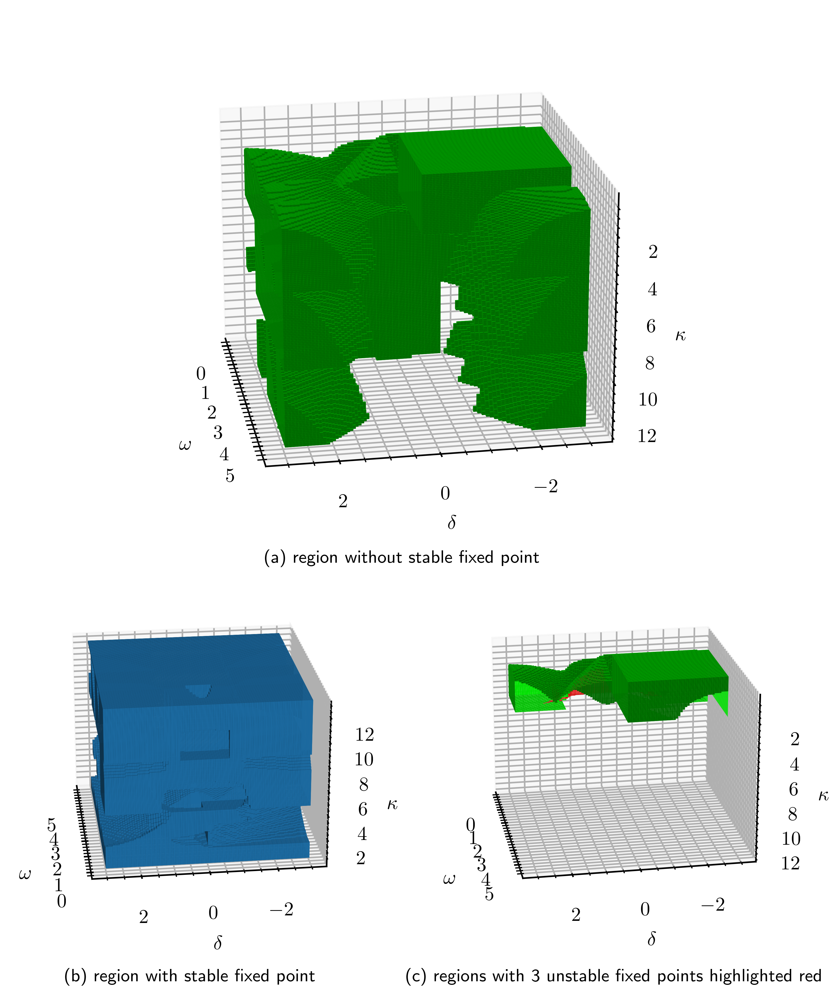

In [25]:
# 3d stability plot
import matplotlib.gridspec as gridspec
kmax1, wmax1, dmax1 = k1.shape[0],w1.shape[0],d1.shape[0]
kmax2, wmax2, dmax2 = k2.shape[0],w2.shape[0],d2.shape[0]
W, D, K = np.meshgrid(w, d, k, indexing='ij')
stability = np.ones((k.shape[0],w.shape[0],d.shape[0],5))
eigi = np.zeros((k.shape[0],w.shape[0],d.shape[0],5,3),dtype=np.complex64)
stability_plus = np.zeros((k.shape[0],w.shape[0],d.shape[0]))
stab_intersect = np.zeros_like(stability_plus)
color3 = np.zeros((k.shape[0],w.shape[0],d.shape[0],4))
color1= np.zeros_like(color3)
color2 = np.zeros_like(color3)
for i, kval in enumerate(k):
    for j, wval in enumerate(w):
        for l, dval in enumerate(d):
            if i<imax1 and j<jmax1 and l<lmax1:
                ik ,iw, id = i,j,l
                solution_number = solution_number1
                xsol = xsol1
                ysol = ysol1
                for ind in range(int(solution_number[ik,iw,id])):
                    # s = yvariant[ik,iw,id,ind]
                    # if s==1:
                    #     yofx = y1ofx
                    # else:
                    #     yofx = y2ofx
                    y = ysol[ik,iw,id,ind]
                    z = m_z(xsol[ik,iw,id,ind],y,wval,kval,Gam)
                    m = np.array([xsol[ik,iw,id,ind],y,z])
                    # print(m)
                    # jac = jac_gl_np(0,m,wval,kval,dval,Gam,sgam)
                    jac = jac2(0,m,wval,kval,dval,Gam,sgam)
                    try:
                        eigenvalues, vectors =np.linalg.eig(jac)
                        eigi[i,j,l,ind,:]=eigenvalues
                    except:
                        # print(ik,iw,id)
                        stability[i,j,l,ind]=-1
                        stability_plus[i,j,l]=-1
                    if np.any(np.real(eigenvalues)>=0):
                        # if solution_number[ik,iw,id]==3:
                            # print(eigenvalues)
                        # print(eigenvalues)
                        stability[i,j,l,ind]=0
                    else:
                        # pass
                        stability_plus[i,j,l]=1
                if stability_plus[i,j,l]==0:
                    color3[ik,iw,id,:] = [0,1,0,1]
                    color1[ik,iw,id,:] = [0,1,0,1]
            
                if solution_number[ik,iw,id]>=2 and stability_plus[i,j,l]==0:
                    stab_intersect[i,j,l]=1
                    print('params: ',kval,wval,dval)
                    for ind in range(int(solution_number[ik,iw,id])):
                        y = ysol[ik,iw,id,ind]
                        z = m_z(xsol[ik,iw,id,ind],y,wval,kval,Gam)
                        m = np.array([xsol[ik,iw,id,ind],y,z])
                        jac = jac_gl_np(0,m,wval,kval,dval,Gam,sgam)
                        eigenvalues, vectors =np.linalg.eig(jac)
                        print('eig: ',eigenvalues)
                    color3[ik,iw,id,:] = [1,0,0,0.8]
                

                stability[i,j,l,int(solution_number[ik,iw,id]):]=np.nan
            elif ik%kmax1<kmax2 and iw%wmax1<wmax2 and id%dmax1<dmax2:
                ik ,iw, id = i%kmax1,j%wmax1,l%dmax1
                solution_number = solution_number2
                xsol = xsol2
                ysol = ysol2
                for ind in range(int(solution_number[ik,iw,id])):
                    # s = yvariant[ik,iw,id,ind]
                    # if s==1:
                    #     yofx = y1ofx
                    # else:
                    #     yofx = y2ofx
                    y = ysol[ik,iw,id,ind]
                    z = m_z(xsol[ik,iw,id,ind],y,wval,kval,Gam)
                    m = np.array([xsol[ik,iw,id,ind],y,z])
                    # print(m)
                    # jac = jac_gl_np(0,m,wval,kval,dval,Gam,sgam)
                    jac = jac2(0,m,wval,kval,dval,Gam,sgam)
                    try:
                        eigenvalues, vectors =np.linalg.eig(jac)
                        eigi[i,j,l,ind,:]=eigenvalues
                    except:
                        # print(ik,iw,id)
                        stability[i,j,l,ind]=-1
                        stability_plus[i,j,l]=-1
                    if np.any(np.real(eigenvalues)>=0):
                        # if solution_number[ik,iw,id]==3:
                            # print(eigenvalues)
                        # print(eigenvalues)
                        stability[i,j,l,ind]=0
                    else:
                        # pass
                        stability_plus[i,j,l]=1
                if stability_plus[i,j,l]==0:
                    color3[ik,iw,id,:] = [0,1,0,1]
                    color1[ik,iw,id,:] = [0,1,0,1]
            
                if solution_number[ik,iw,id]>=2 and stability_plus[i,j,l]==0:
                    stab_intersect[i,j,l]=1
                    print('params: ',kval,wval,dval)
                    for ind in range(int(solution_number[ik,iw,id])):
                        y = ysol[ik,iw,id,ind]
                        z = m_z(xsol[ik,iw,id,ind],y,wval,kval,Gam)
                        m = np.array([xsol[ik,iw,id,ind],y,z])
                        jac = jac_gl_np(0,m,wval,kval,dval,Gam,sgam)
                        eigenvalues, vectors =np.linalg.eig(jac)
                        print('eig: ',eigenvalues)
                    color3[ik,iw,id,:] = [1,0,0,0.8]
                

                stability[i,j,l,int(solution_number[ik,iw,id]):]=np.nan
            else:
                stability_plus[i,j,l] = 1
# fig, ax = setup.return_fig(shape=(3,2),dots_per_inch=600)
# mask1 = np.ones_like(solution_number[1,:,:])*np.nan
# mask2 = np.ones_like(solution_number[1,:,:])*np.nan
# # mask1[4,13]=2
# # mask2[9,31]=2
# kat, wat, dat = 34,4,12
# plots = [stability[:,:,dat,0],stability[:,wat,:,0],stability[kat,:,:,0]]
# plots = [[stability[:,:,dat,0],stability[:,wat,:,0],stability[kat,:,:,0]],[stability_plus[:,:,dat],stability_plus[:,wat,:],stability_plus[kat,:,:]]]
# for i in range(3):
#     for j in range(2):
#         im = ax[i,j].imshow(plots[j][i])#,extent=(-0.5,64.5,39.5,-0.5))
#         # if i==0:
#         # am = ax[i].imshow(mask1)
#         # elif i==2:
#         #     am =ax[i].imshow(mask2)
#         cbar = fig.colorbar(im,ax=ax[i,j],orientation='vertical')

# for i in range(k.shape[0]):
#     for j in range(w.shape[0]):
        # for l in range(d.shape[0]):
            # if solution_number[i,9,j]==0:
            # if isclose(k[i],5.235294117647059,rel_tol=1e-4,abs_tol=1/10**4) and isclose(w[j],2.3235294117647056,rel_tol=1e-4,abs_tol=1/10**4) and isclose(d[l],4.117647058823529,rel_tol=1e-4,abs_tol=1/10**4):
                # print(k[i],w[9],d[j],i,j,l)
        # if np.isnan(stability[i,25,j,0]):
        #     print(k[i],w[25],d[j])
        # if solution_number[i,j,33]==0 and i>12:
        #     print(k[i],w[j],d[5])
fig = plt.figure(figsize=(20.6*cm, 25.1*cm),dpi=600)

# Create a GridSpec layout
gs = gridspec.GridSpec(2, 2, figure=fig,wspace=0.2,hspace=-0.6,bottom=-0.3,right=0.8,height_ratios=[1,3.5])

stability_plus_plot = np.swapaxes(np.swapaxes(stability_plus[:-1,:-1,:-1],0,1),1,2)
ax2 = fig.add_subplot(gs[1,0],projection='3d')
ax2.yaxis.set_major_locator(ticker.MultipleLocator(2))
ax2.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
ax2.xaxis.set_major_locator(ticker.MultipleLocator(1))
ax2.xaxis.set_minor_locator(ticker.MultipleLocator(0.2))
ax2.zaxis.set_major_locator(ticker.MultipleLocator(2))
ax2.zaxis.set_minor_locator(ticker.MultipleLocator(0.5))

ax2.view_init(22,173,0)#200,190,0
ax2.voxels(W, D, K, stability_plus_plot)
ax2.xaxis.set_rotate_label(False)
ax2.yaxis.set_rotate_label(False)
ax2.set_xlabel(r'$\omega$',rotation=0)
ax2.set_ylabel(r'$\delta$',rotation=0)
ax2.zaxis.set_rotate_label(False)
ax2.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
ax2.set_title(r'(b) region with stable fixed point',loc='center',y=-0.2,fontsize=9)
# plt.subplots_adjust(bottom=-0.4)
# plt.show() 
# fig = plt.figure()
# stability_plus = np.swapaxes(np.swapaxes(stability_plus[:-1,:-1,:-1],0,1),1,2)
ax1 = fig.add_subplot(gs[0,:],projection='3d')
ax1.view_init(200,190,0)
ax1.voxels(W, D, K, np.ones_like(stability_plus_plot) -stability_plus_plot,facecolors=[0,1,0,1])

ax1.yaxis.set_major_locator(ticker.MultipleLocator(2))
ax1.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
ax1.xaxis.set_major_locator(ticker.MultipleLocator(1))
ax1.xaxis.set_minor_locator(ticker.MultipleLocator(0.2))
ax1.zaxis.set_major_locator(ticker.MultipleLocator(2))
ax1.zaxis.set_minor_locator(ticker.MultipleLocator(0.5))


ax1.xaxis.set_rotate_label(False)
ax1.yaxis.set_rotate_label(False)
ax1.set_xlabel(r'$\omega$',rotation=0)
ax1.set_ylabel(r'$\delta$',rotation=0)
ax1.zaxis.set_rotate_label(False)
ax1.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
ax1.set_title(r'(a) region without stable fixed point',loc='center',y=-0.07,fontsize=9)
# plt.subplots_adjust(bottom=-0.4)
# # plt.tight_layout()
# plt.show() 

# stab_intersect = 1-stability_plus+stab_intersect[:-1,:-1,:-1]
stab_intersect = np.swapaxes(np.swapaxes(stab_intersect[:-1,:-1,:-1],0,1),1,2)
stab_intersect = 1-stability_plus_plot+stab_intersect
color3 =np.swapaxes(np.swapaxes(color3[:-1,:-1,:-1],0,1),1,2)
# ax.set_xlabel(r'$\omega$')
# ax.set_ylabel(r'$\delta$')
# ax.set_zlabel(r'$\kappa$')
# fig = plt.figure()
# stability_plus = np.swapaxes(np.swapaxes(stability_plus[:-1,:-1,:-1],0,1),1,2)
ax3 = fig.add_subplot(gs[1,1],projection='3d')
ax3.view_init(200,190,0)
ax3.voxels(W, D, K, stab_intersect,facecolors=color3)
ax3.yaxis.set_major_locator(ticker.MultipleLocator(2))
ax3.yaxis.set_minor_locator(ticker.MultipleLocator(0.5))
ax3.xaxis.set_major_locator(ticker.MultipleLocator(1))
ax3.xaxis.set_minor_locator(ticker.MultipleLocator(0.2))
ax3.zaxis.set_major_locator(ticker.MultipleLocator(2))
ax3.zaxis.set_minor_locator(ticker.MultipleLocator(0.5))


ax3.xaxis.set_rotate_label(False)
ax3.yaxis.set_rotate_label(False)
ax3.set_xlabel(r'$\omega$',rotation=0)
ax3.set_ylabel(r'$\delta$',rotation=0)
ax3.zaxis.set_rotate_label(False)
ax3.set_zlabel(r'$\kappa$',rotation=0,labelpad=0)
ax3.set_title(r'(c) regions with 3 unstable fixed points highlighted red',loc='center',y=-0.2,fontsize=9)
# plt.subplots_adjust(bottom=-0.4)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'stability_regions.pdf',bbox_inches='tight')

# plt.tight_layout()
plt.show()


In [14]:
def find_continuation(prev,solnumb,ik,iw,id):
    # stab = -1+stability_plus[i,j,l]*2
    # if stab*prev_stab==1:
    diff = list(np.abs(prev-xsol[ik,iw,id]))
    m = max(diff[:solnumb])
    ind = diff.index(m)
    sol = list(xsol[ik,iw,id])
    sol.pop(ind)
    sol.sort()
    return xsol[ik,iw,id,ind], *sol


In [24]:
a = [1,7,4,6,23]
a.sort()
a

[1, 4, 6, 7, 23]

In [ ]:
for ik, kval in enumerate(k):
    for iw, wval in enumerate(w):
        for id, dval in enumerate(d):
            if solution_number[ik,iw,id]==3 and stability_plus[ik,iw,id]==0:
                for ind in range(int(solution_number[ik,iw,id])):
                    y = ysol[ik,iw,id,ind]
                    z = m_z(xsol[ik,iw,id,ind],y,wval,kval,Gam)
                    m = np.array([xsol[ik,iw,id,ind],y,z])
                # print(m)
                    # jac = jac_gl_np(0,m,wval,kval,dval,Gam,sgam)
                    jac = jac2(0,m,wval,kval,dval,Gam,sgam)
                    try:
                        eigenvalues, vectors =np.linalg.eig(jac)
                        print(eigenvalues)
                        # print(eigi[ik,iw,id,ind,:])
                        # print(np.any(np.real(eigenvalues)>=0))
                    except:
                        print(ik,iw,id)
                        stability[i,j,l,ind]=-1
                        stability_plus[ik,iw,id]=-1
                print(' ')
                

[ 0.19170053+2.82800786j  0.19170053-2.82800786j -0.06193089+0.j        ]
[ 0.19170053+2.828008j  0.19170053-2.828008j -0.06193089+0.j      ]
[0.50408276+2.36473315j 0.50408276-2.36473315j 0.06119361+0.j        ]
[0.50408274+2.3647332j 0.50408274-2.3647332j 0.06119361+0.j       ]
[ 1.62432524+1.46561407j  1.62432524-1.46561407j -0.26595038+0.j        ]
[ 1.6243253 +1.4656141j  1.6243253 -1.4656141j -0.26595038+0.j       ]
 
[ 1.62432524+1.46561407j  1.62432524-1.46561407j -0.26595038+0.j        ]
[ 1.6243253 +1.4656141j  1.6243253 -1.4656141j -0.26595038+0.j       ]
[0.50408276+2.36473315j 0.50408276-2.36473315j 0.06119361+0.j        ]
[0.50408274+2.3647332j 0.50408274-2.3647332j 0.06119361+0.j       ]
[ 0.19170053+2.82800786j  0.19170053-2.82800786j -0.06193089+0.j        ]
[ 0.19170053+2.828008j  0.19170053-2.828008j -0.06193089+0.j      ]
 
[ 0.0519168 +3.14816527j  0.0519168 -3.14816527j -0.13465346+0.j        ]
[ 0.0519168 +3.1481652j  0.0519168 -3.1481652j -0.13465346+0.j       ]

stability_plus:  0.0
4.700032857142857 2.2500000100000004


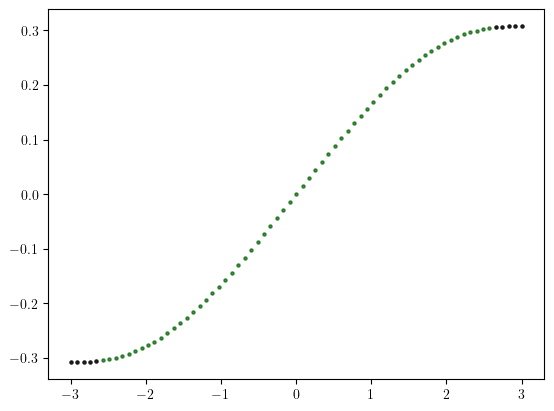

stability_plus:  0.0
5.800017142857143 1.3928571871428574


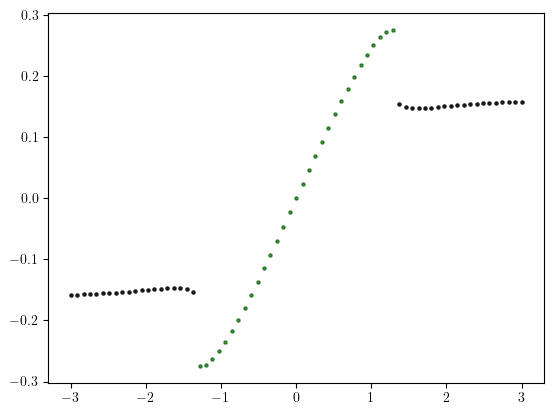

stability_plus:  0.0
3.5000500000000003 1.8928571671428576


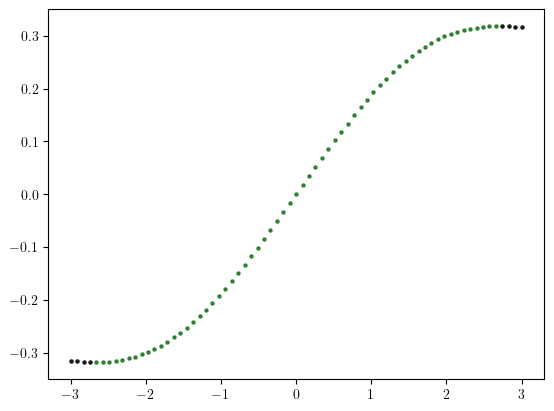

stability_plus:  0.0
5.0000285714285715 0.7857143542857143


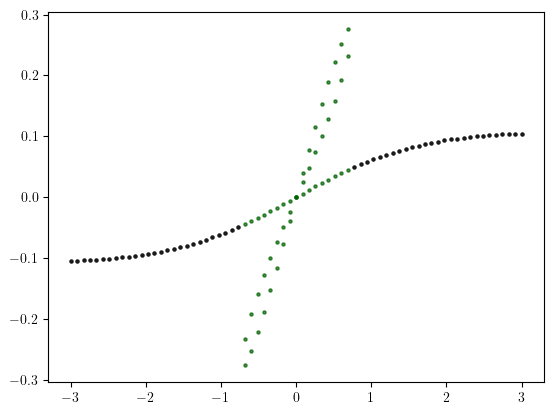

stability_plus:  0.0
6.30001 2.214285725714286


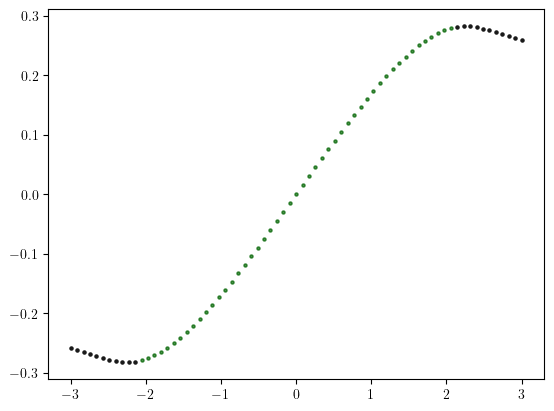

stability_plus:  0.0
5.700018571428572 1.928571451428572


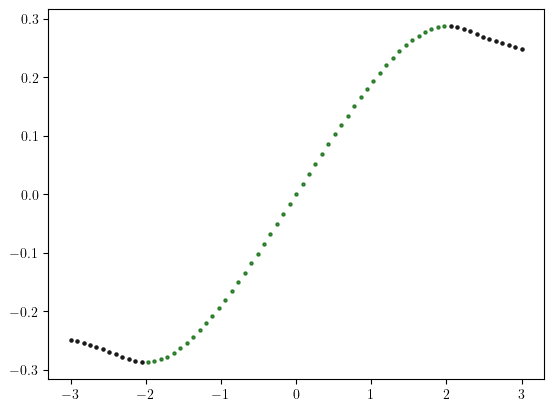

stability_plus:  1.0
0.5000928571428572 1.3928571871428574


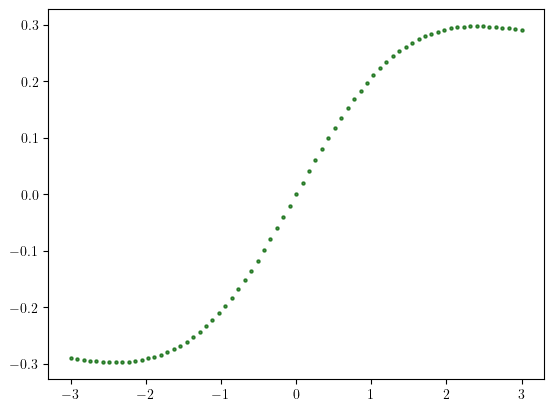

stability_plus:  1.0
0.9000871428571429 0.4642857957142858


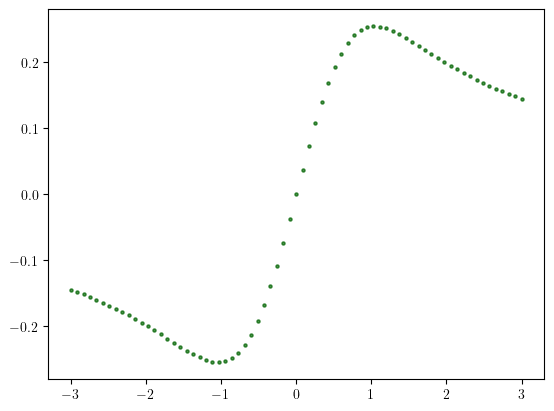

stability_plus:  1.0
0.3000957142857143 1.6785714614285718


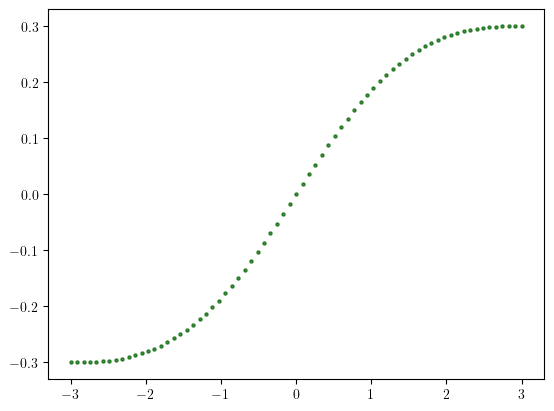

stability_plus:  0.0
5.600020000000001 1.0714286285714287


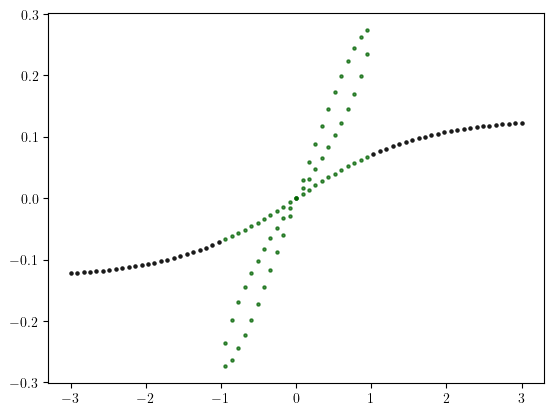

In [35]:
from random import random
colors = ['blue','orange','green']
alphas = [1,0.7,0.3]
for reps in range(10):
    s = 4*random()//3
    found = False
    while not found:
        ik = int(random()*k.shape[0])
        iw = int(random()*w.shape[0])
        if stability_plus[ik,iw,0]==s:
            found = True
    print('stability_plus: ',s)
    print(k[ik],w[iw])
    plt.figure()
    sols = [xsol[ik,iw,0,0]]
    for id in range(d.shape[0]):
        sols = find_continuation(sols[0],solution_number[ik,iw,id],ik,iw,id)
        for n in range(solution_number[ik,iw,id]):
            if stability_plus[ik,iw,id]:
                plt.scatter(d[id],xsol[ik,iw,id,n],s=5,color='#006400',alpha=0.7)
            else:
                plt.scatter(d[id],xsol[ik,iw,id,n],s=5,color = '0.1')
    plt.show()
    

12.235555555555555 3.1 -3.0
12.235555555555555 3.1 -2.933333333333333
12.235555555555555 3.1 -2.8666666666666667
12.235555555555555 3.1 -2.8
12.235555555555555 3.1 -2.7333333333333334
12.235555555555555 3.1 -2.6666666666666665
12.235555555555555 3.1 -2.6
12.235555555555555 3.1 -2.533333333333333
12.235555555555555 3.1 -2.466666666666667
12.235555555555555 3.1 -2.4
12.235555555555555 3.1 -2.3333333333333335
12.235555555555555 3.1 -2.2666666666666666
12.235555555555555 3.1 -2.2
12.235555555555555 3.1 -2.1333333333333333
12.235555555555555 3.1 -2.0666666666666664
12.235555555555555 3.1 -2.0666666666666664
12.235555555555555 3.1 -2.0666666666666664
12.235555555555555 3.1 -2.0
12.235555555555555 3.1 -2.0
12.235555555555555 3.1 -2.0
12.235555555555555 3.1 -1.9333333333333333
12.235555555555555 3.1 -1.9333333333333333
12.235555555555555 3.1 -1.9333333333333333
12.235555555555555 3.1 -1.8666666666666667
12.235555555555555 3.1 -1.8666666666666667
12.235555555555555 3.1 -1.8666666666666667
12.23

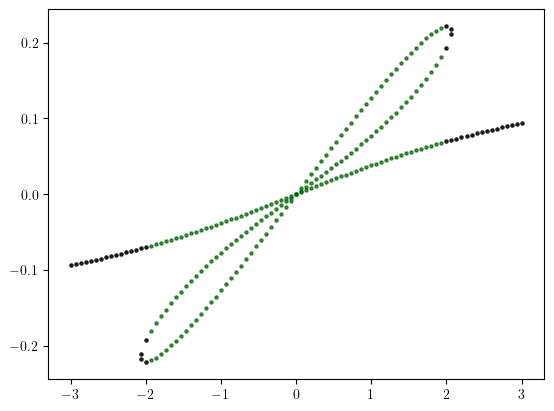

In [79]:
params = "12.235555555555555 3.1 2.0"
# params = "8.80002 2.1111111266666667 -1.6"
params=params.split()
params = [float(p) for p in params]
kval,wval,dval = params
ik, iw, id = find_index(kval,wval,dval)
# ik +=1
plt.figure()
sols = [xsol[ik,iw,0,0]]
for id in range(d.shape[0]):
    sols = find_continuation(sols[0],solution_number[ik,iw,id],ik,iw,id)
    for n in range(solution_number[ik,iw,id]):
        if stability_plus[ik,iw,id]:
            plt.scatter(d[id],xsol[ik,iw,id,n],s=5,color='#006400',alpha=0.7)
            print(kval,wval,d[id])
            # break
        else:
            plt.scatter(d[id],xsol[ik,iw,id,n],s=5,color = '0.1')
            print(kval,wval,d[id])
        
plt.show()

In [ ]:
# jk, jw,jd = 28,7,30
# kval, wval, dval = k[jk], w[jw], d[jd]

params = "12.235555555555555 3.1 2.333333333333333"
# params = "1.5000700000000002 1e-12 0.0"
params=params.split()
params = [float(p) for p in params]
kval,wval,dval = params
ik, iw, id = find_index(kval,wval,dval)

solnumb = solution_number[ik,iw,id]
ranges = [500,500,500]
for n in range(solnumb):
# plt.figure()
# for n in range(2):
    i=n
    n=1
    plt.figure()
    sol = xsol[ik,iw,id,n]
    y = ysol[ik,iw,id,n] 
    z= m_z(sol,y,wval,kval,Gam)
    plt.scatter(xsol[ik,iw,id,:solnumb],ysol[ik,iw,id,:solnumb],s=50,color='0')
    mstart = np.array([sol,y,z])#,dtype=np.float128)#*(1-1e-11)#+0.0001*np.array([1,0,1])
    # mstart = np.array([sol,0.1,-0.4])
    print(mstart)
    jac = jac_gl_np(0,mstart,wval,kval,dval,Gam,sgam)
    eigenvalues, vectors =np.linalg.eig(jac)
    print('eig: ',eigenvalues)
  
    print(gl2(0,mstart,wval,kval,dval,Gam,sgam))
    arguments = wval,kval, dval, Gam, sgam 
    traj = solve_ivp(gl2,(0,ranges[i]),mstart,args=arguments,rtol=1e-18,atol=1e-25)
    mend = np.array([traj.y[0][-1],traj.y[1][-1],traj.y[2][-1]])

    print('number of time steps: ',len(traj.t))

    plt.plot(traj.y[0],traj.y[1])
    plt.show()
    plt.figure()
    plt.plot(traj.t,traj.y[0])
    plt.show()
  


[0.03503901 0.22089484 0.43024051]
eig:  [ 4.53751914+0.8285921j  4.53751914-0.8285921j -0.8287986 +0.j       ]
[-1.11463616e-12  2.76534351e-12  0.00000000e+00]
number of time steps:  13026


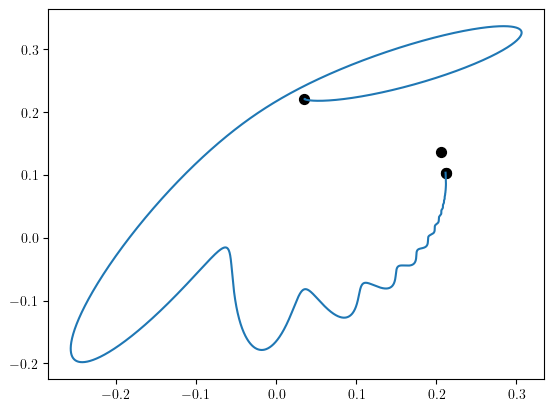

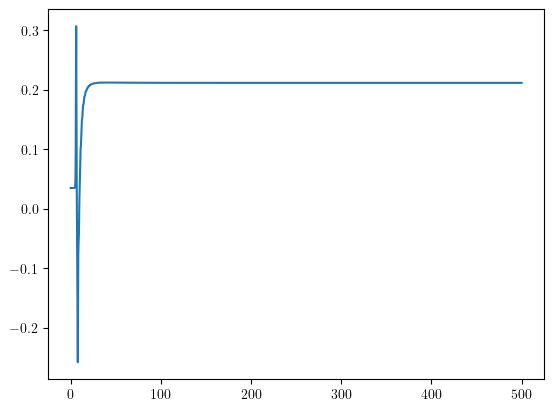

[0.21144207 0.103661   0.07903805]
eig:  [-0.1195436 +3.6060423j -0.1195436 -3.6060423j -0.04186891+0.j       ]
[ 1.66533454e-16 -1.52655666e-16  0.00000000e+00]
number of time steps:  803


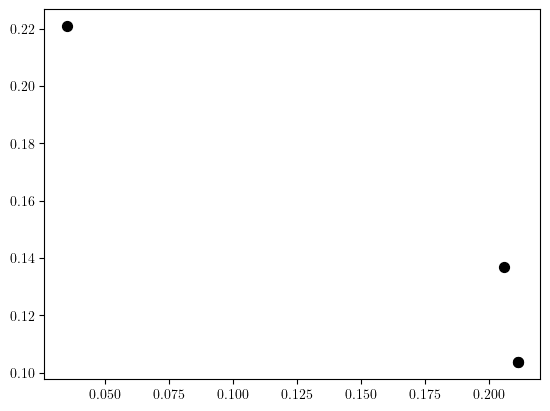

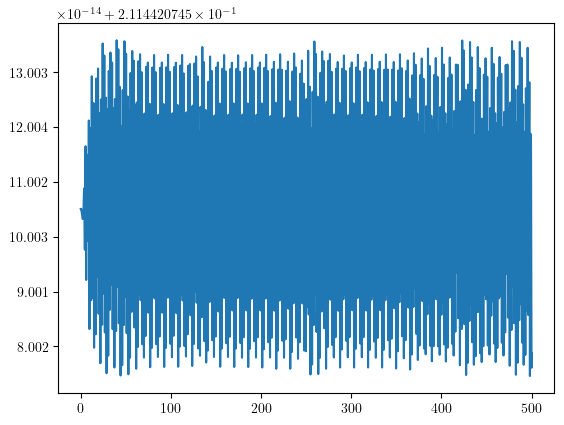

[0.20615295 0.137005   0.08956822]
eig:  [-0.0353465 +3.41199587j -0.0353465 -3.41199587j  0.04540942+0.j        ]
[4.71844785e-16 2.02615702e-15 0.00000000e+00]
number of time steps:  1089


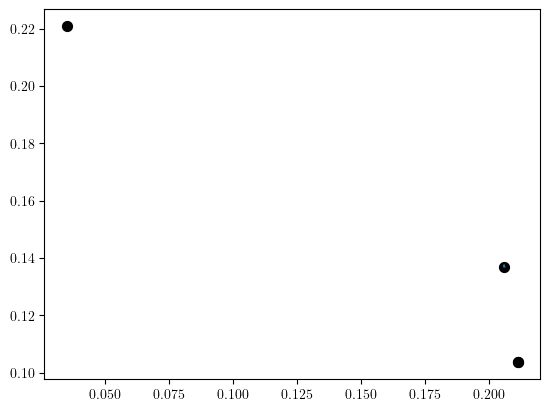

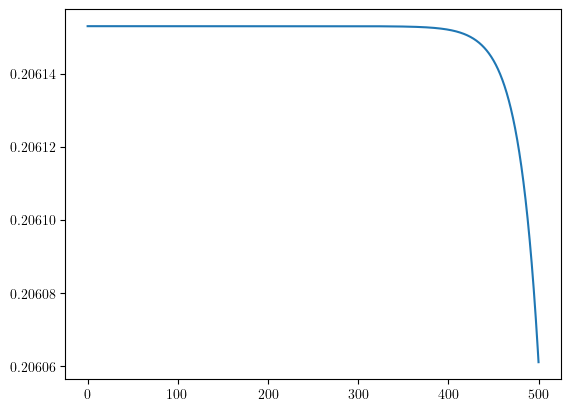

[0.21144215 0.10365989 0.07903773]
eig:  [-0.11954618+3.6060484j -0.11954618-3.6060484j -0.04187144+0.j       ]
[2.63073617e-08 3.32197043e-08 0.00000000e+00]
number of time steps:  1364


/usr/lib/python3/dist-packages/scipy/integrate/_ivp/common.py:47: UserWarning: At least one element of `rtol` is too small. Setting `rtol = np.maximum(rtol, 2.220446049250313e-14)`.
  warn("At least one element of `rtol` is too small. "


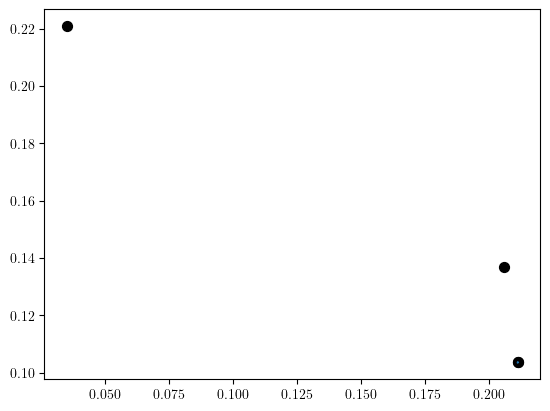

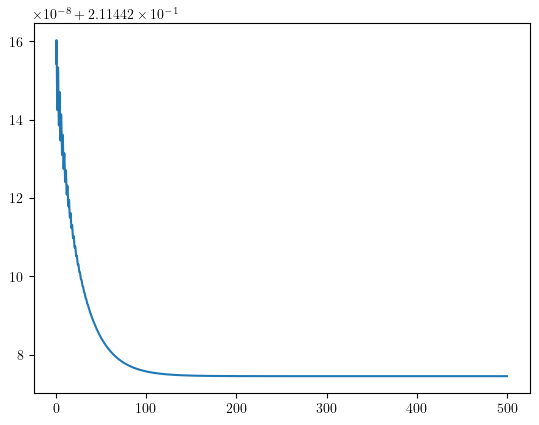

In [102]:
# jk, jw,jd = 28,7,30
# kval, wval, dval = k[jk], w[jw], d[jd]

params = "12.14 2.4333333333333336 1.4666666666666668"
# params = "1.5000700000000002 1e-12 0.0"
params=params.split()
params = [float(p) for p in params]
kval,wval,dval = params
ik, iw, id = find_index(kval,wval,dval)
# if dval>=0:
#     s=1
#     yofx = y1ofx
# else:
#     s=2
#     yofx = y2ofx
solnumb = solution_number[ik,iw,id]
ranges = [500,500,500,500]
for n in range(solnumb):
# plt.figure()
# for n in range(2):
    i=n
    # n=1
    plt.figure()
    sol = xsol[ik,iw,id,n]
    y = ysol[ik,iw,id,n] 
    z= m_z(sol,y,wval,kval,Gam)
    plt.scatter(xsol[ik,iw,id,:solnumb],ysol[ik,iw,id,:solnumb],s=50,color='0')
    mstart = np.array([sol,y,z])#,dtype=np.float128)#*(1-1e-11)#+0.0001*np.array([1,0,1])
    # mstart = np.array([sol,0.1,-0.4])
    print(mstart)
    jac = jac_gl_np(0,mstart,wval,kval,dval,Gam,sgam)
    eigenvalues, vectors =np.linalg.eig(jac)
    print('eig: ',eigenvalues)
    # print(kval,wval,dval)
    print(gl2(0,mstart,wval,kval,dval,Gam,sgam))
    arguments = wval,kval, dval, Gam, sgam 
    traj = solve_ivp(gl2,(0,ranges[i]),mstart,args=arguments,rtol=1e-18,atol=1e-25)
    mend = np.array([traj.y[0][-1],traj.y[1][-1],traj.y[2][-1]])
    # print(gl_np(0,mend,wval,kval,dval,Gam,sgam))
    # print('diff start-end',mend-mstart)
    # jac = jac_gl_np(0,mend,wval,kval,dval,Gam,sgam)
    # eigenvalues, vectors =np.linalg.eig(jac.astype(np.float64))
    # print('eig: ',eigenvalues)
    print('number of time steps: ',len(traj.t))
    # plt.plot(traj.y[0][10000:],traj.y[1][10000:])
    # plt.show()
    # plt.figure()
    # plt.plot(traj.t[10000:],traj.y[0][10000:])
    plt.plot(traj.y[0],traj.y[1])
    plt.show()
    plt.figure()
    plt.plot(traj.t,traj.y[0])
    # plt.plot(traj.t,traj.y[1])
    # plt.plot(traj.t,traj.y[2])
    # plt.scatter([traj.t[-1] for i in range(solnumb)],xsol[ik,iw,id,:solnumb],s=10,color='#01153E')
    # plt.scatter([traj.t[-1] for i in range(solnumb)],ysol[ik,iw,id,:solnumb],s=10,color='#FE420F')
    # plt.scatter([traj.t[-1] for i in range(solnumb)],m_z(xsol[ik,iw,id,:solnumb],ysol[ik,iw,id,:solnumb],wval,kval,Gam),s=10,color='#808000')
    plt.show()
    # break
# plt.figure()
# plt.plot(traj.y[0][800:],traj.y[1][800:])
# plt.show()


In [103]:
xsol[ik,iw,id,1]-xsol[ik,iw,id,solnumb-1]

-7.985381500486e-08

4.0 4.0


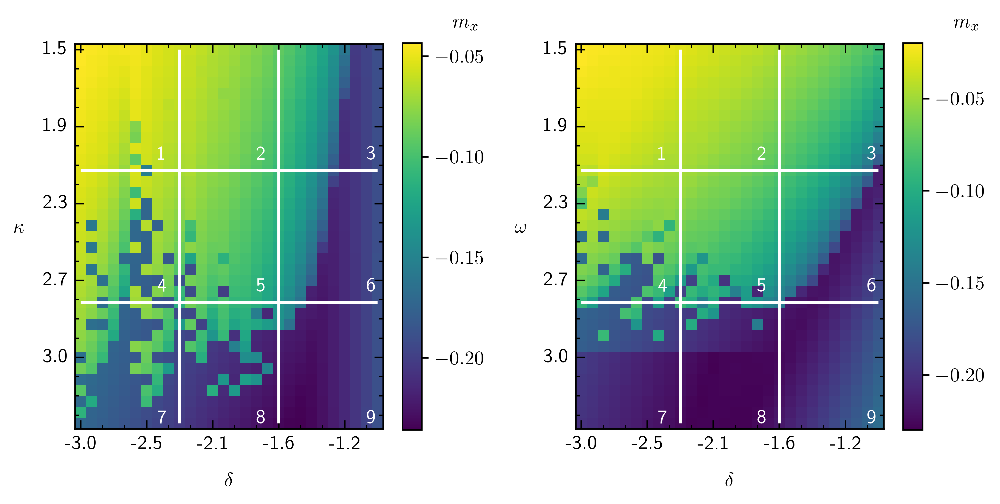

In [292]:
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png')
setup.fig_width= 20.6*cm
setup.fig_height=12*cm #29.1*cm
# im1=ax[0,0].imshow(plots[i][0],cmap=colormap)
setup.DEFAULT_HEAT_EXTEND =  im1.get_extent()#(-0.5,64.5,39.5,-0.5)#
fig, ax = setup.return_fig(shape=(1,2),dots_per_inch=600)


# plots = [stab_xsol,stab_ysol,stab_zsol]
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=6,\
                        xtick_step_minor=2,\
                            ytick_step_major=7,\
                                ytick_step_minor=1.75)
trash, xw, yw, trash=im1.get_extent()#(-0.5,39.5,29.5,-0.5)#
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step
print(numb_xticks,numb_yticks)


param_mapw = w_cutarray[gridpoints-35:,:28,0]
xshape = param_mapw.shape[0]
yshape = param_mapw.shape[1]
checkxw = [i*xshape//3 for i in range(1,4)]
checkyw = [i*yshape//3 for i in range(1,4)]
param_mapk = k_cutarray[:35,:28,0]
xshape = param_mapk.shape[0]
yshape = param_mapk.shape[1]
checkxk = [i*xshape//3 for i in range(1,4)]
checkyk = [i*yshape//3 for i in range(1,4)]
# checky.append(yshape)

# for i in range(param_map.shape[0]):
#     for j in range(param_map.shape[1]):
        
#         if np.any(i==checkx) or np.any(j==checky):
#             param_map[i,j]=np.nan
# fig, ax = plt.subplots(1,1)
# ax.imshow(param_map[::-1,:])
im1=ax[0].imshow(param_mapw[::-1,:],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
cbar1 = fig.colorbar(im1,ax=ax[0],orientation='vertical',shrink=0.755,ticks=ticker.MultipleLocator(0.05))
tickformat1 = Format(xscale=d[:28],yscale=w[:35],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
ax[0].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[0].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
# cbar1.set_label(label=r'$m_x$',loc='top',rotation=0,labelpad=-5)
ax[0].text(x=33.84,y=-2,s=r'$m_x$')
ax[0].set_xlabel(r'$\delta$',labelpad=10)
ax[0].set_ylabel(r"$\kappa$",rotation=0,labelpad=12)
# ax[0].set_title(title[i][0],loc='center',y=-0.45,fontsize=9)        

ax[0].hlines(checkxw[:-1],0,yshape-1,colors='1')
ax[0].vlines(checkyw[:-1],0,xshape-1,colors='1')
for i in range(3):
    for j in range(3):
        ax[0].text(x=checkyw[j]-2,y=checkxw[i]-1,s='{:d}'.format(i*3+j+1),color='1')

im2=ax[1].imshow(param_mapk[:,:],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
cbar2 = fig.colorbar(im2,ax=ax[1],orientation='vertical',shrink=0.755,ticks=ticker.MultipleLocator(0.05))
tickformat1 = Format(xscale=d[:28],yscale=w[:35],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
ax[1].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[1].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
# cbar1.set_label(label=r'$m_x$',loc='top',rotation=0,labelpad=-5)
ax[1].text(x=33.84,y=-2,s=r'$m_x$')
ax[1].set_xlabel(r'$\delta$',labelpad=10)
ax[1].set_ylabel(r"$\omega$",rotation=0,labelpad=12)
# ax[1].set_title(title[i][0],loc='center',y=-0.45,fontsize=9)        

ax[1].hlines(checkxk[:-1],0,yshape-1,colors='1')
ax[1].vlines(checkyk[:-1],0,xshape-1,colors='1')
for i in range(3):
    for j in range(3):
        ax[1].text(x=checkyk[j]-2,y=checkxk[i]-1,s='{:d}'.format(i*3+j+1),color='1')
    
# plt.xlim(0,yshape-1)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'combined_spec_sec.png',bbox_inches='tight')
plt.subplots_adjust(wspace=0.3)
plt.show()

4.0 4.0


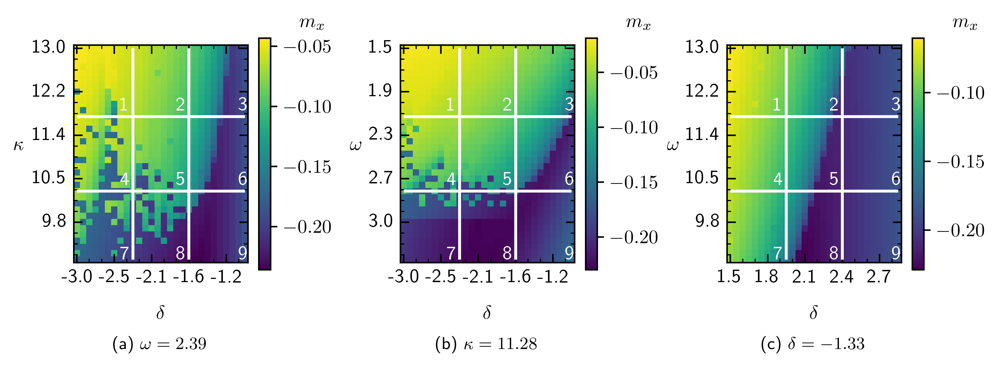

In [223]:
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png')
setup.fig_width= 20.6*cm
setup.fig_height=12*cm #29.1*cm
# im1=ax[0,0].imshow(plots[i][0],cmap=colormap)
setup.DEFAULT_HEAT_EXTEND =  im1.get_extent()#(-0.5,64.5,39.5,-0.5)#
fig, ax = setup.return_fig(shape=(1,3),dots_per_inch=600)


# plots = [stab_xsol,stab_ysol,stab_zsol]
tickp = TickProperties(SZX=True,SZY=True,\
                       xtick_step_major=6,\
                        xtick_step_minor=2,\
                            ytick_step_major=7,\
                                ytick_step_minor=1.75)
trash, xw, yw, trash=im1.get_extent()#(-0.5,39.5,29.5,-0.5)#
numb_xticks = xw//tickp.major_xtick_step
numb_yticks = yw//tickp.major_ytick_step
print(numb_xticks,numb_yticks)


param_mapw = w_cutarray[gridpoints-35:,:28,0]
xshape = param_mapw.shape[0]
yshape = param_mapw.shape[1]
checkxw = [i*xshape//3 for i in range(1,4)]
checkyw = [i*yshape//3 for i in range(1,4)]
param_mapk = k_cutarray[:35,:28,0]
xshape = param_mapk.shape[0]
yshape = param_mapk.shape[1]
checkxk = [i*xshape//3 for i in range(1,4)]
checkyk = [i*yshape//3 for i in range(1,4)]
param_mapd = d_cutarray[gridpoints-35:,:28,0]
xshape = param_mapd.shape[0]
yshape = param_mapd.shape[1]
checkxd = [i*xshape//3 for i in range(1,4)]
checkyd = [i*yshape//3 for i in range(1,4)]
# checky.append(yshape)

# for i in range(param_map.shape[0]):
#     for j in range(param_map.shape[1]):
        
#         if np.any(i==checkx) or np.any(j==checky):
#             param_map[i,j]=np.nan
# fig, ax = plt.subplots(1,1)
# ax.imshow(param_map[::-1,:])
im1=ax[0].imshow(param_mapw[::-1,:],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
cbar1 = fig.colorbar(im1,ax=ax[0],orientation='vertical',shrink=0.46,ticks=ticker.MultipleLocator(0.05))
tickformat1 = Format(xscale=d[:28],yscale=k[gridpoints-35:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[0].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formatx0))
ax[0].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[0].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[0].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[0].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[0].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat1.formaty1))
# cbar1.set_label(label=r'$m_x$',loc='top',rotation=0,labelpad=-5)
ax[0].text(x=35.8,y=-3.4,s=r'$m_x$')
ax[0].set_xlabel(r'$\delta$',labelpad=10)
ax[0].set_ylabel(r"$\kappa$",rotation=0,labelpad=7)
ax[0].set_title('(a) $\\omega={:.2f}$'.format(w[w_cut]),loc='center',y=-0.45,fontsize=9)        

ax[0].hlines(checkxw[:-1],0,yshape-1,colors='1')
ax[0].vlines(checkyw[:-1],0,xshape-1,colors='1')
for i in range(3):
    for j in range(3):
        ax[0].text(x=checkyw[j]-2,y=checkxw[i]-1,s='{:d}'.format(i*3+j+1),color='1')

im2=ax[1].imshow(param_mapk[:,:],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
cbar2 = fig.colorbar(im2,ax=ax[1],orientation='vertical',shrink=0.46,ticks=ticker.MultipleLocator(0.05))
tickformat2 = Format(xscale=d[:28],yscale=w[:35],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[1].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formatx0))
ax[1].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[1].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[1].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[1].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[1].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat2.formaty1))
# cbar1.set_label(label=r'$m_x$',loc='top',rotation=0,labelpad=-5)
ax[1].text(x=35.8,y=-3.4,s=r'$m_x$')
ax[1].set_xlabel(r'$\delta$',labelpad=10)
ax[1].set_ylabel(r"$\omega$",rotation=0,labelpad=7)
ax[1].set_title('(b) $\\kappa={:.2f}$'.format(k[k_cut]),loc='center',y=-0.45,fontsize=9)        

ax[1].hlines(checkxk[:-1],0,yshape-1,colors='1')
ax[1].vlines(checkyk[:-1],0,xshape-1,colors='1')
for i in range(3):
    for j in range(3):
        ax[1].text(x=checkyk[j]-2,y=checkxk[i]-1,s='{:d}'.format(i*3+j+1),color='1')

im3=ax[2].imshow(param_mapd[::-1,:],cmap=colormap)#,extent=(-0.5,64.5,39.5,-0.5))
cbar3 = fig.colorbar(im3,ax=ax[2],orientation='vertical',shrink=0.46,ticks=ticker.MultipleLocator(0.05))
tickformat3 = Format(xscale=w[:28],yscale=k[gridpoints-35:][::-1],xprec="{:.1f}",yprec="{:.1f}",numb_xticks=numb_xticks,numb_yticks=numb_yticks)
ax[2].xaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formatx0))
ax[2].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
ax[2].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
ax[2].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
ax[2].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
ax[2].yaxis.set_major_formatter(ticker.FuncFormatter(tickformat3.formaty1))
# cbar1.set_label(label=r'$m_x$',loc='top',rotation=0,labelpad=-5)
ax[2].text(x=35.8,y=-3.4,s=r'$m_x$')
ax[2].set_xlabel(r'$\delta$',labelpad=10)
ax[2].set_ylabel(r"$\omega$",rotation=0,labelpad=7)
ax[2].set_title('(c) $\\delta={:.2f}$'.format(d[d_cut]),loc='center',y=-0.45,fontsize=9)        

ax[2].hlines(checkxk[:-1],0,yshape-1,colors='1')
ax[2].vlines(checkyk[:-1],0,xshape-1,colors='1')
for i in range(3):
    for j in range(3):
        ax[2].text(x=checkyk[j]-2,y=checkxk[i]-1,s='{:d}'.format(i*3+j+1),color='1')
# plt.xlim(0,yshape-1)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'combined_spec_sec.png',bbox_inches='tight')
plt.subplots_adjust(wspace=0.5)
plt.show()

In [77]:

xkcut=[]
ywcut = []
xwcut = []
ydcut =[]
xdcut =[]
def npborder(border_kcut,cut_dim,cutval):
    ykcut =[]
    for i in range(gridpoints):
        ypos = None
        for j in range(gridpoints):
            if border_kcut[i,j]:
                ypos=j
        if cut_dim[i]>=cutval:
            xkcut = i
            break
        ykcut.append(ypos)
        if j>gridpoints//2:
            break
    ykcut= max(ykcut)
    return xkcut, ykcut

# cutk = npborder(border_kcut)
# cutw = npborder(border_wcut)
# cutd = npborder(border_dcut)

# border_kcut = border_kcut[gridpoints-35:,:28]
# border_wcut = border_wcut[:28,:35]
k_cut_traj = np.load('4.4k13_1.5w5.5_3d/k_cut_traj4.npz')
w_cut_traj = np.load('4.4k13_1.5w5.5_3d/w_cut_traj4.npz')
d_cut_traj = np.load('4.4k13_1.5w5.5_3d/d_cut_traj4.npz')

In [48]:
for i in range(border_array.shape[0]):
    for j in range(border_array.shape[1]):
        print(stability_plus[gridpoints-35+i,w_cut,j],end='')
    print('')

0000000000000000000011111111
0000000000000000000011111111
0000000000000000000011111111
0000000000000000000011111111
0000000000000000000011111111
0000000000000000000001111111
0000000000000000000001111111
0000000000000000000001111111
0000000000000000000001111111
0000000000000000000001111111
0000000000000000000000111111
0000000000000000000000111111
0000000000000000000000111111
0000000000000000000000111111
0000000000000000000000111111
0000000000000000000000111111
0000000000000000000000011111
0000000000000000000000011111
0000000000000000000000011111
0000000000000000000000011111
0000000000000000000000011111
0000000000000000000000011111
0000000000000000000000001111
0000000000000000000000001111
0000000000000000000000001111
0000000000000000000000001111
0000000000000000000000001111
0000000000000000000000001111
0000000000000000000000001111
0000000000000000000000001111
0000000000000000000000000111
0000000000000000000000000111
0000000000000000000000000111
0000000000000000000000000111
00000000000000

In [167]:
d_cut_traj = d_cut_traj['arr_0']

In [19]:
def choose_param(xgrid,ygrid,array,xoffset,yoffset):
    while True:
        i, j = int(random()*array.shape[0]),  int(random()*array.shape[1])
        if i>=xgrid[0] and i <xgrid[1] and j>=ygrid[0] and j<ygrid[1]:
            # print('first')
            # if stability_plus[k_cut,i+xoffset,j+yoffset]==0:
            if stability_plus[i+xoffset,w_cut,j+yoffset]==0:
                # print('second')
                break
    return i, j
import os
def p_from_grid(gridx,gridy,array,xoffset,yoffset):
    xshape = array.shape[0]
    yshape = array.shape[1]
    points = np.zeros((gridx,gridy,2))
    for i in range(gridx):
        for j in range(gridy):
            points[i,j]= choose_param((i*xshape//gridx,(i+1)*xshape//gridx),(j*yshape//gridy,(j+1)*yshape//gridy),array,xoffset,yoffset)
    return points.astype(np.int32)

# border_array = np.ones_like(border_kcut[gridpoints-35:,:28])

# params = p_from_grid(3,3,param_map,0,0)
# ps =[]
# print(params)
# for i in range(params.shape[0]):
#     for j in range(params.shape[1]):
#         # os.mkdir(f'trajectoties/k_cut/parcel_{i}_{j}')
#         # numb = len(os.listdir(f'trajectoties/k_cut33/parcel_{i}_{j}'))

#         # trajs = w_cut_traj[gridpoints-35+params[i,j,0],params[i,j,1]]
#         trajs = k_cut_traj[params[i,j,0],params[i,j,1]]
#         indexk = k_cut
#         indexw = params[i,j,0]
#         indexd = params[i,j,1]
#         print(trajs.shape)
#         print(k[indexk],w[indexw],d[indexd])
#         print('stability: ',stability_plus[indexk,indexw,indexd])
#         if stability_plus[indexk,indexw,indexd]==0:
#             fig, ax = plt.subplots(1,2)
#             for l in range(trajs.shape[0]):
#                 if i==1 and j==0:
#                     ps.append(trajs[l,0,1:])
#                     print('chosen')
#                 # print(trajs[l])
#                 print('points: ',trajs[l,0,1:])
#                 ax[0].scatter(trajs[l,2000:,1],trajs[l,endcut:,2])
#                 ax[1].scatter(trajs[l,2000:,2],trajs[l,2000:,3])

#             # plt.savefig(f'trajectoties/k_cut33/parcel_{i}_{j}/'+'plot{:.3f}_{:.3f}_{:.3f}.png'.format(k[gridpoints-35+params[i,j,0]],w[w_cut],d[params[i,j,1]]))
#             plt.show()
            
#         # break
    # break



<function matplotlib.pyplot.show(close=None, block=None)>

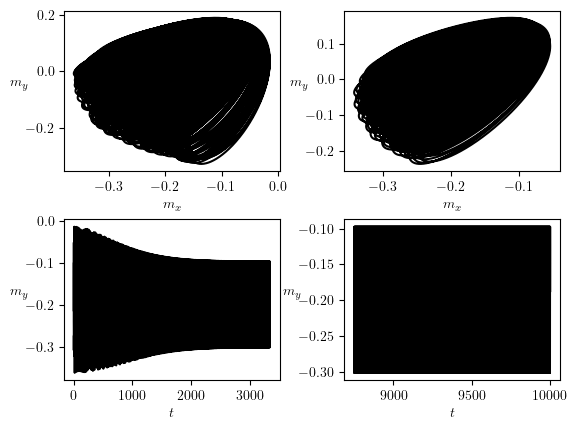

In [142]:
from random import random
def starting_points(numb):
    points = np.zeros((numb,3))
    for i in range(numb):
        phi = random()*2*np.pi
        theta = random()*np.pi
        r = random()*0.5
        points[i,:] = r*np.sin(theta)*np.cos(phi), r*np.sin(theta)*np.sin(phi), r*np.cos(theta)
    return points


Gam =1
sgam =0.2

tickp = TickProperties(xtick_step_major=0.1,\
                        xtick_step_minor=0.02,\
                            ytick_step_major=0.1,\
                                ytick_step_minor=0.02)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)

# fig, ax = setup.return_fig(shape=(2,2),dots_per_inch=600)
fig, ax = plt.subplots(2,2)
colors = ['0','0.3','0.6']
trajs = [[],[]]
params = []
spoints = []
stabi =1 
# p= np.array([-0.27593173, -0.2208139,   0.15394378])
# traj = solve_ivp(gl2,(0,1000),y0=np.array([-0.27593173, -0.2208139,   0.15394378]),args=arguments,method='LSODA',rtol=1e-13,atol=1e-25)
for reps in range(2):
    p= np.array([-0.27593173, -0.2208139,   0.15394378])*(1-reps*1/4)
    traj = solve_ivp(gl2,(0,10000),y0=p,args=arguments,rtol=1e-13,atol=1e-25)
    # while True:
    #     ik, iw, id = (np.array([random(),random(),random()])*gridpoints).astype(np.int64)
    #     if stability_plus[ik,iw,id]==stabi:
    #         stabi=0
    #         break

   
    ik, iw, id = find_index(12.6,w[20],-2.5)
    kval, wval, dval = k[-15], w[20], d[id]
    # arguments = wval,kval, dval, Gam, sgam 
    # traj = solve_ivp(gl2,(0,300),np.array([0,0,0]),args=arguments,rtol=1e-13,atol=1e-25)
    params.append([ik,iw,id])
    ps = starting_points(3)
    spoints.append(ps)
    for i,pi in enumerate(ps):
        arguments = wval,kval, dval, Gam, sgam 
        # traj = solve_ivp(gl2,(0,400),p,args=arguments,method='LSODA',rtol=1e-13,atol=1e-25)
        trajs[reps].append(traj)
        steps = len(traj.t)
        ax[0,reps].plot(traj.y[0],traj.y[1],color=colors[i])
        ax[0,reps].scatter(p[0],p[1],s=10,color=colors[i])
        ax[0,reps].scatter(p[0],p[1],s=10,color=colors[i])
        if reps:
            ax[1,reps].plot(traj.t[-steps//8:],traj.y[0][-steps//8:],color=colors[i])
        else:
            ax[1,reps].plot(traj.t[:steps//3],traj.y[0][:steps//3],color=colors[i])
        break
    ax[0,reps].set_xlabel(r'$m_x$')
    ax[0,reps].set_ylabel(r'$m_y$',rotation=0,labelpad=5)
    ax[1,reps].set_xlabel(r'$t$')
    ax[1,reps].set_ylabel(r'$m_y$',rotation=0,labelpad=5)
    # break
plt.subplots_adjust(hspace=0.3,wspace=0.3)
plt.show

KeyboardInterrupt: 

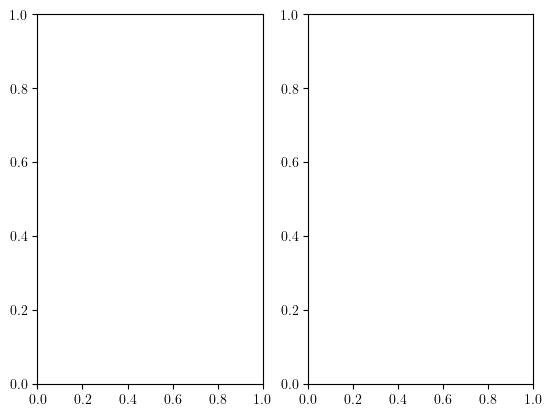

In [78]:


tickp = TickProperties(xtick_step_major=0.1,\
                        xtick_step_minor=0.02,\
                            ytick_step_major=0.1,\
                                ytick_step_minor=0.02)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)

# fig, ax = setup.return_fig(shape=(2,2),dots_per_inch=600)
fig, ax = plt.subplots(1,2)
colors = ['0','0.3','0.6']
trajs = [[],[]]
params = []
spoints = []
stabi =1 

# def calc_traj(kv,wv,dv):

   
#     ik, iw, id = find_index(kv,wv,dv)
#     print(stability_plus[ik,iw,id])
#     points = w_cut_traj[ik,id,:,0,1:]
#     kval, wval, dval = k[ik], w[w_cut], d[id]
#     trajs= []
#     params.append([ik,iw,id])
#     # ps = starting_points(3)
#     spoints.append(points)
#     for i,p in enumerate(points):
#         arguments = wval,kval, dval, Gam, sgam 
#         traj = solve_ivp(gl2,(0,5000),p,args=arguments,method='LSODA')
#         trajs.append(traj)
#         # steps = len(traj.t)

#     return points, trajs

def calc_traj(kv,wv,dv):

   
    ik, iw, id = find_index(kv,wv,dv)
    
    print(stability_plus[ik,iw,id])
    # points = w_cut_traj[ik,id,:,0,1:]
    # points = k_cut_traj[iw,id,:,0,1:]
    # points = d_cut_traj[ik,iw,:,0,1:]
    # points = starting_points(5)
    kval, wval, dval = k[ik], w[iw], d[id]
    # print(kval,wval,dval)
    # return None, None
    trajs= []
    params.append([ik,iw,id])
    # ps = starting_points(3)
    spoints.append(points)
    for i,p in enumerate(points):
        arguments = wval,kval, dval, Gam, sgam 
        traj = solve_ivp(gl2,(0,50),p,args=arguments,method='LSODA')#,t_eval=np.arange(20000)/20000*5000)
        trajs.append(traj)
        # print(traj.y.shape)
        # steps = len(traj.t)

    return points, trajs

param_mapw = w_cutarray[gridpoints-35:,:28,0]

psample = np.zeros((3,3,3))
indices = p_from_grid(3,3,param_mapw,gridpoints-35,0)
for i in range(3):
    for j in range(3):
        psample[i,j] = k[gridpoints-35+indices[i,j,0]], w[w_cut], d[indices[i,j,1]]
        # psample[i,j] = k[k_cut], w[indices[i,j,0]], d[indices[i,j,1]]
        # psample[i,j] = k[gridpoints-35+indices[i,j,0]], w[indices[i,j,1]], d[d_cut]

psample[1,1] =10.993, 2.388, -2.14
psample[0,0]= 9.94, 2.388, -2.94
psample[0,2]=10.51, 2.388, -1.8
psample[1,0] = 11.55, 2.388, -2.54
psample[1,2] = 10.79, 2.388, -1.67
psample[2,0] = 11.94, 2.388, -2.67
psample = psample[::-1,:,:]
sample_traj = [[],[],[]]
sample_points = [[],[],[]]
for i in range(3):
    for j in range(3):
        p, t = calc_traj(*psample[i,j])
        sample_points[i].append(p)
        sample_traj[i].append(t)
# ps, trajs = calc_traj(10.516, 2.389, -2.733)

# for i in range(len(trajs)):
#     traj = trajs[i]
#     p = ps[i]
#     steps=len(traj.t)
#     ax[0].plot(traj.y[0][-steps//9:],traj.y[1][-steps//9:])#,color=colors[i])
#     # ax[0].scatter(p[0],p[1],s=10,color=colors[i])
#     # ax[0].scatter(p[0],p[1],s=10,color=colors[i])
    
#     ax[1].plot(traj.t[-steps//9:],traj.y[0][-steps//9:])#,color=colors[i])

    
        
#     ax[0].set_xlabel(r'$m_x$')
#     ax[0].set_ylabel(r'$m_y$',rotation=0,labelpad=5)
#     ax[1].set_xlabel(r'$t$')
#     ax[1].set_ylabel(r'$m_y$',rotation=0,labelpad=5)
#     # break
# plt.subplots_adjust(hspace=0.3,wspace=0.3)
# plt.show

10.993333333333332 2.388888888888889 -2.1333333333333333
10.993333333333332 2.388888888888889 -2.1333333333333333


<function matplotlib.pyplot.show(close=None, block=None)>

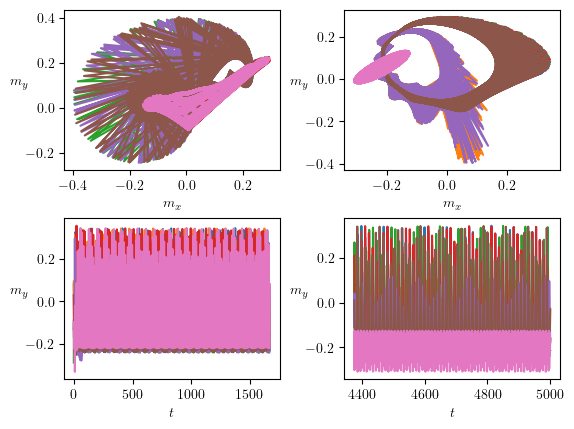

In [38]:

from random import random
def starting_points(numb):
    points = np.zeros((numb,3))
    for i in range(numb):
        phi = random()*2*np.pi
        theta = random()*np.pi
        r = random()*0.5
        points[i,:] = r*np.sin(theta)*np.cos(phi), r*np.sin(theta)*np.sin(phi), r*np.cos(theta)
    return points


Gam =1
sgam =0.2

tickp = TickProperties(xtick_step_major=0.1,\
                        xtick_step_minor=0.02,\
                            ytick_step_major=0.1,\
                                ytick_step_minor=0.02)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)

# fig, ax = setup.return_fig(shape=(2,2),dots_per_inch=600)
fig, ax = plt.subplots(2,2)
# colors = ['0','0.3','0.6']
trajs = [[],[]]
# params = []
spoints_save = []
stabi =1 
# p= np.array([-0.27593173, -0.2208139,   0.15394378])
# traj = solve_ivp(gl2,(0,1000),y0=np.array([-0.27593173, -0.2208139,   0.15394378]),args=arguments,method='LSODA',rtol=1e-13,atol=1e-25)
for reps in range(2):
    # p= np.array([-0.27593173, -0.2208139,   0.15394378])*(1-reps*1/4)
    # traj = solve_ivp(gl2,(0,10000),y0=p,args=arguments,rtol=1e-13,atol=1e-25)
    # while True:
    #     ik, iw, id = (np.array([random(),random(),random()])*gridpoints).astype(np.int64)
    #     if stability_plus[ik,iw,id]==stabi:
    #         stabi=0
    #         break

   
    ik, iw, id = find_index(10.993333333333332, 2.388888888888889 ,-2.1333333333333333)
    kval, wval, dval = k[ik], w[iw], d[id]
    print(kval,wval,dval)
    # ps=w_cut_traj[ik,id,:,0,1:]
    # print(ps.shape)
    # kval, wval, dval = k[-15], w[20], d[id]
    # arguments = wval,kval, dval, Gam, sgam 
    # traj = solve_ivp(gl2,(0,300),np.array([0,0,0]),args=arguments,rtol=1e-13,atol=1e-25)
    # params.append([ik,iw,id])
    ps = starting_points(7)
    # ps = [[-0.04053411,  0.00768117,  0.29319098],\
# [0.01488044 ,0.11139024, 0.01299483],\
#  [-0.10397106,  0.19822394, -0.16843735],\
# [ 0.00148165, -0.04023774 ,-0.03212243],\
#  [-0.27590903,  0.05384564,  0.06170684]]
    spoints_save.append(ps)
    for i,p in enumerate(ps):
        arguments = wval,kval, dval, Gam, sgam 
        traj = solve_ivp(gl2,(0,5000),p,args=arguments,method='LSODA',t_eval=np.arange(1,5001))#,rtol=1e-13,atol=1e-25)
        trajs[reps].append(traj)
        steps = len(traj.t)
        if reps:
            ax[0,reps].plot(traj.y[0][-steps//8:],traj.y[1][-steps//8:])#,color=colors[i])
        else:
            ax[0,reps].plot(traj.y[1][-steps//8:],traj.y[2][-steps//8:])#,color=colors[i])
        # ax[0,reps].scatter(p[0],p[1],s=10)#,color=colors[i])
        # ax[0,reps].scatter(p[0],p[1],s=10)#,color=colors[i])
        if reps:
            ax[1,reps].plot(traj.t[-steps//8:],traj.y[0][-steps//8:])#,color=colors[i])
        else:
            ax[1,reps].plot(traj.t[:steps//3],traj.y[0][:steps//3])#,color=colors[i])
        # break
    ax[0,reps].set_xlabel(r'$m_x$')
    ax[0,reps].set_ylabel(r'$m_y$',rotation=0,labelpad=5)
    ax[1,reps].set_xlabel(r'$t$')
    ax[1,reps].set_ylabel(r'$m_y$',rotation=0,labelpad=5)
    # break
plt.subplots_adjust(hspace=0.3,wspace=0.3)
plt.show()

In [48]:
trajs[1][0].y[0].shape
np.sum(np.abs(trajs[1][0].y[0]-trajs[1][1].y[0]))

645.3863086146237

In [224]:
def traj_dist(diff_max,a,b):
    endcut = int(1700)
    res = np.ones(diff_max)
    res[0]= np.sum(np.log(np.abs(a[-endcut:]-b[-endcut:])))/endcut
    for i in range(1,diff_max):
        res[i] = np.sum(np.log(np.abs(a[-endcut+i:]-b[-endcut:-i])))/(endcut-i)
    return res


def classify_traj(trajs):
    max_offset = 1300
    traj_classes = [trajs[0,0]]
    phase_map = np.zeros((trajs.shape[0],trajs.shape[1]))
    for i in range(trajs.shape[0]):
        for j in range(trajs.shape[1]):
            if i==0 and j==0:
                continue
            found = 0
            for c_index in range(len(traj_classes)):
                distance = traj_dist(max_offset,trajs[i,j,:,1],traj_classes[c_index][:,1])
                mind = min(distance)
                if mind<-4:
                    phase_map[i,j] = c_index
                    found = 1
                    break
            if found==0:
                phase_map[i,j] = c_index+1
                traj_classes.append(trajs[i,j])
                
    return traj_classes, phase_map
# ts = np.stack([tr.y for tr in trajs[1]],axis=2)
# ts = np.swapaxes(ts,0,2)
# # ts = np.swapaxes(ts,1,2)[:-1]
# ts = np.reshape(ts[1:],newshape=(2,3,ts.shape[1],ts.shape[2]))
# ts.shape
# # ts = np.array([[trajs[1][0],trajs[1][1],trajs[1][2]],[trajs[1][3],trajs[1][4],trajs[1][5]]])
# classes, pmap = classify_traj(ts)
# print(len(classes))
# plt.figure()
# for i in range(2):
#     for j in range(3):

#         plt.scatter(ts[i,j,:,0],ts[i,j,:,1])
# plt.show()
# plt.figure()
# for traj in classes:

#     plt.scatter(traj[:,0],traj[:,1])
# plt.show()

ValueError: need at least one array to stack

(3, 4000, 4)
(4000, 4)


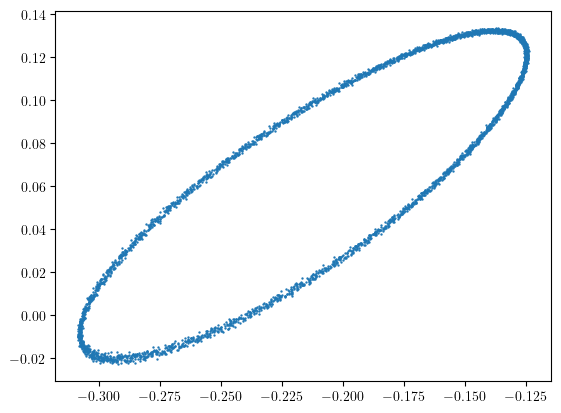

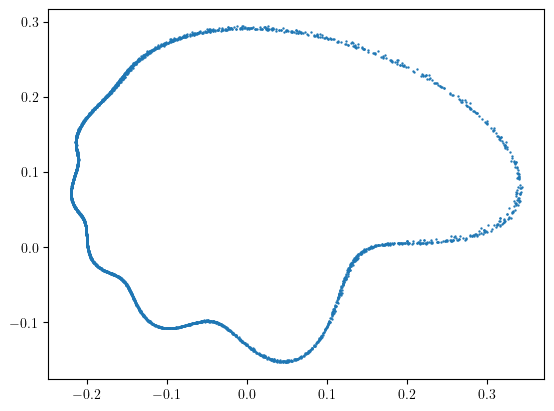

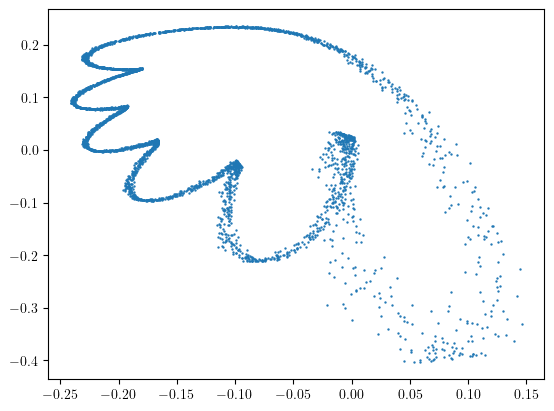

In [13]:
# classes = np.load('4.4k13_1.5w5.5_3d/mphase_traj_s.npz')['arr_0']
classes = np.load('4.4k13_1.5w5.5_3d/lc_classes_271.npz')['arr_0']
# map = np.load('4.4k13_1.5w5.5_3d/lc_phasemap_s_s.npz')['arr_0']
# classes , phase_map = classify_traj(trajs_mspace)
print(classes.shape)
print(classes[0].shape)
for i in range(len(classes)):
    # print(classes[i])
    plt.figure()
    plt.scatter(classes[i,:,1],classes[i,:,2])
    plt.show()


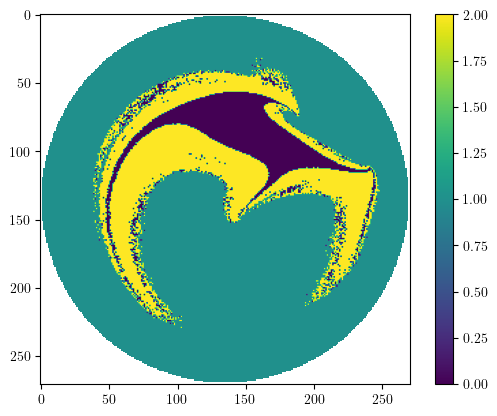

In [32]:
map = np.load('4.4k13_1.5w5.5_3d/lc_mphasemap_271.npz')['arr_0']
for i in range(map.shape[0]):
    for j in range(map.shape[1]):

        if map[i,j]==-1:
            map[i,j]=np.nan
plt.figure()
im = plt.imshow(map)
cbar = plt.colorbar(im)
plt.show()

In [16]:
mtraj = np.load('4.4k13_1.5w5.5_3d/mphase_traj_271.npz')['arr_0']


In [59]:
# plot classes
counter = 0

# plt.figure()
# plt.scatter(classes[0,:,1],classes[0,:,2])
# plt.show()
for i in range(map.shape[0]):
    for j in range(map.shape[1]):
        if map[i,j]==2 and np.linalg.norm(mtraj[i,j,0,1:])>0.31:
            start2=mtraj[i,j,0,1:]
        if map[i,j]==0:# and np.linalg.norm(mtraj[i,j,0,1:])>0.31:
            start0=mtraj[i,j,0,1:]
        if map[i,j]==1 and np.linalg.norm(mtraj[i,j,0,1:])>0.31:
            start1=mtraj[i,j,0,1:]

        

            # counter += 1
            # plt.figure()
            # plt.scatter(mtraj[i,j,:,1],mtraj[i,j,:,2])
            # plt.show()
            
ik, iw, id = find_index(10.993, 2.388, -2.15)
kval, wval, dval = k[ik], w[iw], d[id]
traj1 = solve_ivp(gl2,(0,10**4),y0=start1,args=(wval,kval,dval,1,0.2),method='LSODA',t_eval=np.linspace(9*10**3,10**4,2*10**5))
traj0 = solve_ivp(gl2,(0,10**4),y0=start0,args=(wval,kval,dval,1,0.2),method='LSODA',t_eval=np.linspace(9*10**3,10**4,2*10**5))
# traj = solve_ivp(gl2,(0,20000),y0=start,args=(kval,wval,dval,1,0.2),method='LSODA',t_eval=np.arange(20000))#,rtol=1e-12,atol=1e-25)
traj2 = solve_ivp(gl2,(0,10**6),y0=start2,args=(wval,kval,dval,1,0.2),method='LSODA',t_eval=np.linspace(9.99*10**5,10**6,2*10**5))


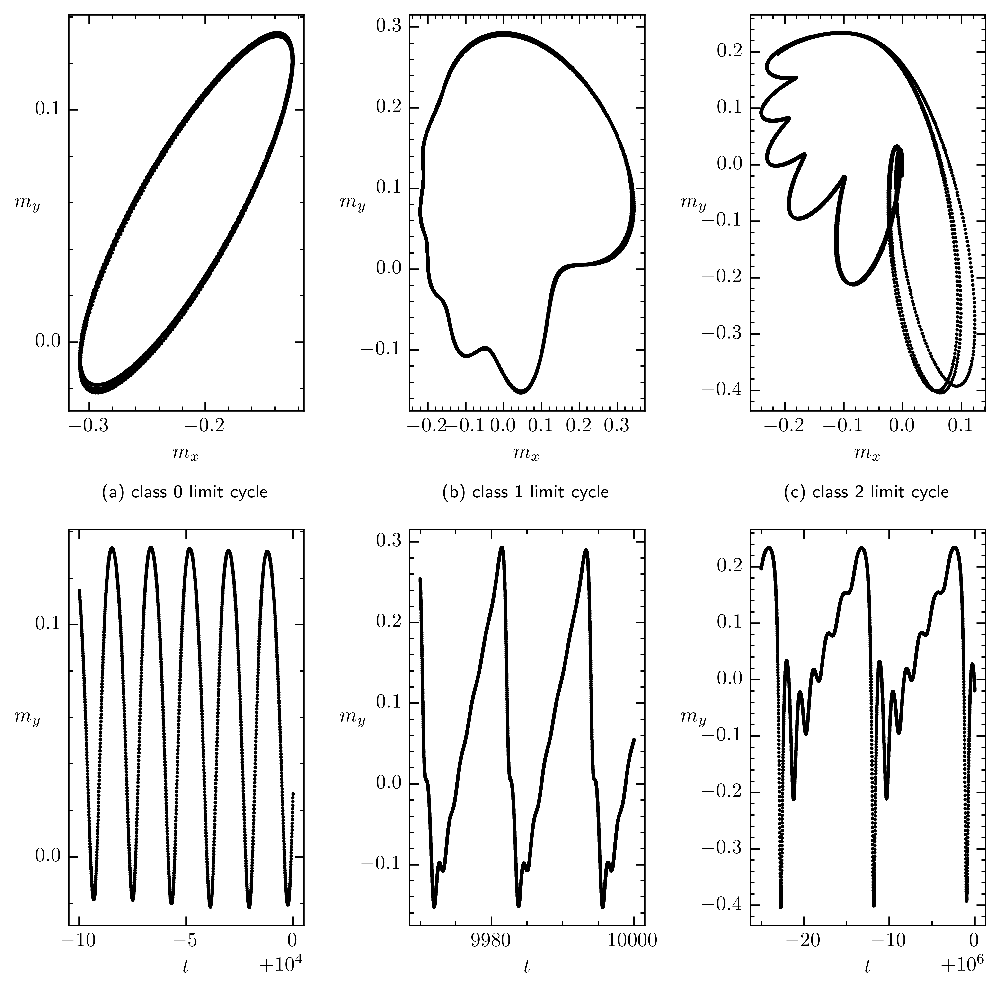

In [79]:
tickp = TickProperties(xtick_step_major=0.1,\
                        xtick_step_minor=0.02,\
                            ytick_step_major=0.1,\
                                ytick_step_minor=0.02)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)
# traj2 = traj
# traj2= np.row_stack((traj2.t,traj2.y))
# traj1= np.row_stack((traj1.t,traj1.y))
# traj0= np.row_stack((traj0.t,traj0.y))
titles = ['(a) class 0 limit cycle', '(b) class 1 limit cycle', '(c) class 2 limit cycle']
setup.fig_width= 20.6*cm
setup.fig_height=20.6*cm 
fig, ax = setup.return_fig(shape=(2,3),dots_per_inch=600,set_ticks=False)
plotst = [traj0[:,-2000:],traj1[:,-6000:],traj2[:,-5000:]]
# plotsy = [traj0.y[1,-2000:],traj1.y[1,-1000:],traj2.y[1,-100:]]
for i in range(3):
    
    ax[1,i].scatter(plotst[i][0,:],plotst[i][2,:],color='0')
    ax[1,i].xaxis.set_minor_locator(ticker.MultipleLocator(5))
    ax[1,i].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
    ax[1,i].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
    ax[1,i].set_xlabel(r'$t$')
    ax[1,i].set_ylabel(r'$m_y$',rotation=0)
    ax[0,i].scatter(plotst[i][1,:],plotst[i][2,:],color='0')
    ax[0,i].yaxis.set_major_locator(ticker.MultipleLocator(tickp.major_ytick_step))
    ax[0,i].yaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_ytick_step))
    ax[0,i].xaxis.set_major_locator(ticker.MultipleLocator(tickp.major_xtick_step))
    ax[0,i].xaxis.set_minor_locator(ticker.MultipleLocator(tickp.minor_xtick_step))
    ax[0,i].set_xlabel(r'$m_x$')
    ax[0,i].set_ylabel(r'$m_y$',rotation=0)
    ax[0,i].set_title(titles[i],loc='center',y=-0.25,fontsize=9)
plt.subplots_adjust(wspace=0.45,hspace=0.3)              
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'classes_plot_wcut.pdf',bbox_inches='tight')
plt.show()

In [228]:
classes , phase_map = classify_traj(trajs_mspace['arr_0'])
print(len(classes))
for c in classes:
    plt.figure()
    plt.scatter(c[:,1],c[:,2])
    plt.show()


KeyboardInterrupt: 

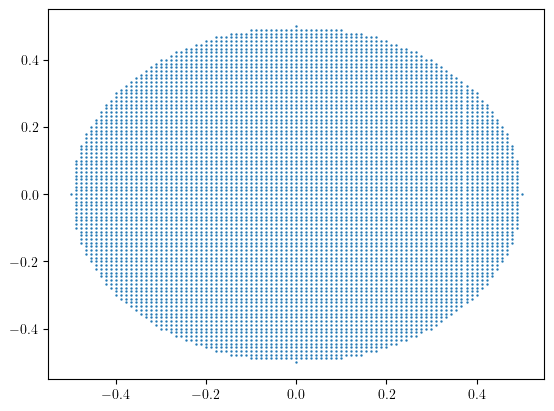

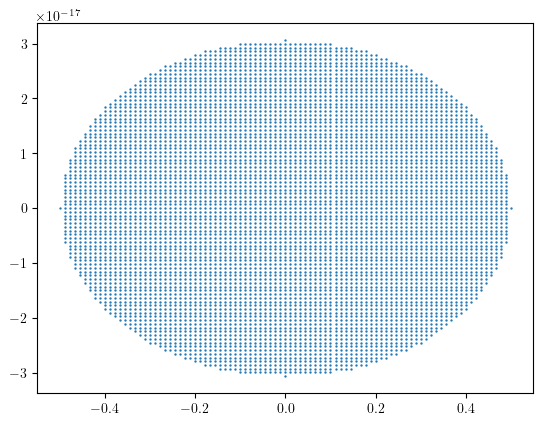

In [35]:
ik, iw, id = find_index(10.993, 2.388, -2.14)
kval, wval, dval = k[ik], w[iw], d[id]

alpha1 = np.pi/2
alpha2 = np.pi/3

def rma_x(alpha):
    row1 = [1,0,0]
    row2 = [0,np.cos(alpha),-np.sin(alpha)]
    row3 = [0,np.sin(alpha),np.cos(alpha)]
    return np.array([row1,row2,row3])

def rma_y(alpha):
    row1 = [np.cos(alpha),0,-np.sin(alpha)]
    row2 = [0,1,0]
    row3 = [np.sin(alpha),0,np.cos(alpha)]
    return np.array([row1,row2,row3])

def rma_z(alpha):
    row1 = [np.cos(alpha),-np.sin(alpha),0]
    row2 = [np.sin(alpha),np.cos(alpha),0]
    row3 = [0,0,1]
    return np.array([row1,row2,row3])
gridpoints = 91
cut1 = np.zeros((91,91,3))
middle = cut1.shape[0]//2
for i in range(cut1.shape[0]):
    for j in range(cut1.shape[1]):
        cut1[i,j,0]=i
        cut1[i,j,1]=j
        
cut1[:,:,0]-=middle
cut1[:,:,1]-=middle
cut1/=middle/0.5
for i in range(cut1.shape[0]):
    for j in range(cut1.shape[1]):
        if np.linalg.norm(cut1[i,j])>0.5:
            cut1[i,j] = np.nan
plt.figure()
plt.scatter(np.reshape(cut1[:,:,0],newshape=(gridpoints**2)),np.reshape(cut1[:,:,1],newshape=(gridpoints**2)))
plt.show()
rotz = rma_z(alpha1)
rotx = rma_x(alpha1)
cut1 = np.tensordot(cut1,rotx,axes=[2,1])
# cut1 = np.tensordot(rotx,cut1,(1,2))
cut1.shape
plt.figure()
plt.scatter(np.reshape(cut1[:,:,0],newshape=(gridpoints**2)),np.reshape(cut1[:,:,1],newshape=(gridpoints**2)))
plt.show()

In [25]:
a = np.reshape(np.arange(4),newshape=(2,2))
b = np.reshape(np.arange(50),newshape=(5,5,2))
np.tensordot(a,b,axes=[1,2])

array([[[  1,   3,   5,   7,   9],
        [ 11,  13,  15,  17,  19],
        [ 21,  23,  25,  27,  29],
        [ 31,  33,  35,  37,  39],
        [ 41,  43,  45,  47,  49]],

       [[  3,  13,  23,  33,  43],
        [ 53,  63,  73,  83,  93],
        [103, 113, 123, 133, 143],
        [153, 163, 173, 183, 193],
        [203, 213, 223, 233, 243]]])

In [11]:
ik, iw, id = find_index(10.993, 2.388, -2.14)
kval, wval, dval = k[ik], w[iw], d[id]
kval, wval, dval

(10.993333333333332, 2.388888888888889, -2.1333333333333333)

In [10]:
sample_traj = np.load('4.4k13_1.5w5.5_3d/plottraj_wcut.npz')['arr_0']
sample_traj.shape

(3, 3, 5, 20000, 4)

In [32]:
sample_traj2 = np.zeros((3,3,5,10**4,4))
psample = np.zeros((3,3,3))
param_mapw = w_cutarray[gridpoints-35:,:28,0]
indices = p_from_grid(3,3,param_mapw,gridpoints-35,0)
for i in range(3):
    for j in range(3):
        psample[i,j] = k[gridpoints-35+indices[i,j,0]], w[w_cut], d[indices[i,j,1]]
psample[1,1] =10.993, 2.388, -2.14
psample[0,0]= 9.94, 2.388, -2.94
psample[0,2]=10.51, 2.388, -1.8
psample[1,0] = 11.55, 2.388, -2.54
psample[1,2] = 10.79, 2.388, -1.67
psample[2,0] = 11.94, 2.388, -2.67
psample=psample[::-1,:,:]
for i in range(3):
    for j in range(3):
        if 0:
            print(find_index(*psample[i,j],val=True),end=' ')
        else:
            print(find_index(*psample[i,j],val=True))
        kval, wval, dval = find_index(*psample[i,j],val=True)
        for l in range(5):
            traj = solve_ivp(gl2,(0,2*10**4),y0=sample_traj[i,j,l,0,1:],args=(wval,kval,dval,1,0.2),method='LSODA',t_eval=np.linspace(19*10**3,2*10**4,10**4))
            sample_traj2[i,j,l] = np.row_stack((traj.t,traj.y)).transpose()


(11.948888888888888, 2.388888888888889, -2.6666666666666665)
(12.235555555555555, 2.388888888888889, -2.2)
(12.904444444444444, 2.388888888888889, -1.4)
(11.566666666666666, 2.388888888888889, -2.533333333333333)
(10.993333333333332, 2.388888888888889, -2.1333333333333333)
(10.802222222222223, 2.388888888888889, -1.6666666666666667)
(9.942222222222222, 2.388888888888889, -2.933333333333333)
(10.42, 2.388888888888889, -1.9333333333333333)
(10.515555555555554, 2.388888888888889, -1.8)


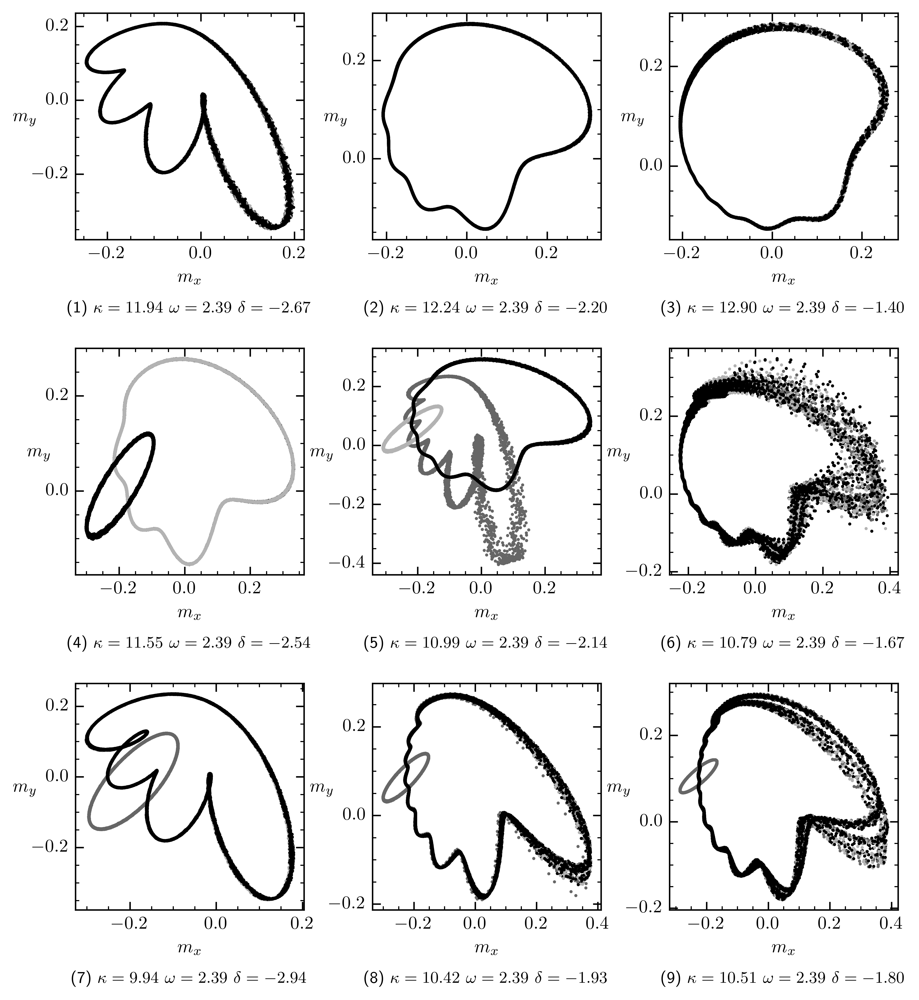

In [34]:
tickp = TickProperties(xtick_step_major=0.2,\
                        xtick_step_minor=0.05,\
                            ytick_step_major=0.2,\
                                ytick_step_minor=0.05)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)

setup.fig_width= 20.6*cm
setup.fig_height=22.6*cm 
fig, ax = setup.return_fig(shape=(3,3),dots_per_inch=600)
# fig, ax = plt.subplots(3,3)
# sample_traj = np.load('4.4k13_1.5w5.5_3d/plottraj_wcut.npz')
c=['0','0.4','0.4','0.7','0']
for i in range(3):
    for j in range(3):
        # print(len(sample_traj[i][j]))
        for l in range(len(sample_traj[i][j])):
            # traj = sample_traj[-1-i][j][l]
            traj = sample_traj2[i,j,l]
            steps= len(traj[:,0])
            ax[i,j].scatter(traj[:,1],traj[:,2],color=c[l])
            ax[i,j].set_xlabel(r'$m_x$')
            ax[i,j].set_ylabel(r'$m_y$',rotation=0)
            ax[i,j].set_title('({:d})  $\\kappa={:.2f}$ $\\omega={:.2f}$ $\\delta={:.2f}$'.format(3*i+j+1,*psample[i,j]),loc='center',y=-0.37,fontsize=9)
            # if i==2 and j==1:
                
            #     ax[i,j].yaxis.set_major_locator(ticker.MultipleLocator(0.05))
            #     ax[i,j].yaxis.set_minor_locator(ticker.MultipleLocator(0.01))
            #     ax[i,j].xaxis.set_major_locator(ticker.MultipleLocator(0.05))
            #     ax[i,j].xaxis.set_minor_locator(ticker.MultipleLocator(0.01))

            # if i==0 and j==2:
                
            #     ax[i,j].yaxis.set_major_locator(ticker.MultipleLocator(0.02))
            #     ax[i,j].yaxis.set_minor_locator(ticker.MultipleLocator(0.005))
            #     ax[i,j].xaxis.set_major_locator(ticker.MultipleLocator(0.05))
            #     ax[i,j].xaxis.set_minor_locator(ticker.MultipleLocator(0.01))
                
plt.subplots_adjust(wspace=0.3,hspace=0.48)
plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'lc_traj_wcut2.png',bbox_inches='tight')
plt.show()

In [201]:
np.savez_compressed('4.4k13_1.5w5.5_3d/plottraj_dcut',sample_traj)

In [206]:
a =np.load('4.4k13_1.5w5.5_3d/plottraj_dcut.npz',allow_pickle=True)


(3, 23805)

In [35]:
# trajs = [[],[],[]]
# for i in range(3):
#     for j in range(3):
#         # print([sample_traj[i][j][l] for l in range(3)])
#         trajs[i].append(np.stack([np.row_stack((l.t,l.y)) for l in sample_traj[-1-i][j]]))
# trajs = np.stack([np.stack(trajs[i]) for i in range(3)])
# trajs = np.swapaxes(trajs,3,4)
np.savez_compressed('4.4k13_1.5w5.5_3d/plottraj_wcut2',sample_traj2)

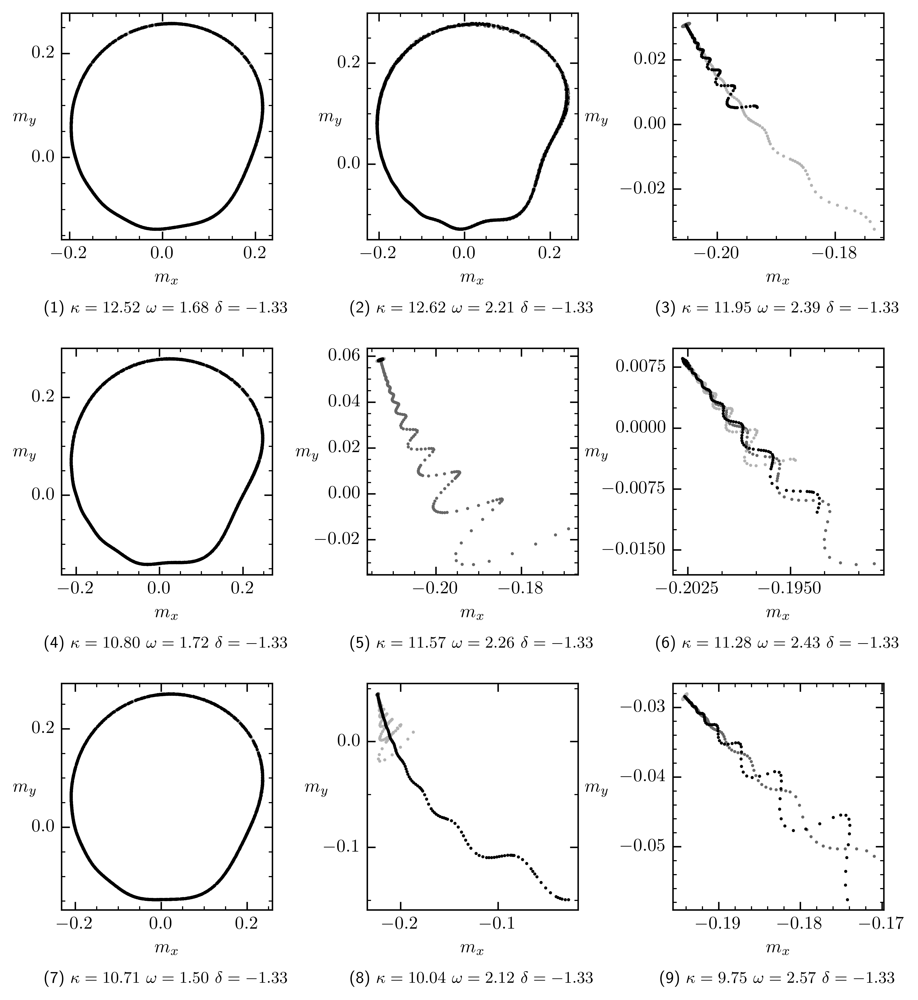

In [194]:
tickp = TickProperties(xtick_step_major=0.2,\
                        xtick_step_minor=0.05,\
                            ytick_step_major=0.2,\
                                ytick_step_minor=0.05)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)

setup.fig_width= 20.6*cm
setup.fig_height=22.6*cm 
fig, ax = setup.return_fig(shape=(3,3),dots_per_inch=600)
# fig, ax = plt.subplots(3,3)

c=['0.4','0.7','0','0.7','0']
for i in range(3):
    for j in range(3):
        # print(len(sample_traj[i][j]))
        # for l in range(len(sample_traj[i][j])):
        for l in range(3):
            
            # ax[i,j].ticklabel_format(style='sci',scilimits=(-2,2),useMathText=True,useOffset=True)
            if i==1 and j==1:
                traj = sample_traj[i][j][l]
                steps= len(traj.t)
                ax[i,j].scatter(traj.y[0][steps//4:],traj.y[1][steps//4:],color=c[l])
                ax[i,j].set_xlabel(r'$m_x$')
                ax[i,j].set_ylabel(r'$m_y$',rotation=0)
                ax[i,j].set_title('({:d})  $\\kappa={:.2f}$ $\\omega={:.2f}$ $\\delta={:.2f}$'.format(3*i+j+1,*psample[i,j]),loc='center',y=-0.37,fontsize=9)
                ax[i,j].yaxis.set_major_locator(ticker.MultipleLocator(0.02))
                ax[i,j].yaxis.set_minor_locator(ticker.MultipleLocator(0.005))
                ax[i,j].xaxis.set_major_locator(ticker.MultipleLocator(0.02))
                ax[i,j].xaxis.set_minor_locator(ticker.MultipleLocator(0.005))
            elif i==2 and j==1:
                traj = sample_traj[i][j][l]
                steps= len(traj.t)
                ax[i,j].scatter(traj.y[0][steps//4:],traj.y[1][steps//4:],color=c[l])
                ax[i,j].set_xlabel(r'$m_x$')
                ax[i,j].set_ylabel(r'$m_y$',rotation=0)
                ax[i,j].set_title('({:d})  $\\kappa={:.2f}$ $\\omega={:.2f}$ $\\delta={:.2f}$'.format(3*i+j+1,*psample[i,j]),loc='center',y=-0.37,fontsize=9)
                ax[i,j].yaxis.set_major_locator(ticker.MultipleLocator(0.1))
                ax[i,j].yaxis.set_minor_locator(ticker.MultipleLocator(0.05))
                ax[i,j].xaxis.set_major_locator(ticker.MultipleLocator(0.1))
                ax[i,j].xaxis.set_minor_locator(ticker.MultipleLocator(0.5))

            elif j==2 and i<1:
                traj = sample_traj[i][j][l]
                steps= len(traj.t)
                ax[i,j].scatter(traj.y[0][steps//2:],traj.y[1][steps//2:],color=c[l])
                ax[i,j].set_xlabel(r'$m_x$')
                ax[i,j].set_ylabel(r'$m_y$',rotation=0,labelpad=13)
                ax[i,j].set_title('({:d})  $\\kappa={:.2f}$ $\\omega={:.2f}$ $\\delta={:.2f}$'.format(3*i+j+1,*psample[i,j]),loc='center',y=-0.37,fontsize=9)
                ax[i,j].yaxis.set_major_locator(ticker.MultipleLocator(0.02))
                ax[i,j].yaxis.set_minor_locator(ticker.MultipleLocator(0.005))
                ax[i,j].xaxis.set_major_locator(ticker.MultipleLocator(0.02))
                ax[i,j].xaxis.set_minor_locator(ticker.MultipleLocator(0.005))
            elif j==2 and i==1:
                traj = sample_traj[i][j][l]
                steps= len(traj.t)
                ax[i,j].scatter(traj.y[0][steps//2:],traj.y[1][steps//2:],color=c[l])
                ax[i,j].set_xlabel(r'$m_x$')
                ax[i,j].set_ylabel(r'$m_y$',rotation=0,labelpad=3)
                ax[i,j].set_title('({:d})  $\\kappa={:.2f}$ $\\omega={:.2f}$ $\\delta={:.2f}$'.format(3*i+j+1,*psample[i,j]),loc='center',y=-0.37,fontsize=9)
                ax[i,j].yaxis.set_major_locator(ticker.MultipleLocator(0.0075))
                ax[i,j].yaxis.set_minor_locator(ticker.MultipleLocator(0.0025))
                ax[i,j].xaxis.set_major_locator(ticker.MultipleLocator(0.0075))
                ax[i,j].xaxis.set_minor_locator(ticker.MultipleLocator(0.0025))
            elif j==2 and i==2:
                traj = sample_traj[i][j][l]
                steps= len(traj.t)
                ax[i,j].scatter(traj.y[0][steps//2:],traj.y[1][steps//2:],color=c[l])
                ax[i,j].set_xlabel(r'$m_x$')
                ax[i,j].set_ylabel(r'$m_y$',rotation=0,labelpad=13)
                ax[i,j].set_title('({:d})  $\\kappa={:.2f}$ $\\omega={:.2f}$ $\\delta={:.2f}$'.format(3*i+j+1,*psample[i,j]),loc='center',y=-0.37,fontsize=9)
                ax[i,j].yaxis.set_major_locator(ticker.MultipleLocator(0.01))
                ax[i,j].yaxis.set_minor_locator(ticker.MultipleLocator(0.002))
                ax[i,j].xaxis.set_major_locator(ticker.MultipleLocator(0.01))
                ax[i,j].xaxis.set_minor_locator(ticker.MultipleLocator(0.002))
            else:
                traj = sample_traj[i][j][l]
                steps= len(traj.t)
                ax[i,j].scatter(traj.y[0][-steps//20:],traj.y[1][-steps//20:],color=c[l])
                ax[i,j].set_xlabel(r'$m_x$')
                ax[i,j].set_ylabel(r'$m_y$',rotation=0)
                ax[i,j].set_title('({:d})  $\\kappa={:.2f}$ $\\omega={:.2f}$ $\\delta={:.2f}$'.format(3*i+j+1,*psample[i,j]),loc='center',y=-0.37,fontsize=9)
                
plt.subplots_adjust(wspace=0.45,hspace=0.48)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'lc_traj_dcut.png',bbox_inches='tight')
plt.show()

In [133]:
ik, iw, id = find_index(10.993, 2.388, -2.14)
k[ik], w[iw], d[id]

(10.993333333333332, 2.388888888888889, -2.1333333333333333)

11.662222222222223 2.388888888888889 -2.466666666666667
[ 0.11868589  0.12713551 -0.1242956 ]
4268401
11.662222222222223 2.388888888888889 -2.466666666666667
[-2.35677179e-03  9.91750100e-05  2.30203682e-02]
4272309


<function matplotlib.pyplot.show(close=None, block=None)>

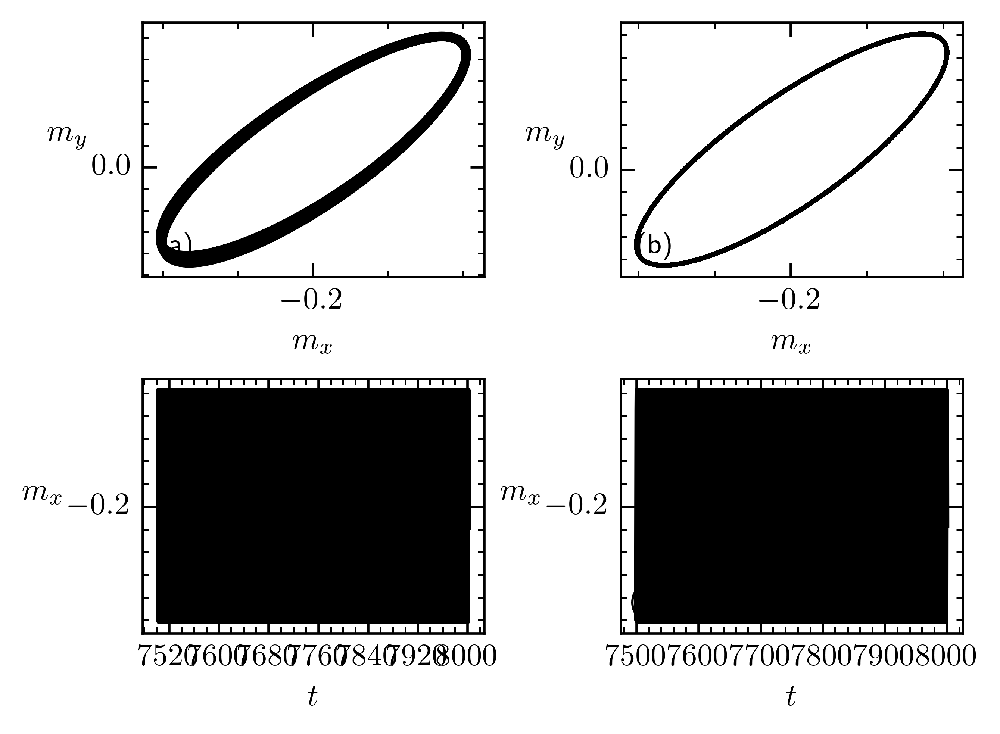

In [143]:
tickp = TickProperties(xtick_step_major=0.1,\
                        xtick_step_minor=0.02,\
                            ytick_step_major=0.1,\
                                ytick_step_minor=0.02)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)

fig, ax = setup.return_fig(shape=(2,2),dots_per_inch=600)
# fig, ax = plt.subplots(2,2)
subtitle = [[r'(a)',r'(b)'],[r'(c)',r'(d)']]
for reps in range(2):

    
    kval, wval, dval = k[-15], w[20], d[id]
    print(kval,wval,dval)
    # arguments = wval,kval, dval, Gam, sgam 
    # traj = solve_ivp(gl2,(0,300),np.array([0,0,0]),args=arguments,rtol=1e-13,atol=1e-25)
    
    for i in range(3):
        arguments = wval,kval, dval, Gam, sgam 
        traj = trajs[reps][i]
        p = spoints[reps][i]
        print(p)
        steps = len(traj.t)
        print(steps)
        
        # ax[0,reps].scatter(p[0],p[1],s=10,color=colors[i])
        if reps==0:
            ax[0,reps].plot(traj.y[0][steps//4:steps//3],traj.y[1][steps//4:steps//3],color=colors[i])
            # ax[0,reps].scatter(p[0],p[1],s=10,color=colors[i])
            ax[0,reps].yaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[0,reps].yaxis.set_minor_locator(ticker.MultipleLocator(0.02))
            ax[0,reps].xaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[0,reps].xaxis.set_minor_locator(ticker.MultipleLocator(0.05))
        else:
            ax[0,reps].plot(traj.y[0][3*steps//4:],traj.y[1][3*steps//4:],color=colors[i])
            # ax[0,reps].scatter(p[0],p[1],s=10,color=colors[i])
            ax[0,reps].yaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[0,reps].yaxis.set_minor_locator(ticker.MultipleLocator(0.02))
            ax[0,reps].xaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[0,reps].xaxis.set_minor_locator(ticker.MultipleLocator(0.05))
        if reps:
            ax[1,reps].plot(traj.t[steps//40*30:steps//40*32],traj.y[0][steps//40*30:steps//40*32],color=colors[i])
            # ax[1,reps].hlines(np.mean(traj.y[0][-steps//10:]),traj.t[-steps//10],traj.t[-1])
            ax[1,reps].yaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[1,reps].yaxis.set_minor_locator(ticker.MultipleLocator(0.02))
            ax[1,reps].xaxis.set_major_locator(ticker.MultipleLocator(100))
            ax[1,reps].xaxis.set_minor_locator(ticker.MultipleLocator(20))
        else:
            ax[1,reps].plot(traj.t[steps//40*30:steps//40*32],traj.y[0][steps//40*30:steps//40*32],color=colors[i])
            ax[1,reps].yaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[1,reps].yaxis.set_minor_locator(ticker.MultipleLocator(0.02))
            ax[1,reps].xaxis.set_major_locator(ticker.MultipleLocator(80))
            ax[1,reps].xaxis.set_minor_locator(ticker.MultipleLocator(20))
        break

    # ax[1,1].set_xlim(291.5,300)
    # ax[0,1].set_xlim(-0.25,0.405)
    ax[0,reps].set_xlabel(r'$m_x$')
    ax[0,reps].set_ylabel(r'$m_y$',rotation=0,labelpad=8)
    ax[0,reps].set_title(subtitle[0][reps],loc='left',x=0.05,y=0.02,fontsize=9)
    ax[1,reps].set_xlabel(r'$t$')
    ax[1,reps].set_ylabel(r'$m_x$',rotation=0,labelpad=8)
    if reps:
        ax[1,reps].set_title(subtitle[1][reps],loc='left',x=0.03,y=0.02,fontsize=9)
    else:
        ax[1,reps].set_title(subtitle[1][reps],loc='left',x=0.05,y=0.02,fontsize=9)
plt.subplots_adjust(hspace=0.4,wspace=0.4)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'traj_k{:.2f}_w{:.2f}_d{:.2f}.pdf'.format(kval,wval,dval),bbox_inches='tight')

plt.show

11.662222222222223 2.388888888888889 -2.466666666666667
[0.07118894 0.13639336 0.26658601]
11.662222222222223 2.388888888888889 -2.466666666666667
[-0.27593173 -0.2208139   0.15394378]


<function matplotlib.pyplot.show(close=None, block=None)>

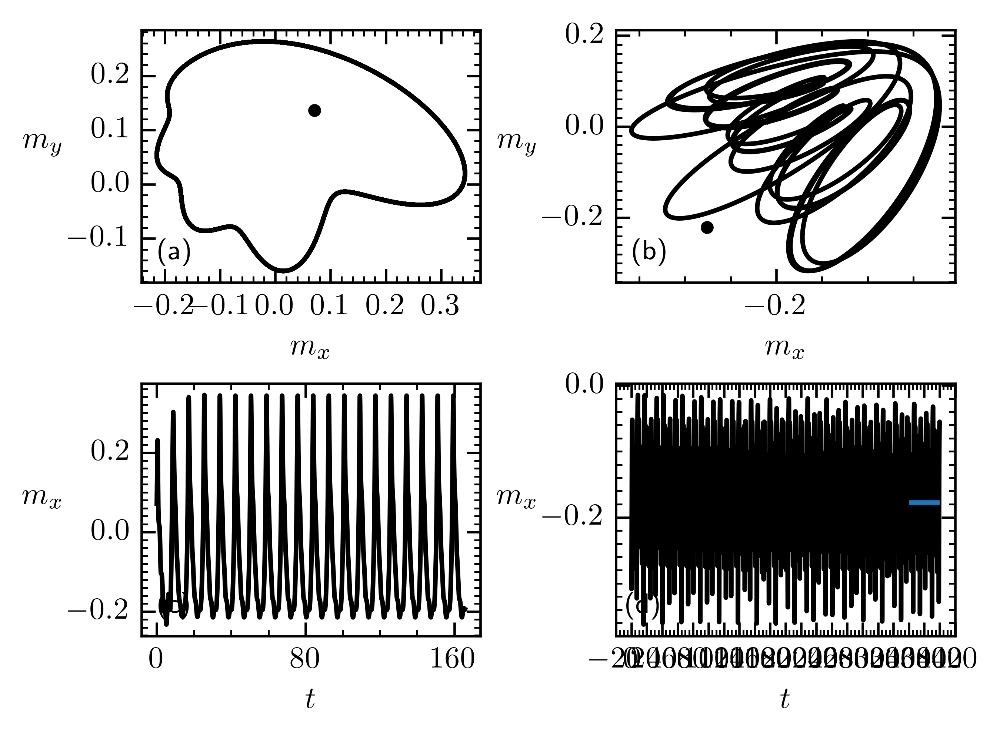

In [ ]:

tickp = TickProperties(xtick_step_major=0.1,\
                        xtick_step_minor=0.02,\
                            ytick_step_major=0.1,\
                                ytick_step_minor=0.02)
setup = Setup_Fig(name_of_plot='lam2_anal_ml.png',tickp=tickp)

fig, ax = setup.return_fig(shape=(2,2),dots_per_inch=600)
# fig, ax = plt.subplots(2,2)
subtitle = [[r'(a)',r'(b)'],[r'(c)',r'(d)']]
for reps in range(2):

    
    kval, wval, dval = k[-15], w[20], d[id]
    print(kval,wval,dval)
    # arguments = wval,kval, dval, Gam, sgam 
    # traj = solve_ivp(gl2,(0,300),np.array([0,0,0]),args=arguments,rtol=1e-13,atol=1e-25)
    
    for i in range(3):
        arguments = wval,kval, dval, Gam, sgam 
        traj = trajs[reps][i]
        p = spoints[reps][i]
        print(p)
        steps = len(traj.t)
        ax[0,reps].plot(traj.y[0][steps//4:steps//3],traj.y[1][steps//4:steps//3],color=colors[i])
        ax[0,reps].scatter(p[0],p[1],s=10,color=colors[i])
        # ax[0,reps].scatter(p[0],p[1],s=10,color=colors[i])
        if reps:
            ax[0,reps].yaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[0,reps].yaxis.set_minor_locator(ticker.MultipleLocator(0.02))
            ax[0,reps].xaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[0,reps].xaxis.set_minor_locator(ticker.MultipleLocator(0.05))
        

        if reps:
            ax[1,reps].plot(traj.t[-steps//steps+1:],traj.y[0][-steps//steps+1:],color=colors[i])
            ax[1,reps].hlines(np.mean(traj.y[0][-steps//10:]),traj.t[-steps//10],traj.t[-1])
            ax[1,reps].yaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[1,reps].yaxis.set_minor_locator(ticker.MultipleLocator(0.02))
            ax[1,reps].xaxis.set_major_locator(ticker.MultipleLocator(100))
            ax[1,reps].xaxis.set_minor_locator(ticker.MultipleLocator(20))
        else:
            ax[1,reps].plot(traj.t[:steps//5*2],traj.y[0][:steps//5*2],color=colors[i])
            ax[1,reps].yaxis.set_major_locator(ticker.MultipleLocator(0.2))
            ax[1,reps].yaxis.set_minor_locator(ticker.MultipleLocator(0.02))
            ax[1,reps].xaxis.set_major_locator(ticker.MultipleLocator(80))
            ax[1,reps].xaxis.set_minor_locator(ticker.MultipleLocator(20))
        break

    # ax[1,1].set_xlim(291.5,300)
    # ax[0,1].set_xlim(-0.25,0.405)
    ax[0,reps].set_xlabel(r'$m_x$')
    ax[0,reps].set_ylabel(r'$m_y$',rotation=0,labelpad=8)
    ax[0,reps].set_title(subtitle[0][reps],loc='left',x=0.05,y=0.02,fontsize=9)
    ax[1,reps].set_xlabel(r'$t$')
    ax[1,reps].set_ylabel(r'$m_x$',rotation=0,labelpad=8)
    if reps:
        ax[1,reps].set_title(subtitle[1][reps],loc='left',x=0.03,y=0.02,fontsize=9)
    else:
        ax[1,reps].set_title(subtitle[1][reps],loc='left',x=0.05,y=0.02,fontsize=9)
plt.subplots_adjust(hspace=0.4,wspace=0.4)
# plt.savefig('/home/christian/Documents/Bachelor/protocol/pictures/'+'traj_k{:.2f}_w{:.2f}_d{:.2f}.pdf'.format(kval,wval,dval),bbox_inches='tight')

plt.show

In [ ]:
# chaos point
11.662222222222223 2.388888888888889 -2.466666666666667
[-0.27593173 -0.2208139   0.15394378]

8.03111111111111 2.033333333333333 -2.466666666666667


expected fixed point
[[-5.55111512e-17]
 [ 3.46944695e-18]
 [ 5.55111512e-17]]
[-0.26929542 -0.03836757  0.11544613]


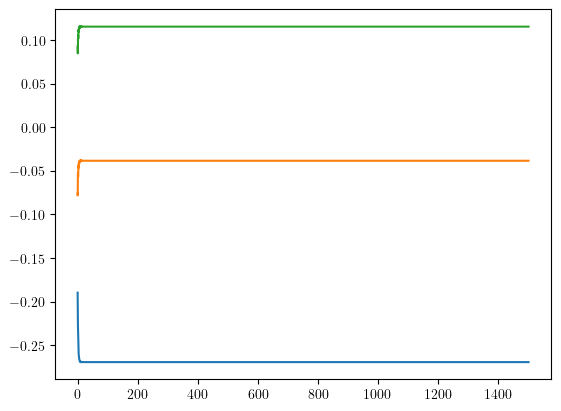

expected limit cycle


/tmp/ipykernel_270091/3484302180.py:67: RuntimeWarning: invalid value encountered in sqrt
  return 1/(Gamma*delta+2*k*w*x)*(w**2*x+np.sqrt(w**4*x**2-(2*k*w*x+Gamma*delta)*(2*k*w*x**3-w*Gamma*x+Gamma*delta*x**2)))


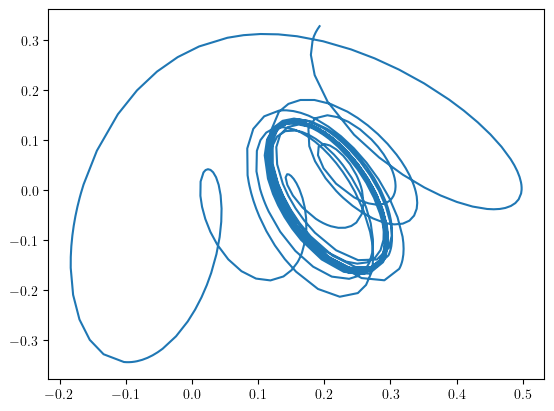

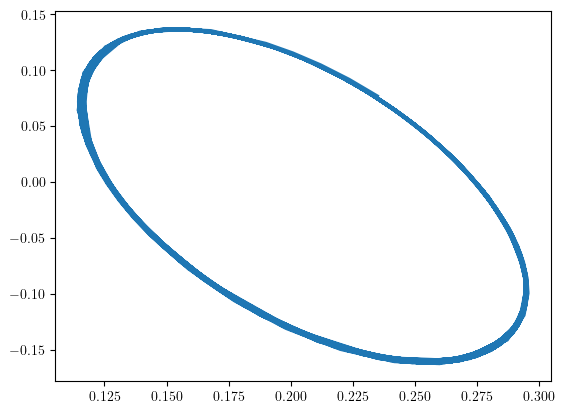

expected limit cycle


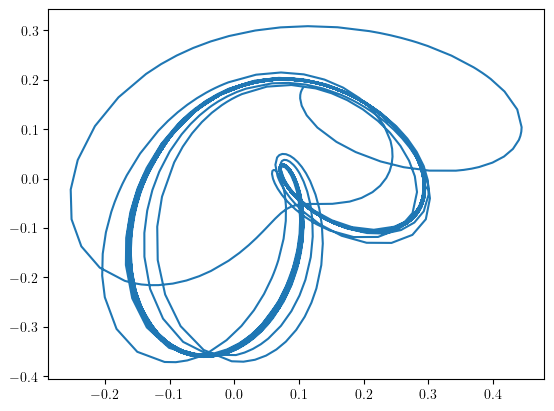

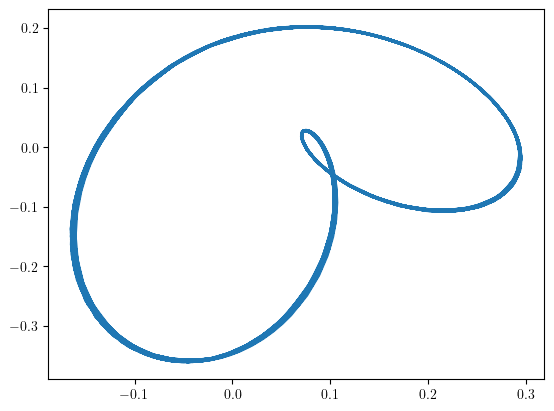

expected fixed point
[[-7.70217223e-16]
 [ 2.77555756e-17]
 [ 5.55111512e-17]]
[-0.09813686 -0.07747417  0.01952192]


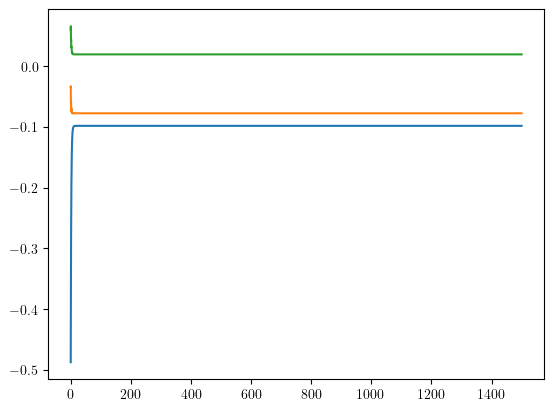

expected limit cycle


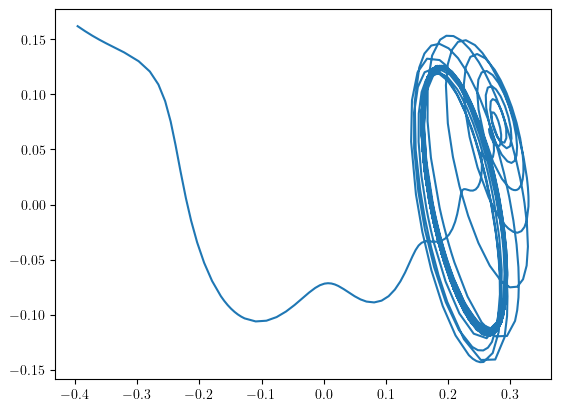

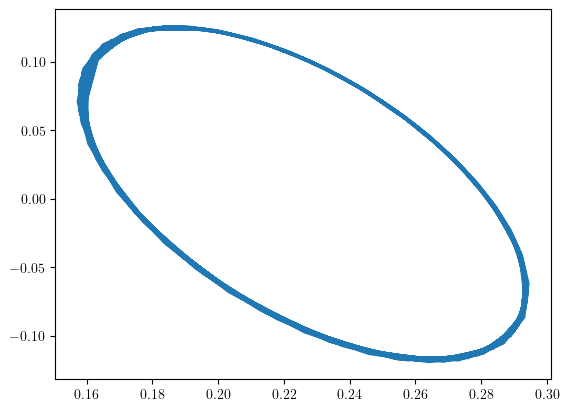

expected fixed point
[[ 0.00000000e+00]
 [ 1.09287579e-16]
 [-9.71445147e-17]]
[-0.31154152  0.01657278  0.18596615]


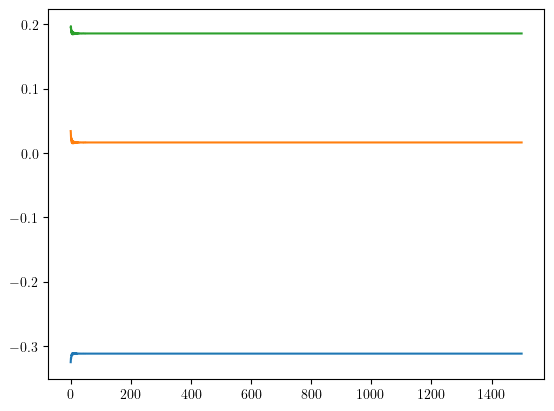

expected fixed point
[[ 2.77555756e-17]
 [-1.73472348e-17]
 [ 4.16333634e-17]]
[ 0.2637852  -0.02710001  0.10748763]


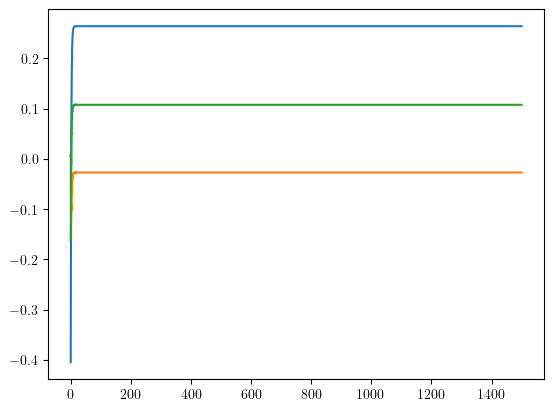

expected fixed point
[[-4.16333634e-16]
 [ 1.24900090e-16]
 [ 1.11022302e-16]]
[-0.09807891 -0.13259511  0.03510598]


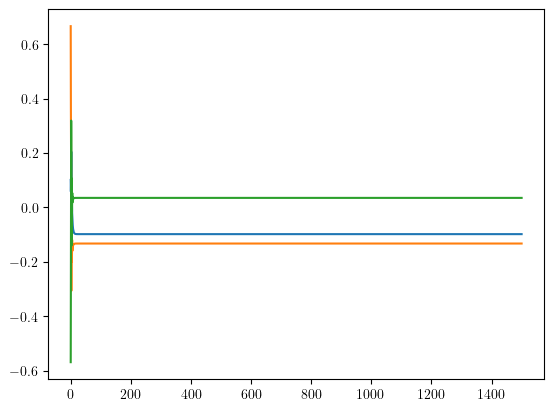

expected fixed point
[[ 1.38777878e-17]
 [ 0.00000000e+00]
 [-5.55111512e-17]]
[ 0.08731277 -0.08283953  0.0180335 ]


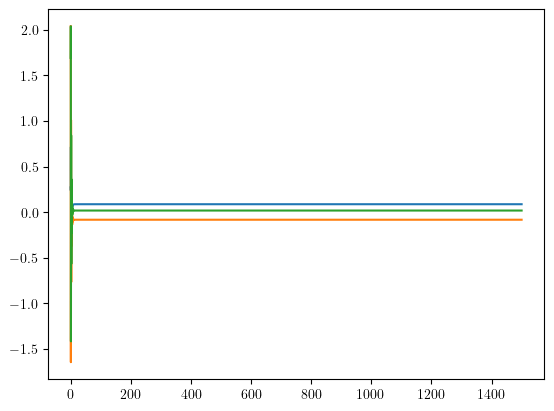

expected fixed point
[[8.11523071e-12]
 [8.54701726e-12]
 [4.17528512e-12]]
[ 0.23386009 -0.0684575   0.08606764]


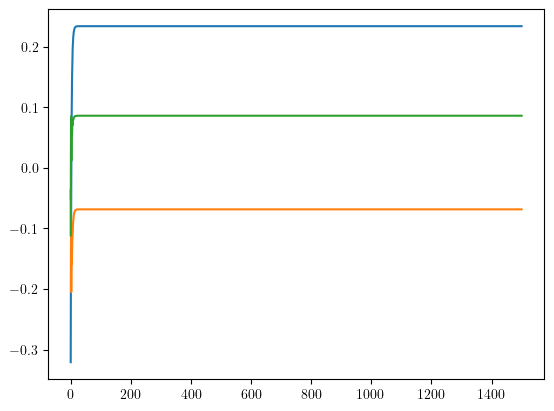

In [146]:
from random import random
for reps in range(10):
    ik, iw, id = (np.array([random(),random(),random()])*gridpoints).astype(np.int64)
    kval, wval, dval = k[ik], w[iw], d[id]
    xgrid = set_xgird(wval,kval,dval,Gam,sgam)
    x = xgrid[int(random()*xgrid.shape[0])]
    y = y1ofx(x,wval,kval,dval,Gam,sgam)
    z = m_z(x,y,wval,kval,Gam)
    mstart = np.array([x,y,z])
    # print(mstart)
    # print(kval,wval,dval)
    # print(gl_np(0,mstart,wval,kval,dval,Gam,sgam))
    
    arguments = wval,kval, dval, Gam, sgam
    traj = solve_ivp(gl_np,(0,1500),mstart,'LSODA',args=arguments)
    mend = np.array([traj.y[0][-1],traj.y[1][-1],traj.y[2][-1]])
    # print(gl_np(0,mend,wval,kval,dval,Gam,sgam))
    # print(mend)
    if stability_plus[ik,iw,id]==0:
        print('expected limit cycle')
        plt.figure()
        plt.plot(traj.y[0],traj.y[1])
        plt.show()
        plt.figure()
        plt.plot(traj.y[0][600:],traj.y[1][600:])
        plt.show()
    elif stability_plus[ik,iw,id]==1:
        print('expected fixed point')
        mend = np.array([traj.y[0][-1],traj.y[1][-1],traj.y[2][-1]])
        print(gl_np(0,mend,wval,kval,dval,Gam,sgam))
        print(mend)
        plt.figure()
        plt.plot(traj.t,traj.y[0])
        plt.plot(traj.t,traj.y[1])
        plt.plot(traj.t,traj.y[2])
        plt.show()
    else:
        print('error')
        